### Dmr folders explained

dmr (/well/ludwig/users/dyp502/tissue_atlas_v3/dmr) - previous dmrs up to test6
dmr2 - first dmrs for test7
dmr10 - finalised method
dmr11, dmr 12 - change delta_means to be 0.001 for hmC and 0.01 for mC
dmr13 - change back to delta_means=0.01 for all, including cirrhosis + pancreatitis, also include mC DMBs on hmC blocks and vice versa
dmr14 - delta_means=0.01, don't include cirrhosis + pancreatitis

In [1]:
"""
Explainer:

This code loads in tissue samples intersected on filtered blocks (made after calling bedtools intersect on bedfile of filtered blocks here: /well/ludwig/users/dyp502/code/tissue_atlas_code_2023/segment/filter_blocks_pipeline.py)
We load in these intersections then make atlases by aggregating across regions. We then filter by top_n% variance blocks, and call top_n DMBs.

"""


import pandas as pd
import numpy as np
import os
import collections
import time
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns
import sys
from scipy import optimize
import pickle
# import plotly.express as px
from random import randrange
from tqdm import tqdm
from typing import List
import itertools
from scipy.stats import ttest_ind, ttest_1samp
import warnings
from matplotlib.colors import LogNorm

warnings.filterwarnings('ignore')

# from dmr_functions import grail_find_markers_copy, get_grail_dmrs, plot_hypo_hyper_dmr_heatmap, get_tissue_labels_positions




def grail_find_markers_copy(tf,args,hypo=True,sort_by_delta_quant=True,t_test=False):
    """
    Adapting the Grail find_markers code to our data, and taking out of the Class it's defined within. 
    Input: MR df, and args: a dictionary containing all the threshold and parameters for DMR finding.
    These thresholds are then used to call DMRs.
    We set tg_quant and bg_quant only once. However we need to use these parameters differently depending
    on whether we're finding hyper or hypo DMRs. The intuition for why we need to rotate these is so we're 
    always finding the delta between max(hypomethylated_group) and min(hypermethylated group).
    
    Example: tg_quant = 0.25, bg_quant = 0.975
    
    If we're finding Hypo DMRs, target group is at bottom, so will calculate delta between:
    A. (1-tg_quant) percentile of target group, ie the 75th percentile of the lowly methylated group (near the top)
    B. bg_quant percentile of background, so 2.5th percentile of highly methylated group (near the bottom)
    
    If we're finding Hyper DMRs, target group near top, so instead calculate delta between:
    A. tg_quant percentile of target group, ie 25th percentile of highly methylated group (near bottom)
    B. (1 - bg_quant) percentile of background, so 97.5th percentile of lowly methylated group (near top)
    
    
    
    Finds Hypo DMRs by default, so assumes tg_quant is the quantile for the unmethylated group 
    
    
    Notes from using this function:
    
    - np.nanquantile interpolates! ie it doesn't select the highest value in a list of 3 if target_quantile = 0.75, 
    it instead interpolates a new value.
    
    - I _think_ the way they use this function is to calculate delta_quants between tg and bg for each tissue, then
    just pick the top n DMRs with largest delta_quant value. I've explicitly specified the polarity for calculating 
    delta_quants, so that the subtraction is different for hypo vs hyper.
    
    - Need to drop NaNs from the input df before passing to this function
   
    """
    
    
    
    tg_names = args['tg_names']
    bg_names = args['bg_names']
    tg_quant = args['tg_quant']
    bg_quant = args['bg_quant']
    unmeth_mean_thresh = args['unmeth_mean_thresh'] # used to filter out regions where tg_mean is greater than this value
    meth_mean_thresh = args['meth_mean_thresh'] # used to filter out regions where bg_mean is less than this value
    delta_means = args['delta_means'] # pick regions with mean_delta > this threshold
    unmeth_quant_thresh = args['unmeth_quant_thresh'] # Target Group quantile (tg) needs to be lower than this
    meth_quant_thresh = args['meth_quant_thresh'] # Background Group quantile (tg) needs to be lower than this
    delta_quants = args['delta_quants'] # threshold delta between values of the two groups quantile, eg if delta_quants = 0.5, then delta between 75th percentile of tg and 2.5th percentile of background needs to be greater than this value

    print(f"tg_names: {tg_names}")
    print(f"bg_names: {bg_names}")
    if hypo:

        target_quantile = 1-tg_quant
        background_quantile = bg_quant
        print(f"Hypo, so target_quantile={target_quantile} and background_quantile={background_quantile}")

    else: # hyper DMRs, so target has high methylation and background has low
        print(f"Hyper, so:")

        target_quantile = tg_quant
        background_quantile = 1-bg_quant
        print(f"Hyper, so target_quantile={target_quantile} and background_quantile={background_quantile}")
        
#     print(f"target_quantile: {target_quantile}")
#     print(f"background_quantile: {background_quantile}")


    tfX = tf.copy()

    # Compute maxmin
    tfX['delta_maxmin'] = np.abs(tfX[args['bg_names']].min(axis=1) - tfX[args['tg_names']].max(axis=1))

    # Compute means for target and background

    with warnings.catch_warnings():
        warnings.simplefilter("ignore", category=RuntimeWarning)
        tfX['tg_mean'] = np.nanmean(tfX[args['tg_names']], axis=1)
        tfX['bg_mean'] = np.nanmean(tfX[args['bg_names']], axis=1)
    #     tfX['delta_means'] = tfX['bg_mean'] - tfX['tg_mean']

    # Change this code to make delta_means always positive for rows containing the target group's DMRs
    if hypo:
        tfX['delta_means'] = tfX['bg_mean'] - tfX['tg_mean']
    else:
        tfX['delta_means'] = tfX['tg_mean'] - tfX['bg_mean']




    print(f"Shape of df before any filtering: {len(tfX)}")
    print(tfX)
    # filter by mean thresholds  - selects rows where tg_mean < threshold and bg_mean > threshold for hypomethylated DMRs
    # set these to 0 and 1 if we don't want to filter out any rows based on tg and ug means
    keep_umt = (tfX['tg_mean'] <= args['unmeth_mean_thresh']) # filters out any regions with tg_mean < unmeth_mean_thresh
    keep_mmt = (tfX['bg_mean'] >= args['meth_mean_thresh']) # filters out any regions with bg_mean < meth_mean_thresh

    ## CHANGE: this has been changed to check absolute value, so works for hyper and hypo DMRs
    keep_delta_mean = (tfX['delta_means'] >= args['delta_means']) # optionally also include regions with > delta mean
    tfX = tfX.loc[keep_umt & keep_mmt & keep_delta_mean, :]#.reset_index(drop=True)
    print(f"Shape of df after delta_means filtering: {len(tfX)}")

    # if tfX.empty:
    #     return tfX

    # Compute quantiles for target and background - this just computes the values of the quantiles we've set - doesn't do any filtering

    tfX['tg_quant'] = np.nanquantile(tfX[args['tg_names']], target_quantile, axis=1) # compute quantile, ignoring NaNs
    tfX['bg_quant'] = np.nanquantile(tfX[args['bg_names']], background_quantile, axis=1)

    if hypo: # we want to keep the directionality of this, to avoid accidentally finding DMRs for other tissues, eg Eosinophil
        tfX['delta_quants'] = tfX['bg_quant'] - tfX['tg_quant']
    else:
        tfX['delta_quants'] = tfX['tg_quant'] - tfX['bg_quant'] 


    # filter by quantile thresholds we've set above. 
    #     if args['repro']:
    #         keep_uqt = (tfX['tg_quant'] < args['unmeth_quant_thresh'])
    #     else:
    if hypo: # hypo DMR, so target group quantile needs to be lower than unmeth_quant_thresh
        keep_uqt = (tfX['tg_quant'] <= unmeth_quant_thresh)
        keep_mqt = (tfX['bg_quant'] >= meth_quant_thresh) 
    else: # hyper DMR, so target group quantile needs to be higher than meth_quant_thresh
        keep_uqt = (tfX['bg_quant'] <= unmeth_quant_thresh)
        keep_mqt = (tfX['tg_quant'] >= meth_quant_thresh) 
    # meth_quant_thresh is threshold MR value for low quantile of methylated group. 
    # So if tg_quant is 0.75, and meth_quant_thresh is 0.8, then we filter out rows where the 75th percentile of the target group is not  want the 
    #     keep_mqt = (tfX['bg_quant'] >= args['meth_quant_thresh']) 

    keep_delta_quants = (tfX['delta_quants'] >= args['delta_quants'])
    tfX = tfX.loc[keep_uqt & keep_mqt & keep_delta_quants, :]#.reset_index(drop=True)
    print(f"Shape of df after delta quants filtering: {len(tfX)}")

    if sort_by_delta_quant:
        tfX = tfX.sort_values(by='delta_quants',ascending=False)#.head(top_n)



    print(len(tfX))
    ## Add values for t-test, but don't filter by significance
    pval=0.05
    bonferroni_alpha = pval / len(tfX)


    if len(tg_names) == 1:
        # Use the single value in tg_names as the population mean
        print(f"Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single value in tg_group. \nNull hypothesis is expected value (mean) of samples is equal to existing population mean")
        popmean = tfX[tg_names].values.flatten()[0]
        r = ttest_1samp(tfX[bg_names], popmean, axis=1, nan_policy='omit')
    elif len(bg_names) == 1:
        # Use the single value in bg_names as the population mean
        print(f"Only one tissue sample in bg_group, so using one-sample independent t-test (two-sided) - comparing mean of tg_group to a single value in bg_group")
        popmean = tfX[bg_names].values.flatten()[0]
        r = ttest_1samp(tfX[tg_names], popmean, axis=1, nan_policy='omit')
    else:
        print(f"Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. \n Size of tg_group={len(tg_names)} and size of bg_group={len(bg_names)}")
        r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')

    tfX['ttest'] = r.pvalue
    tfX['significant_dmrs'] = tfX['ttest'] <= bonferroni_alpha

    
    
    if len(tg_names) == 1:
        # Use the single value in tg_names as the population mean
        popmean = tfX[tg_names].values.flatten()[0]
        r = ttest_1samp(tfX[bg_names], popmean, axis=1, nan_policy='omit')
    elif len(bg_names) == 1:
        # Use the single value in bg_names as the population mean
        popmean = tfX[bg_names].values.flatten()[0]
        r = ttest_1samp(tfX[tg_names], popmean, axis=1, nan_policy='omit')
    else:
        r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')

    tfX['ttest'] = r.pvalue
    tfX['significant_dmrs'] = tfX['ttest'] <= bonferroni_alpha



    if t_test:
        pval=0.05
        bonferroni_alpha = pval / len(tfX)
        tfX = dmr_ttest(tfX, tg_names, bg_names, bonferroni_alpha)
        
    return tfX




def get_grail_dmrs(df,
                  top_n,
                  tissue_groups,
                  tissue_id_map,
                  hypo=True,
                  hyper=True,
                  args=None):

    if not args:
        args = {
            'tg_names':'',
            'bg_names':'',
            'na_rate_tg': 0.334,
            'na_rate_bg': 0.334,
            'only_hyper': False,
            'only_hypo': False,
        #     'delta_means': 0.3,
            'delta_means':0.01, # temporarily setting v easy
            'delta_quants': -10,
            'tg_quant': 0.25,
            'bg_quant': 0.025,
            'unmeth_quant_thresh': 1.0,
            'meth_quant_thresh': 0.0,
            'unmeth_mean_thresh': 1.0,
            'meth_mean_thresh': 0.0,
            'pval': 0.05,
            'delta_maxmin': -1,
            'repro':False,
        }


    hypo_dmrs = pd.DataFrame([])
    hyper_dmrs = pd.DataFrame([])

    tissue_samples_in_this_df = list(df.columns)
    # df = tissue_samples_mr[tissue_samples_in_this_df].dropna()
    for tissue in tissue_groups:
    # for tissue in ['Liver']:
        tg_names = [u for u in tissue_id_map[tissue] if u in tissue_samples_in_this_df]
        bg_names = [u for u in tissue_samples_in_this_df if u not in tg_names]

        args['tg_names'] = tg_names
        args['bg_names'] = bg_names
        if hypo:
            tfX = grail_find_markers_copy(df,args,hypo=True)
            tfX['Hyper_or_Hypo'] = 'Hypo'
            tfX['selected_tissue'] = tissue
            hypo_dmrs = pd.concat([hypo_dmrs,tfX.head(top_n)])
        if hyper:
            tfX = grail_find_markers_copy(df,args,hypo=False)
            tfX['Hyper_or_Hypo'] = 'Hyper'
            tfX['selected_tissue'] = tissue
            hyper_dmrs = pd.concat([hyper_dmrs,tfX.head(top_n)])


    selected_regions = pd.concat([hypo_dmrs,hyper_dmrs])
    
    
    return selected_regions





def plot_dmr_with_highlight2(df, dmr_index, target_tissue, tissue_groups, args=None, hypo=True):
    fig, ax = plt.subplots(figsize=(22, 6))
    colors = itertools.cycle(plt.get_cmap('tab10').colors)
    col_pos = 0
    
    dmr_df = df.filter(regex='|'.join(tissue_groups))
    
    xticks_positions = []
    xticks_labels = []
    
    max_tg = -np.inf
    min_bg = np.inf

    for tissue in tissue_groups:
        tissue_columns = [col for col in df.columns if col.startswith(tissue)]
        meth_ratios_tissue = df.loc[dmr_index, tissue_columns]
        x_tissue = np.arange(col_pos, col_pos + len(tissue_columns))
        col_pos += len(tissue_columns)
        
        xticks_positions.append(np.mean(x_tissue))
        xticks_labels.append(tissue)
        
        if tissue == target_tissue:
            max_tg = max(max_tg, meth_ratios_tissue.max())
            ax.scatter(x_tissue, meth_ratios_tissue, color=next(colors), label=f"{tissue} (DMR)")
        else:
            min_bg = min(min_bg, meth_ratios_tissue.min())
            ax.scatter(x_tissue, meth_ratios_tissue, color=next(colors), label=f"{tissue}")
    
    delta_maxmin = max_tg - min_bg
    
    ax.set_xticks(xticks_positions)
    ax.set_xticklabels(xticks_labels)
    
    if args:
        tg_quant = args['tg_quant']
        bg_quant = args['bg_quant']
        target_quantile = 1 - tg_quant if hypo else tg_quant
        background_quantile = bg_quant if hypo else 1 - bg_quant

        tg_percentile = np.percentile(dmr_df.loc[dmr_index, dmr_df.columns.str.startswith(target_tissue)], target_quantile * 100)
        bg_percentile = np.percentile(dmr_df.loc[dmr_index, ~dmr_df.columns.str.startswith(target_tissue)], background_quantile * 100)
        
        ax.axhline(y=tg_percentile, linestyle='--', color='red', label=f"{target_quantile * 100:.1f}th percentile of target")
        ax.axhline(y=bg_percentile, linestyle='--', color='blue', label=f"{background_quantile * 100:.1f}th percentile of background")
        
        ax.axhline(y=df.loc[dmr_index, "tg_mean"], linestyle=':', color='grey', label=f"tg_mean")
        ax.axhline(y=df.loc[dmr_index, "bg_mean"], linestyle=':', color='grey', label=f"bg_mean")
        
        arrow_x_pos_quants = 0.35
        arrow_x_pos_means = 0.45
        arrow_x_pos_maxmin = 0.55

        ax.annotate('', xy=(arrow_x_pos_quants, bg_percentile), xytext=(arrow_x_pos_quants, tg_percentile), xycoords=('axes fraction', 'data'), textcoords=('axes fraction', 'data'),
                    arrowprops=dict(arrowstyle='<->', color='black', lw=1.5))
        ax.annotate(f'delta_quants = {df.loc[dmr_index, "delta_quants"]:.2f}', xy=(arrow_x_pos_quants, (tg_percentile + bg_percentile) / 2), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
        ax.annotate('', xy=(arrow_x_pos_means, df.loc[dmr_index, "bg_mean"]), xytext=(arrow_x_pos_means, df.loc[dmr_index, "tg_mean"]), xycoords=('axes fraction', 'data'), textcoords=('axes fraction', 'data'),
                    arrowprops=dict(arrowstyle='<->', color='purple', lw=1.5))
        ax.annotate(f'delta_means = {df.loc[dmr_index, "delta_means"]:.2f}', xy=(arrow_x_pos_means, (df.loc[dmr_index, "tg_mean"] + df.loc[dmr_index, "bg_mean"]) / 2), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
        ax.annotate('', xy=(arrow_x_pos_maxmin, min_bg), xytext=(arrow_x_pos_maxmin, max_tg), xycoords=('axes fraction', 'data'), textcoords=('axes fraction', 'data'),
                    arrowprops=dict(arrowstyle='<->', color='green', lw=1.5))
        ax.annotate(f'delta_maxmin = {delta_maxmin:.2f}', xy=(arrow_x_pos_maxmin, (max_tg + min_bg) / 2), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
#         ax.annotate(f"{target_quantile * 100:.1f}th percentile of target", xy=(0, tg_percentile), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
#         ax.annotate(f"{background_quantile * 100:.1f}th percentile of background", xy=(0, bg_percentile), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
    else:
        ax.set_xticks(range(len(dmr_df.columns)))
        ax.set_xticklabels(dmr_df.columns, rotation=90)
        ax.set_ylabel("Methylation Ratio")
        ax.set_title(f"DMR at {dmr_index}")

    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.tight_layout()
    plt.show()


    
    
    
def plot_region(cpg, df, toi, tissue_id_map, id_tissue_map, highlight_tissues=[]):
    """
    Plot the methylation ratios for a single CpG region across multiple tissue samples.
    
    Parameters:
        cpg (str): CpG region to plot
        df (DataFrame): DataFrame containing methylation ratios
        toi (str): Tissue of Interest
        tissue_id_map (dict): Dictionary mapping tissues to sample IDs
        id_tissue_map (dict): Dictionary mapping sample IDs to tissues
        highlight_tissues (list): List of tissues to highlight with 'X' marker
    """
    # Handle non-unique index by selecting the first entry
    selected_cpg = df.loc[cpg, :]
    if len(selected_cpg) > 1:
        selected_cpg = selected_cpg.iloc[0, :]
        
    # Generate unique colors for each tissue type
    unique_tissues = list(tissue_id_map.keys())
    cmap = plt.get_cmap('jet')
    colors = cmap(np.linspace(0, 1.0, len(unique_tissues)))
    tissue_colors = dict(zip(unique_tissues, colors))
    
    # Create the plot
    plt.figure(figsize=(20, 8))
    
    for sample_id, methylation_ratio in selected_cpg.iteritems():
        tissue = id_tissue_map.get(sample_id, 'Unknown')
        color = tissue_colors.get(tissue, 'grey')
        
        # Choose marker based on whether the tissue is in the highlight_tissues list
        marker = '*' if tissue in highlight_tissues else 'o'
        size = 150 if marker == '*' else 100
        linewidth = 1 if marker == '*' else None
        
        plt.scatter(sample_id, methylation_ratio, c=[color], marker=marker, s=size, linewidth=linewidth)
    
    # Add legends and labels
    handles = [plt.Line2D([0], [0], marker='o', color='w', label=tissue, markersize=10, markerfacecolor=color) for tissue, color in tissue_colors.items()]
    plt.legend(title='Tissues', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=90)
    plt.xlabel('Sample IDs')
    plt.ylabel('Methylation Ratio')
    plt.title(f'Methylation Ratios for CpG region {cpg}')
    plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 0.85, 1])
    plt.show()


    
# Function to generate shared_dmr_counts_df for heatmaps
def generate_shared_dmr_counts_df(df, link_character='_'):
    shared_dmrs = df.groupby("selected_tissue").apply(lambda x: x.index).to_dict()
    shared_dmr_counts = {}
    for tissue1, dmrs1 in shared_dmrs.items():
        for tissue2, dmrs2 in shared_dmrs.items():
            shared_key = f"{tissue1}{link_character}{tissue2}"
            shared_dmr_counts[shared_key] = len(set(dmrs1) & set(dmrs2))
    
    shared_dmr_counts_df = pd.Series(shared_dmr_counts).reset_index()
    shared_dmr_counts_df[['Tissue1', 'Tissue2']] = shared_dmr_counts_df['index'].str.split(link_character, expand=True)
    shared_dmr_counts_df = shared_dmr_counts_df.pivot('Tissue1', 'Tissue2', 0).fillna(0)
    shared_dmr_counts_df = shared_dmr_counts_df.reindex(index=[u for u in tissue_order if u in list(shared_dmr_counts_df.index)], columns=[u for u in tissue_order if u in shared_dmr_counts_df.columns])
    return shared_dmr_counts_df

sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/')
# from taps_tissue_atlas_functions import make_tissue_average_df, meth_atlas_dmrs, new_meth_atlas_dmrs, merge_filter_tissue_samples, merge_filter_caps_tissue_samples
# from taps_tissue_atlas_functions import grail_find_markers_copy, get_grail_dmrs





In [2]:
def plot_hypo_hyper_dmr_heatmap(df,
                                y_label_tissue_groups=True,
                                xticklabel_frequency=1,
                                cmap="YlGnBu",
                                remove_samples=[],
                               dividing_line_color="white"):

    # Get the order of tissues and corresponding samples
    tissue_order = list(df['selected_tissue'].unique())
    tissue_sample_order = []
    for tissue in tissue_order:
        tissue_sample_order.extend(tissue_id_map[tissue])

    # Filter out samples that are not in the dataframe or are in the remove_samples list
    tissue_sample_order = [u for u in tissue_sample_order if (u in df.columns) and (u not in remove_samples)]

    # Create the figure and axis objects
    fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(15, 20), sharex=False)

    # Filter the dataframe for Hyper and Hypo DMRs
    hyper_dmrs = df[df['Hyper_or_Hypo'] == 'Hyper']
    hypo_dmrs = df[df['Hyper_or_Hypo'] == 'Hypo']

    # Select only the desired columns for the heatmaps
    desired_cols = [u for u in tissue_sample_order if u in df.columns]
    hyper_dmrs_heatmap = hyper_dmrs.loc[:, desired_cols]
    hypo_dmrs_heatmap = hypo_dmrs.loc[:, desired_cols]

    # Find the breaks in the x-axis where the tissue changes
    breaks = []
    tissue_store = 0
    for k, col in enumerate(desired_cols):
        tissue = col.split('_')[-1]
        if tissue != tissue_store:
            breaks.append(k)
            tissue_store = tissue

    # If y-labels for tissue groups are desired
    if y_label_tissue_groups:
        y_hyper_dmrs = hyper_dmrs['selected_tissue'].reset_index(drop=True)
        y_hypo_dmrs = hypo_dmrs['selected_tissue'].reset_index(drop=True)
        hyper_labels_positions = get_tissue_labels_positions(y_hyper_dmrs)
        hypo_labels_positions = get_tissue_labels_positions(y_hypo_dmrs)

        # Plotting the heatmaps without yticklabels
        sns.heatmap(hyper_dmrs_heatmap, ax=ax1, cmap=cmap, yticklabels=False)
        ax1.set_title("Hyper DMRs")
        ax1.set_xlabel('')
        ax1.set_ylabel('')
        for label, position in hyper_labels_positions:
            ax1.text(0, position, label, ha='right', va='center')

        sns.heatmap(hypo_dmrs_heatmap, ax=ax2, cmap=cmap, yticklabels=False)
        ax2.set_title("Hypo DMRs")
        ax2.set_ylabel('')
        for label, position in hypo_labels_positions:
            ax2.text(0, position, label, ha='right', va='center')

    # If y-labels for tissue groups are not desired
    else:
        sns.heatmap(hyper_dmrs_heatmap, ax=ax1, cmap=cmap)
        sns.heatmap(hypo_dmrs_heatmap, ax=ax2, cmap=cmap)

    # Customize x-axis tick labels for both plots
    xticks = np.arange(0, len(tissue_sample_order), xticklabel_frequency)
    xticklabels = [tissue_sample_order[i] for i in xticks]
    ax1.set_xticks(xticks)
    ax1.set_xticklabels(xticklabels, rotation=90, ha='center')
    ax2.set_xticks(xticks)
    ax2.set_xticklabels(xticklabels, rotation=90, ha='center')

    # Manually set the x-axis limits to be the same for both subplots
    ax1.set_xlim(ax2.get_xlim())

    # Add vertical lines to indicate tissue boundaries
    ax1.vlines(breaks, *ax1.get_ylim(), color=dividing_line_color)
    ax2.vlines(breaks, *ax2.get_ylim(), color=dividing_line_color)

    plt.tight_layout()
    plt.show()

    return fig, ax

In [3]:
TISSUE_COLOR_MAP3 = {
    'Colon': '#00008B',  # Dark blue for better visibility and distinction
    'Stomach-Tumour': '#007575',  # Dark cyan
    'Prostate': '#008000',  # Dark green
    'Spleen': '#8B008B',  
    'Kidney': '#4B0082',  
    'Kidney-Tumour': '#4B0082',  
    'Liver-Cirrhosis': '#006400',
    'Stomach': '#007575',  # Dark cyan
    'Pancreas-Pancreatitis': '#8B0000',  
    'Liver': '#006400',
    'Brain': '#007575',  # Dark cyan
    'Ovary-Tumour': '#4B0082',  
    'Lung-Tumour': '#005B8D',  # Darker blue
    'Colon-Tumour': '#00008B',  # Dark blue
    'Pancreas': '#8B0000',  
    'Pancreas-Tumour': '#8B0000',  
    'Lung': '#005B8D',  # Darker blue
    'Thymus': '#228B22',  
    'Liver-Tumour': '#006400',
    'Prostate-Tumour': '#008000',  # Dark green
    'Ovary': '#4B0082',  
    'Heart': '#B22222',  # Darker red
    'Breast': '#8B0000',  
    'Breast-Tumour': '#8B0000',  
    'Brain-Tumour': '#007575',  # Dark cyan
    'Esophagus': '#228B22',  
    'Bone-Marrow': '#B8860B',  # Darker goldenrod
    'CD4-T-cells': '#8B0000',
    'Neutrophils': '#800080',  # Darker purple
    'NK-cells': '#800000',  
    'B-cells': '#1f78b4',
    'CD8-T-cells': '#B8860B',  # Darker goldenrod
    'Eosinophils': '#6a3d9a',
    'Monocytes': '#B22222',  # Darker red
    'Erythroblasts': '#483D8B',  
    'Erythroid Precursors': '#483D8B',
    'Megakaryocytes': '#2F4F4F'  
}


In [4]:


with open('/well/ludwig/users/dyp502/tissue_atlas_v3/metadata/Atlas_V3_Metadata_New.pickle', 'rb') as f:
    project_metadata = pickle.load(f)

# Load all the variables into memory    
project_dir = project_metadata['project_dir']
atlas_dir = project_metadata['atlas_dir'] 
metadata_dir = project_metadata['metadata_dir']
gene_exp_dir = project_metadata['gene_exp_dir']
intersections_dir = project_metadata['intersections_dir']
id_tissue_map = project_metadata["id_tissue_map"]
tissue_id_map = project_metadata["tissue_id_map"]
blood_cell_types = project_metadata["blood_cell_types"]
somatic_tissue_types = project_metadata["somatic_tissue_types"]
healthy_tissue_types = project_metadata["healthy_tissue_types"]
cancer_tissue_types = project_metadata["cancer_tissue_types"]
diseased_tissue_types = project_metadata["diseased_tissue_types"]
tissues_with_tumour = project_metadata["tissues_with_tumour"]
tissue_order = project_metadata["tissue_order"]
genomic_features = project_metadata["genomic_features"]
sample_outliers = project_metadata["sample_outliers"]
# healthy_high_cov_samples = project_metadata["healthy_high_cov_samples"]
genomic_feature_colnames = project_metadata["genomic_feature_colnames"]
genomic_regions_dir = project_metadata['genomic_regions_dir']


exp_molecule_mapping = {"TAPSbeta":"mC",
                       "CAPS":"hmC"}

healthy_tissue_types = [u for u in healthy_tissue_types if u not in ['Bone-Marrow','Thymus']]




### Get feature names

healthy_high_cov_samples = []
for tissue in tissue_id_map:
    if (tissue in healthy_tissue_types):
        for sample in tissue_id_map[tissue]:
            if (sample not in sample_outliers):
                healthy_high_cov_samples.append(sample)

tumour_samples = [sample for tissue in cancer_tissue_types for sample in tissue_id_map[tissue]]
all_samples = [sample for tissue in tissue_id_map.keys() for sample in tissue_id_map[tissue]]
all_samples = [u for u in all_samples if u not in sample_outliers]

sample_list_dict = {'healthy_high_cov_samples':healthy_high_cov_samples,
                    'tumour_samples':tumour_samples,
                    'all_samples':all_samples,
                    }

tissue_types_dict = {'healthy_high_cov_samples':healthy_tissue_types,
                    'tumour_samples':cancer_tissue_types,
                    'all_samples':healthy_tissue_types + diseased_tissue_types,
                    }


# test_name = "test3_fixed_state"
# test_name = f"test5_2hiddenstates_mincov3_astair_snp_filter" 
# test_name = f"test6_2hiddenstates_astair_snp_filter"

block_suffixes = []
# for filter_name in ['Grail_filtering_criteria','relaxed_filter_2cpg']:
# for test_name in [f"test5_2hiddenstates_mincov3_astair_snp_filter","test6_2hiddenstates_astair_snp_filter"]:
test_name = f"test7_2hiddenstates_mincov3_snp_reindex"
for filter_name in ["large_blocks_4cpg"]:
    for sample_grouping in sample_list_dict.keys():
            for exp in ["TAPSbeta","CAPS"]:
                block_suffixes.append(f"{exp}_hmm.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}")







### Make atlases

filtered_matrix_dir="/well/ludwig/users/dyp502/tissue_atlas_v3/segment/filtered_blocks/"
atlas_save_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/segment/block_atlas/"

# feature = block_suffixes[int(sys.argv[1])]
feature = block_suffixes[0]

exp = feature.split('.')[0].split('_')[0]
sample_grouping = feature.split('.')[1]
sample_list = sample_list_dict[sample_grouping]
tissue_types = tissue_types_dict[sample_grouping]
filter_name = feature.split('.')[-1]
test_name = feature.split('.')[2]

print(f"Working on {feature}, so: \nExp={exp}\nsample_grouping={sample_grouping}\nfilter_name={filter_name}")
atlas_save_name = f"{exp}_Atlas.{sample_grouping}.CpG.merged.filtered.{feature}.rC.csv" 






Working on TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg, so: 
Exp=TAPSbeta
sample_grouping=healthy_high_cov_samples
filter_name=large_blocks_4cpg


In [5]:
block_suffixes

['TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg',
 'CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg',
 'TAPSbeta_hmm.tumour_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg',
 'CAPS_hmm.tumour_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg',
 'TAPSbeta_hmm.all_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg',
 'CAPS_hmm.all_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg']

In [6]:
for tissue in tissue_id_map.keys():
    print(f"{tissue}: {len(tissue_id_map[tissue])}")

Colon: 4
Stomach-Tumour: 2
Prostate: 4
Spleen: 4
Kidney: 4
Kidney-Tumour: 4
Liver-Cirrhosis: 4
Stomach: 4
Pancreas-Pancreatitis: 1
Liver: 4
Brain: 2
Ovary-Tumour: 4
Lung-Tumour: 4
Colon-Tumour: 4
Pancreas: 4
Pancreas-Tumour: 2
Lung: 4
Thymus: 1
Liver-Tumour: 4
Prostate-Tumour: 4
Ovary: 3
Heart: 2
Breast: 4
Breast-Tumour: 4
Brain-Tumour: 2
Esophagus: 4
Bone-Marrow: 1
CD4-T-cells: 4
Neutrophils: 4
NK-cells: 4
B-cells: 4
CD8-T-cells: 4
Eosinophils: 4
Monocytes: 4
Erythroblasts: 4
Megakaryocytes: 2


In [7]:
block_suffixes[1]!='healthy_high_cov_samples'

True

In [148]:

def plot_hypo_hyper_dmr_heatmap(df,
                                y_label_tissue_groups=True,
                                x_label_tissue_groups=True,
                                xticklabel_frequency=1,
                                cmap="YlGnBu",
                                remove_samples=[],
                                landscape=False,
                                figsize=(15,20),
                                cbar_shrink=1,
                                dividing_line_color="white",
                                ax1_title="",
                                ax2_title="",
                               ):

    # Get the order of tissues and corresponding samples
    tissue_order = list(df['selected_tissue'].unique())
    tissue_sample_order = []
    for tissue in tissue_order:
        tissue_sample_order.extend(tissue_id_map[tissue])

    # Filter out samples that are not in the dataframe or are in the remove_samples list
    tissue_sample_order = [u for u in tissue_sample_order if (u in df.columns) and (u not in remove_samples)]

    # Create the figure and axis objects
    if landscape:
        fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2, figsize=figsize, sharex=False)
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=figsize, sharex=False)

    # Filter the dataframe for Hyper and Hypo DMRs
    hyper_dmrs = df[df['Hyper_or_Hypo'] == 'Hyper']
    hypo_dmrs = df[df['Hyper_or_Hypo'] == 'Hypo']

    # Select only the desired columns for the heatmaps
    desired_cols = [u for u in tissue_sample_order if u in df.columns]
    hyper_dmrs_heatmap = hyper_dmrs.loc[:, desired_cols]
    hypo_dmrs_heatmap = hypo_dmrs.loc[:, desired_cols]

    # Find the breaks in the x-axis where the tissue changes
    breaks = []
    tissue_store = 0
    for k, col in enumerate(desired_cols):
        tissue = col.split('_')[-1]
        if tissue != tissue_store:
            breaks.append(k)
            tissue_store = tissue

    # If y-labels for tissue groups are desired
    if y_label_tissue_groups:
        y_hyper_dmrs = hyper_dmrs['selected_tissue'].reset_index(drop=True)
        y_hypo_dmrs = hypo_dmrs['selected_tissue'].reset_index(drop=True)
        hyper_labels_positions = get_tissue_labels_positions(y_hyper_dmrs)
        hypo_labels_positions = get_tissue_labels_positions(y_hypo_dmrs)

        # Plotting the heatmaps without yticklabels
        sns.heatmap(hyper_dmrs_heatmap, ax=ax1, cmap=cmap, yticklabels=False,cbar_kws={'shrink':cbar_shrink})
        if ax1_title:
            ax1.set_title(ax1_title,fontsize=20)
        else:
            ax1.set_title("Hyper DMRs",fontsize=20)
        ax1.set_xlabel('')
        ax1.set_ylabel('')
        for label, position in hyper_labels_positions:
            ax1.text(0, position, label, ha='right', va='center',fontsize=14)

        sns.heatmap(hypo_dmrs_heatmap, ax=ax2, cmap=cmap, yticklabels=False,cbar_kws={'shrink': cbar_shrink})
        if ax2_title:
            ax2.set_title(ax2_title,fontsize=20)
        else:
            ax2.set_title("Hypo DMRs",fontsize=20)
        ax2.set_ylabel('')
        for label, position in hypo_labels_positions:
            ax2.text(0, position, label, ha='right', va='center',fontsize=14)

    # If y-labels for tissue groups are not desired
    else:
        sns.heatmap(hyper_dmrs_heatmap, ax=ax1, cmap=cmap,cbar_kws={'shrink': cbar_shrink})
        sns.heatmap(hypo_dmrs_heatmap, ax=ax2, cmap=cmap,cbar_kws={'shrink': cbar_shrink})

    # Customize x-axis tick labels for both plots
    xticks = np.arange(0, len(tissue_sample_order), xticklabel_frequency)
    xticklabels = [tissue_sample_order[i] for i in xticks]
    ax1.set_xticks(xticks)
    ax1.set_xticklabels(xticklabels, rotation=90, ha='center')
    ax2.set_xticks(xticks)
    ax2.set_xticklabels(xticklabels, rotation=90, ha='center')
    
    if x_label_tissue_groups:
        tissue_xticklabels = [id_tissue_map[u] for u in hypo_dmrs_heatmap.columns]
        ax1.set_xticks(xticks)
        ax1.set_xticklabels(tissue_xticklabels, rotation=90,fontsize=8)
        ax2.set_xticks(xticks)
        ax2.set_xticklabels(tissue_xticklabels, rotation=90,fontsize=8)

    # Manually set the x-axis limits to be the same for both subplots
    ax1.set_xlim(ax2.get_xlim())

    # Add vertical lines to indicate tissue boundaries
    ax1.vlines(breaks, *ax1.get_ylim(), color=dividing_line_color)
    ax2.vlines(breaks, *ax2.get_ylim(), color=dividing_line_color)

    plt.tight_layout()
    plt.show()

    return fig, (ax1, ax2)





def plot_single_heatmap(df,
                                y_label_tissue_groups=True,
                                x_label_tissue_groups=True,
                                xticklabel_frequency=1,
                                cmap="YlGnBu",
                                remove_samples=[],
                                landscape=False,
                                figsize=(16,12),
                                cbar_shrink=1,
                                dividing_line_color="white",
                                ax1_title="",
                                ax2_title="",
                               ):

    # Get the order of tissues and corresponding samples
    tissue_order = list(df['selected_tissue'].unique())
    tissue_sample_order = []
    for tissue in tissue_order:
        tissue_sample_order.extend(tissue_id_map[tissue])

    # Filter out samples that are not in the dataframe or are in the remove_samples list
    tissue_sample_order = [u for u in tissue_sample_order if (u in df.columns) and (u not in remove_samples)]

#     # Create the figure and axis objects
#     if landscape:
#         fig, (ax1, ax2) = plt.subplots(nrows=1,ncols=2, figsize=figsize, sharex=False)
#     else:
#         fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=figsize, sharex=False)

    fig, ax = plt.subplots(figsize=figsize)

    # Filter the dataframe for Hyper and Hypo DMRs
#     hyper_dmrs = df[df['Hyper_or_Hypo'] == 'Hyper']
    hypo_dmrs = df[df['Hyper_or_Hypo'] == 'Hypo']

    # Select only the desired columns for the heatmaps
    desired_cols = [u for u in tissue_sample_order if u in df.columns]
    hypo_dmrs_heatmap = hypo_dmrs.loc[:, desired_cols]

    # Find the breaks in the x-axis where the tissue changes
    breaks = []
    tissue_store = 0
    for k, col in enumerate(desired_cols):
        tissue = col.split('_')[-1]
        if tissue != tissue_store:
            breaks.append(k)
            tissue_store = tissue

    # If y-labels for tissue groups are desired
    if y_label_tissue_groups:
        y_hypo_dmrs = hypo_dmrs['selected_tissue'].reset_index(drop=True)
        hypo_labels_positions = get_tissue_labels_positions(y_hypo_dmrs)


        sns.heatmap(hypo_dmrs_heatmap, ax=ax, cmap=cmap, yticklabels=False,cbar_kws={'shrink': cbar_shrink})
        if ax2_title:
            ax.set_title(ax2_title,fontsize=20)
        else:
            ax.set_title("Hypo DMRs",fontsize=20)
        ax.set_ylabel('')
        for label, position in hypo_labels_positions:
            ax.text(0, position, label, ha='right', va='center',fontsize=14)

    # If y-labels for tissue groups are not desired
    else:
        sns.heatmap(hypo_dmrs_heatmap, ax=ax, cmap=cmap,cbar_kws={'shrink': cbar_shrink})

    # Customize x-axis tick labels for both plots
    xticks = np.arange(0, len(tissue_sample_order), xticklabel_frequency)
    xticklabels = [tissue_sample_order[i] for i in xticks]
    ax.set_xticks(xticks)
    ax.set_xticklabels(xticklabels, rotation=90, ha='center')

    
    if x_label_tissue_groups:
        tissue_xticklabels = [id_tissue_map[u] for u in hypo_dmrs_heatmap.columns]
        ax.set_xticks(xticks)
        ax.set_xticklabels(tissue_xticklabels, rotation=90,fontsize=8)


    # Manually set the x-axis limits to be the same for both subplots
#     ax1.set_xlim(ax2.get_xlim())

    # Add vertical lines to indicate tissue boundaries
    ax.vlines(breaks, *ax.get_ylim(), color=dividing_line_color)
#     ax2.vlines(breaks, *ax2.get_ylim(), color=dividing_line_color)

    plt.tight_layout()
    plt.show()

    return fig, ax





### Healthy one vs rest DMBs

In [9]:
sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/tissue_atlas_codebase/')
from dmr_functions import  get_tissue_labels_positions



In [10]:
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])

In [11]:
settings_df.iloc[0:10]

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
0,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
1,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
2,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,0,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
3,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
4,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
5,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
6,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
7,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,0,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
8,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
9,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...


In [12]:
settings_df['savename'][0]

'TAPSbeta.healthy_high_cov_samples.Tissue_Group_DMBs.top300.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv'

In [13]:
settings_df

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
0,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
1,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
2,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,0,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
3,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
4,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,1000,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
...,...,...,...,...,...,...,...,...
115,True,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,CAPS,all_samples,large_blocks_4cpg,-10,300,CAPS.all_samples.NOBRAIN.Tissue_Group_DMBs.top...
116,True,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,CAPS,all_samples,large_blocks_4cpg,-10,1000,CAPS.all_samples.NOBRAIN.Tissue_Group_DMBs.top...
117,True,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,CAPS,all_samples,large_blocks_4cpg,0,0,CAPS.all_samples.NOBRAIN.Tissue_Group_DMBs.all...
118,True,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,CAPS,all_samples,large_blocks_4cpg,0,300,CAPS.all_samples.NOBRAIN.Tissue_Group_DMBs.top...


In [14]:
sample_grouping = "healthy_high_cov_samples"
# delta_quants = -10
delta_quants = -10
top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
subset

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
0,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
5,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
30,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,CAPS,healthy_high_cov_samples,large_blocks_4cpg,-10,300,CAPS.healthy_high_cov_samples.Tissue_Group_DMB...
35,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,CAPS,healthy_high_cov_samples,large_blocks_4cpg,-10,300,CAPS.healthy_high_cov_samples.Tissue_Group_DMB...


In [15]:
subset

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
0,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
5,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,-10,300,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
30,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,CAPS,healthy_high_cov_samples,large_blocks_4cpg,-10,300,CAPS.healthy_high_cov_samples.Tissue_Group_DMB...
35,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,CAPS,healthy_high_cov_samples,large_blocks_4cpg,-10,300,CAPS.healthy_high_cov_samples.Tissue_Group_DMB...


In [16]:
# # test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# # test_name = f"test6_2hiddenstates_astair_snp_filter"
# # filter_name = "large_blocks_4cpg"
# # filter_name = "relaxed_filter_2cpg"
# sample_grouping = list(sample_list_dict.keys())[0]


# # Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr4/"
# segment_method = "hmm"
# top_n = 300

# for samples_exp in ['TAPSbeta','CAPS']:
# #     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
# #     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
# #     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
#     filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
# #     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

#     dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

#     # Set 'chr_start_end' as the index of the DataFrame
#     dmbs.set_index('chr_start_end', inplace=True)
    
#     fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
#                                     y_label_tissue_groups=True,
#                                     xticklabel_frequency=1,
#                                     cmap='Spectral_r',
#                                          landscape=True,
#                                          figsize=(30,12),
#                                          cbar_shrink=0.5
#                                     )


### DMR 13

#### Healthy

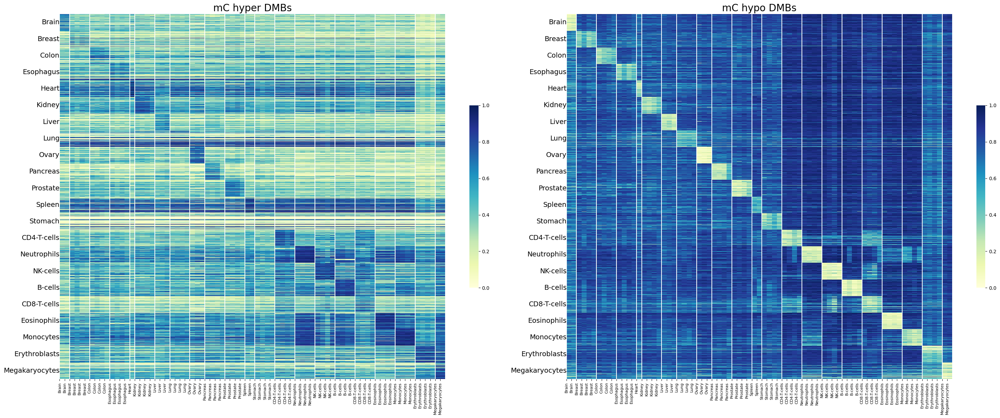

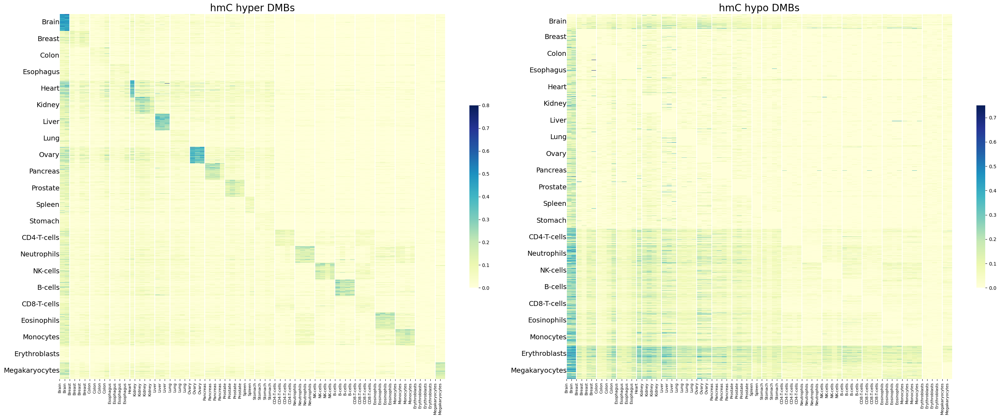

In [17]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 300

for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.healthy_dmbs.{samples_exp}.dmr10.png')
    
    

#### All samples

In [18]:
sample_grouping = "all_samples"
# delta_quants = -10
delta_quants = -10
top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
subset

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
20,False,TAPSbeta_hmm.all_samples.test7_2hiddenstates_m...,TAPSbeta,all_samples,large_blocks_4cpg,-10,300,TAPSbeta.all_samples.Tissue_Group_DMBs.top300....
25,False,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,TAPSbeta,all_samples,large_blocks_4cpg,-10,300,TAPSbeta.all_samples.Tissue_Group_DMBs.top300....
50,False,TAPSbeta_hmm.all_samples.test7_2hiddenstates_m...,CAPS,all_samples,large_blocks_4cpg,-10,300,CAPS.all_samples.Tissue_Group_DMBs.top300.TAPS...
55,False,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,CAPS,all_samples,large_blocks_4cpg,-10,300,CAPS.all_samples.Tissue_Group_DMBs.top300.CAPS...


In [19]:
subset.loc[subset['exp']=="TAPSbeta"]

,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
20,False,TAPSbeta_hmm.all_samples.test7_2hiddenstates_m...,TAPSbeta,all_samples,large_blocks_4cpg,-10,300,TAPSbeta.all_samples.Tissue_Group_DMBs.top300....
25,False,CAPS_hmm.all_samples.test7_2hiddenstates_minco...,TAPSbeta,all_samples,large_blocks_4cpg,-10,300,TAPSbeta.all_samples.Tissue_Group_DMBs.top300....


### Top 300 dmr13

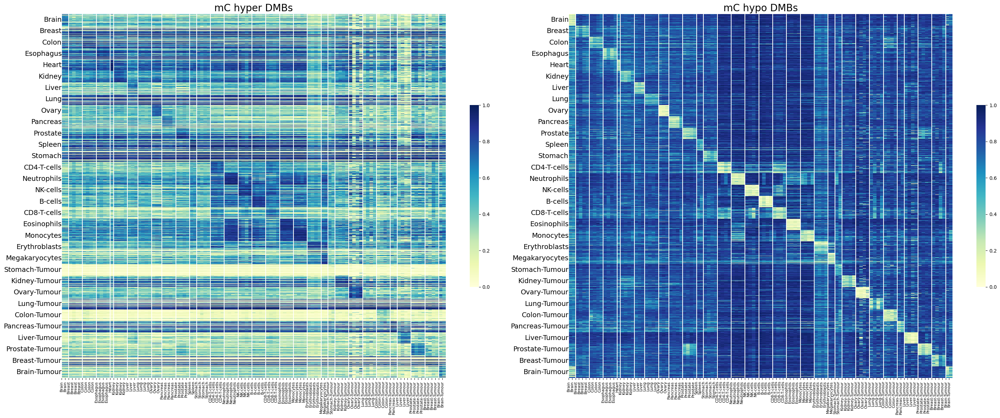

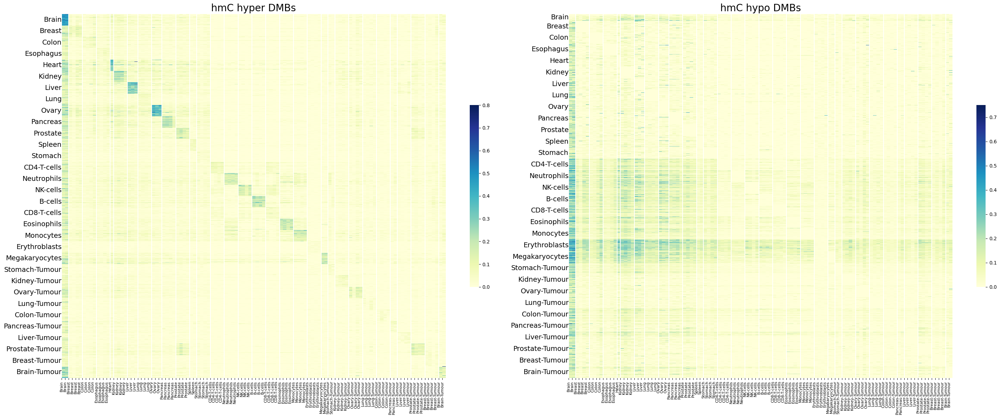

In [30]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 300




### Get subset of settings df corresponding to these settings
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])
sample_grouping = "all_samples"
# delta_quants = -10
delta_quants = -10
top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
# subset


for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    
    
    
    ## Remove cirrhosis and pancreatitis from rows and cols
    dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
    drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
    dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.healthy_dmbs.{samples_exp}.dmr10.png')
    
    

### Top1000 dmr13



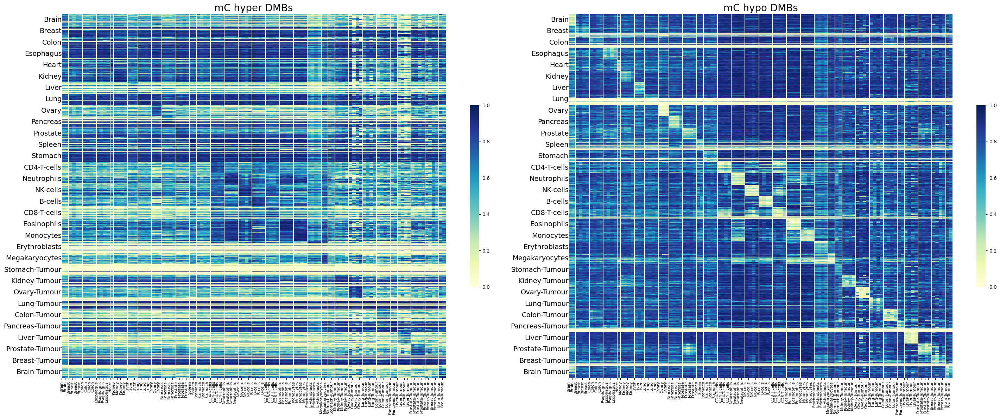

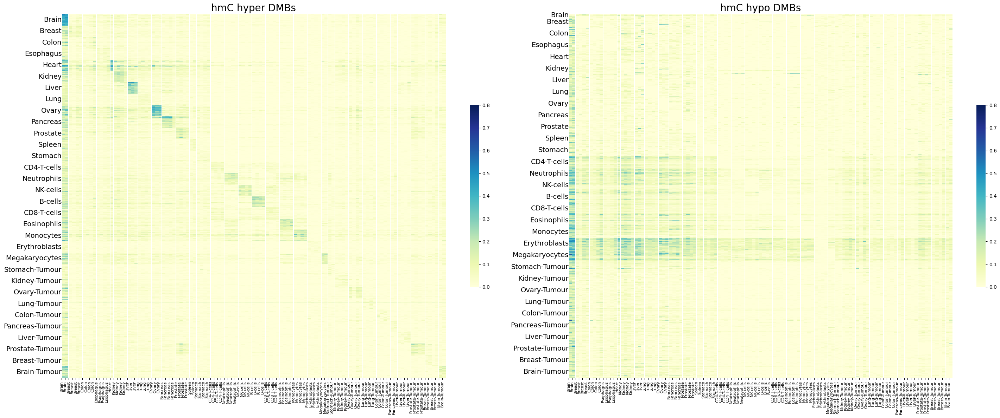

In [31]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 1000

### Get subset of settings df corresponding to these settings
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])
sample_grouping = "all_samples"
# delta_quants = -10
delta_quants = -10
# top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
# subset




for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    
    
    
    ## Remove cirrhosis and pancreatitis from rows and cols
    dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
    drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
    dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.healthy_dmbs.{samples_exp}.dmr10.png')
    
    

### Top1000 dmr13 filtered

1. Take top 1000
2. Only include DMBs with delta_quants > 0
3. Only include DMBs with delta_means between tissue and nearest tissue > 0 
4. Sort by delta_quants and pick max 300



In [188]:
filename

'TAPSbeta.healthy_high_cov_samples.Tissue_Group_DMBs.top1000.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv'

In [195]:
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 1000

### Get subset of settings df corresponding to these settings
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])
sample_grouping = "healthy_high_cov_samples"
# delta_quants = -10
delta_quants = -10
# top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
settings_subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
# subset




for samples_exp in ['TAPSbeta','CAPS'][0:1]:
    for hyper_or_hypo in ['Hypo','Hyper'][0:1]:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
        filename = settings_subset.loc[settings_subset['exp']==samples_exp]['savename'].values[0]

        dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    


        ## Remove cirrhosis and pancreatitis from rows and cols
        dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
        drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
        dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])


        dmbs = dmbs[dmbs['delta_quants'] > 0]
        # Set 'chr_start_end' as the index of the DataFrame
        dmbs.set_index('chr_start_end', inplace=True)

#         dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=="Hypo"]
        dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']==hyper_or_hypo]
        
        
        
        
        
        ### Add nearest_tissue stats to dmbs
        
        unique_tissues = pd.unique(dmbs['selected_tissue'])
        all_subsets = []
        hypo = True
        for tissue in unique_tissues:
            subset = dmbs.loc[dmbs['selected_tissue']==tissue]
            subset = subset.reset_index()
            merged_df = subset[['chr_start_end']].copy()

            for group_name in unique_tissues:
                columns = tissue_id_map[group_name]
                merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)

            merged_df = merged_df.set_index('chr_start_end')
            correlations = merged_df.corr().loc[tissue].drop(tissue)
            most_related_tissue = correlations.idxmax()


            subset['most_related_tissue'] = most_related_tissue
            subset.set_index('chr_start_end',inplace=True)

            toi_samples = [u for u in tissue_id_map[tissue] if u in dmbs.columns]
            most_related_tissue_samples = [u for u in tissue_id_map[most_related_tissue] if u in dmbs.columns]

        #     subset[toi_samples]
        #     subset[most_related_tissue_samples]

            if hypo: # if hypo, we want target tissue to have lowest methylation
                subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
            else:
                subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
            print(f"For {tissue}, most correlated tissue = {most_related_tissue}")




            pval=0.05
            bonferroni_alpha = pval / len(subset)

            tg_names = toi_samples
            bg_names = most_related_tissue_samples
            if len(tg_names) == 1:
                # Use the single value in tg_names as the population mean
                print(f"Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single value in tg_group. \nNull hypothesis is expected value (mean) of samples is equal to existing population mean")
                popmean = subset[tg_names].values.flatten()[0]
                r = ttest_1samp(subset[bg_names], popmean, axis=1, nan_policy='omit')
            elif len(bg_names) == 1:
                # Use the single value in bg_names as the population mean
                print(f"Only one tissue sample in bg_group, so using one-sample independent t-test (two-sided) - comparing mean of tg_group to a single value in bg_group")
                popmean = subset[bg_names].values.flatten()[0]
                r = ttest_1samp(subset[tg_names], popmean, axis=1, nan_policy='omit')
            else:
                print(f"Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. \n Size of tg_group={len(tg_names)} and size of bg_group={len(bg_names)}")
                # r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')
                r = ttest_ind(subset[tg_names], subset[bg_names], axis=1, nan_policy='omit',equal_var=False)

            subset['nearest_tissue_ttest'] = r.pvalue
            # tfX['nearest_tissue_ttest'] = tfX['ttest'] <= bonferroni_alpha






            all_subsets.append(subset)

            
            
            
        new_dmbs = pd.concat(all_subsets)
#         new_dmbs.to_csv(dmr_dir + filename[0:-4] + f".{hyper_or_hypo}.delta_quants0.ADD_nearest_tissue_stats.csv",
#                        sep='\t')
#         #     subset.corr()
    
    

For Brain, most correlated tissue = Breast
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=2 and size of bg_group=4
For Breast, most correlated tissue = Esophagus
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Colon, most correlated tissue = Kidney
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Esophagus, most correlated tissue = Breast
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Heart, most correlated tissue = Lung
Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single

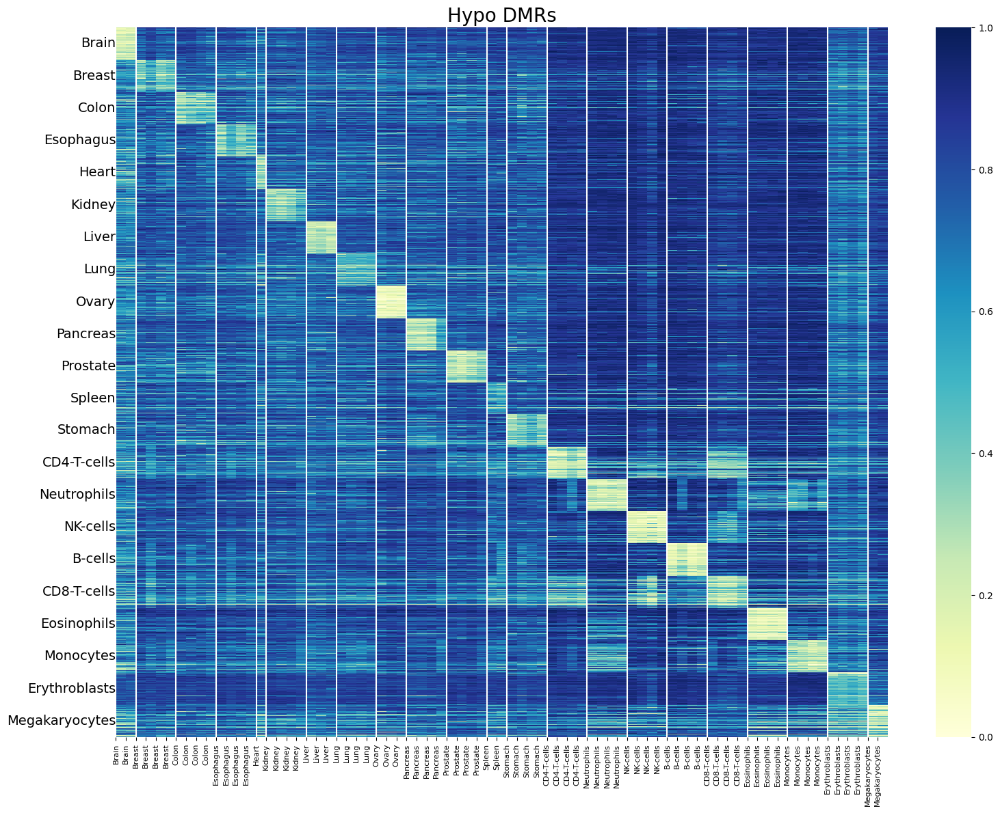

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [196]:
plot_single_heatmap(dmbs)

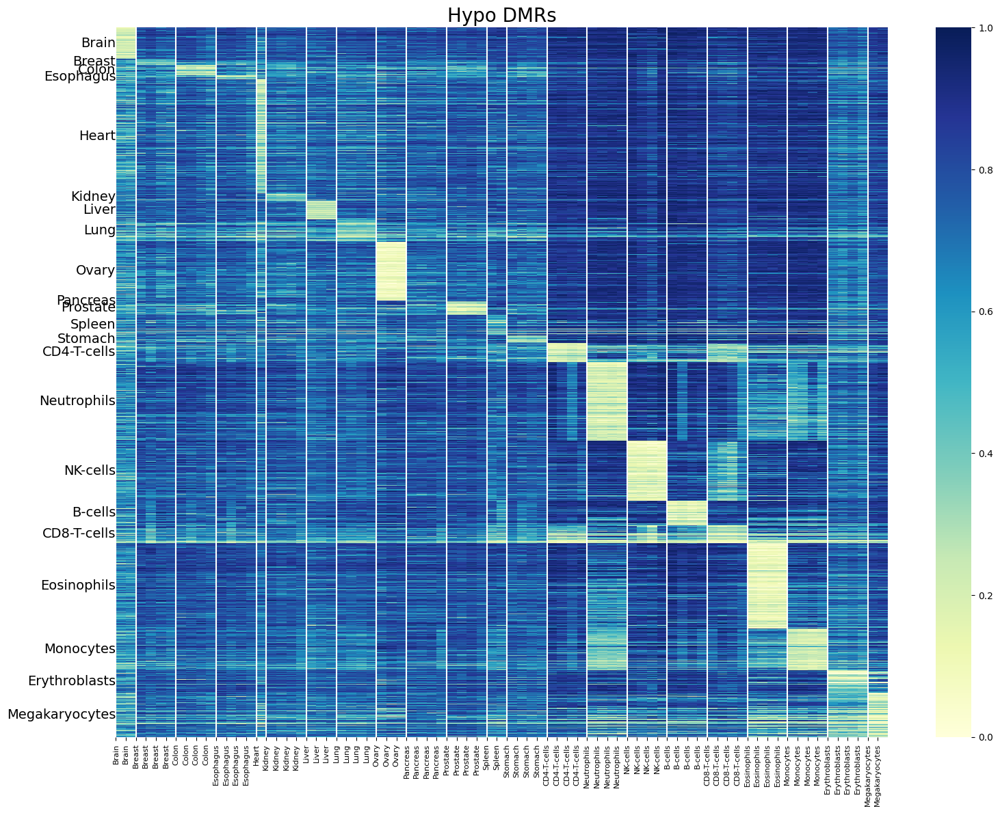

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [210]:
plot_single_heatmap(dmbs.loc[dmbs['significant_dmrs']==True])

In [203]:
new_dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,most_related_tissue,delta_means_nearest_group,nearest_tissue_ttest
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.146217,0.808623,0.662405,1.063672e-02,False,Hypo,Brain,Breast,0.750989,0.010898
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.100045,0.701491,0.601445,7.845894e-07,False,Hypo,Brain,Breast,0.745523,0.000034
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.121500,0.712820,0.591320,2.531644e-80,True,Hypo,Brain,Breast,0.687850,0.000518
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.187203,0.776881,0.589678,2.605540e-85,True,Hypo,Brain,Breast,0.691312,0.000007
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.140404,0.727688,0.587285,8.537094e-03,False,Hypo,Brain,Breast,0.759635,0.000262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr12_117050880_117051748,0.752167,0.734278,0.700944,0.780611,0.787000,0.794278,0.807444,0.723778,0.639667,0.728500,...,0.115250,0.183089,0.067839,1.173143e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.448847,0.007670
chr18_35087517_35088544,0.810000,0.878750,0.822000,0.719000,0.735250,0.749000,0.724500,0.698000,0.779250,0.785000,...,0.278250,0.345750,0.067500,2.232451e-10,True,Hypo,Megakaryocytes,Erythroblasts,0.133750,0.002646
chr14_37074411_37074861,0.771833,0.816667,0.809333,0.816500,0.870500,0.923667,0.846167,0.842500,0.760333,0.774167,...,0.638750,0.706042,0.067292,1.696030e-04,False,Hypo,Megakaryocytes,Erythroblasts,0.206833,0.000604


In [208]:
# new_dmbs_filtered = new_dmbs.loc[new_dmbs['delta_means_nearest_group']>0.2]
new_dmbs_filtered = new_dmbs.loc[new_dmbs['nearest_tissue_ttest']<0.001]

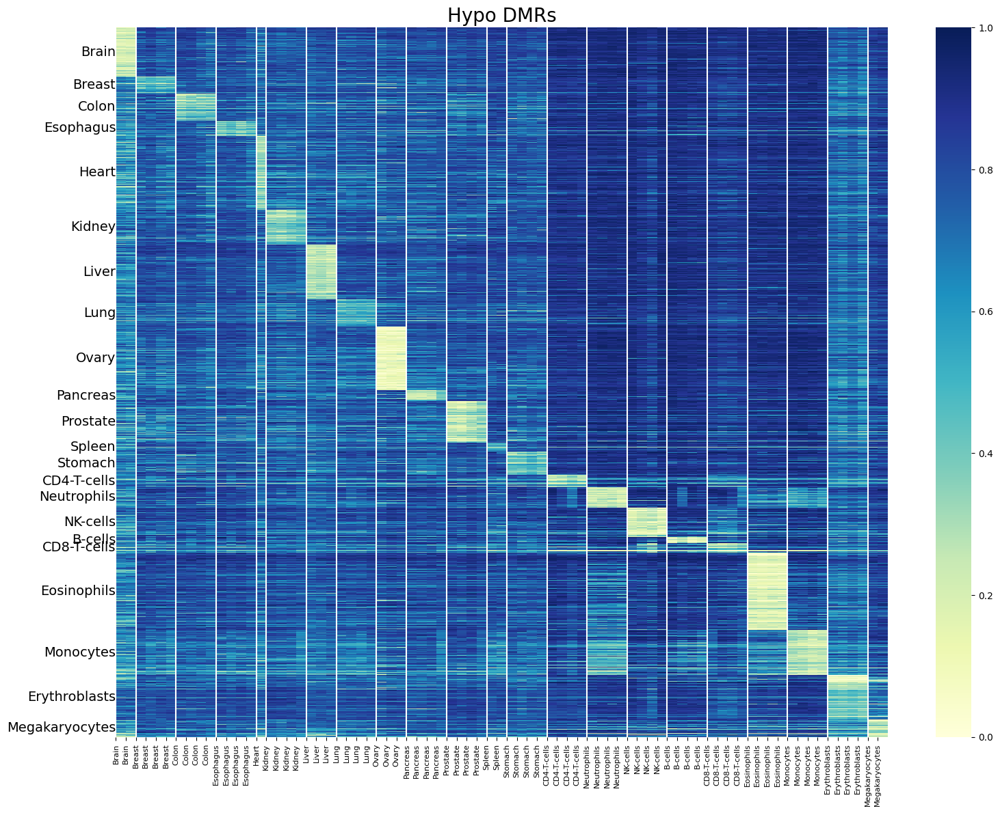

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [209]:
plot_single_heatmap(new_dmbs_filtered)

In [193]:
# unique_tissues = pd.unique(dmbs['selected_tissue'])
# all_subsets = []
# hypo = True
# for tissue in unique_tissues:
#     subset = dmbs.loc[dmbs['selected_tissue']==tissue]
#     subset = subset.reset_index()
#     merged_df = subset[['chr_start_end']].copy()

#     for group_name in unique_tissues:
#         columns = tissue_id_map[group_name]
#         merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)
    
#     merged_df = merged_df.set_index('chr_start_end')
#     correlations = merged_df.corr().loc[tissue].drop(tissue)
#     most_related_tissue = correlations.idxmax()
    
    
#     subset['most_related_tissue'] = most_related_tissue
#     subset.set_index('chr_start_end',inplace=True)
    
#     toi_samples = [u for u in tissue_id_map[tissue] if u in dmbs.columns]
#     most_related_tissue_samples = [u for u in tissue_id_map[most_related_tissue] if u in dmbs.columns]
    
# #     subset[toi_samples]
# #     subset[most_related_tissue_samples]
    
#     if hypo: # if hypo, we want target tissue to have lowest methylation
#         subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
#     else:
#         subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
#     print(f"For {tissue}, most correlated tissue = {most_related_tissue}")
    
    
    
    
#     pval=0.05
#     bonferroni_alpha = pval / len(subset)

#     tg_names = toi_samples
#     bg_names = most_related_tissue_samples
#     if len(tg_names) == 1:
#         # Use the single value in tg_names as the population mean
#         print(f"Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single value in tg_group. \nNull hypothesis is expected value (mean) of samples is equal to existing population mean")
#         popmean = subset[tg_names].values.flatten()[0]
#         r = ttest_1samp(subset[bg_names], popmean, axis=1, nan_policy='omit')
#     elif len(bg_names) == 1:
#         # Use the single value in bg_names as the population mean
#         print(f"Only one tissue sample in bg_group, so using one-sample independent t-test (two-sided) - comparing mean of tg_group to a single value in bg_group")
#         popmean = subset[bg_names].values.flatten()[0]
#         r = ttest_1samp(subset[tg_names], popmean, axis=1, nan_policy='omit')
#     else:
#         print(f"Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. \n Size of tg_group={len(tg_names)} and size of bg_group={len(bg_names)}")
#         # r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')
#         r = ttest_ind(subset[tg_names], subset[bg_names], axis=1, nan_policy='omit',equal_var=False)

#     subset['nearest_tissue_ttest'] = r.pvalue
#     # tfX['nearest_tissue_ttest'] = tfX['ttest'] <= bonferroni_alpha

    
    
    
    

#     all_subsets.append(subset)

# #     subset.corr()
    
    

In [153]:
dmbs['selected_tissue'].value_counts()

Brain             1000
Breast            1000
Erythroblasts     1000
Monocytes         1000
Eosinophils       1000
CD8-T-cells       1000
B-cells           1000
NK-cells          1000
Neutrophils       1000
CD4-T-cells       1000
Stomach           1000
Megakaryocytes    1000
Prostate          1000
Pancreas          1000
Ovary             1000
Lung              1000
Liver             1000
Kidney            1000
Heart             1000
Esophagus         1000
Colon             1000
Spleen             977
Name: selected_tissue, dtype: int64

In [139]:
dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.136152,0.908591,0.772439,0.146217,0.808623,0.662405,1.063672e-02,False,Hypo,Brain
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.095182,0.870608,0.775427,0.100045,0.701491,0.601445,7.845894e-07,False,Hypo,Brain
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.121200,0.862237,0.741037,0.121500,0.712820,0.591320,2.531644e-80,True,Hypo,Brain
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.187156,0.879028,0.691871,0.187203,0.776881,0.589678,2.605540e-85,True,Hypo,Brain
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.130115,0.863330,0.733215,0.140404,0.727688,0.587285,8.537094e-03,False,Hypo,Brain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr12_117050880_117051748,0.752167,0.734278,0.700944,0.780611,0.787000,0.794278,0.807444,0.723778,0.639667,0.728500,...,0.095333,0.645963,0.550630,0.115250,0.183089,0.067839,1.173143e-02,False,Hypo,Megakaryocytes
chr18_35087517_35088544,0.810000,0.878750,0.822000,0.719000,0.735250,0.749000,0.724500,0.698000,0.779250,0.785000,...,0.273000,0.697063,0.424063,0.278250,0.345750,0.067500,2.232451e-10,True,Hypo,Megakaryocytes
chr14_37074411_37074861,0.771833,0.816667,0.809333,0.816500,0.870500,0.923667,0.846167,0.842500,0.760333,0.774167,...,0.635333,0.801518,0.166184,0.638750,0.706042,0.067292,1.696030e-04,False,Hypo,Megakaryocytes


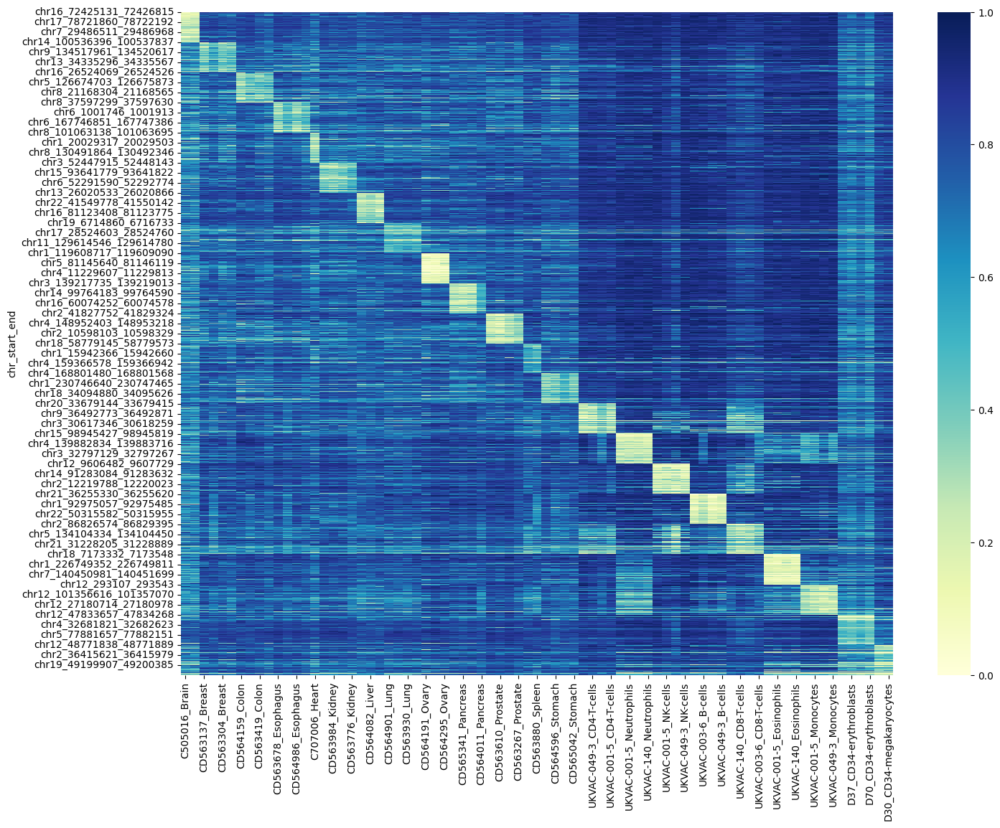

In [140]:

def plot_basic_dmb_heatmap(dmbs):
    fig,ax = plt.subplots(figsize=(16,12))

    tissue_sample_order = []
    for tissue in pd.unique(dmbs['selected_tissue']):
        tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in dmbs.columns])

    # dmbs[[u for u in dmbs.columns if u in id_tissue_map.keys()]]
    sns.heatmap(dmbs[tissue_sample_order],
                ax=ax,
               cmap="YlGnBu")
    
    
    return fig,ax

_,_= plot_basic_dmb_heatmap(dmbs)

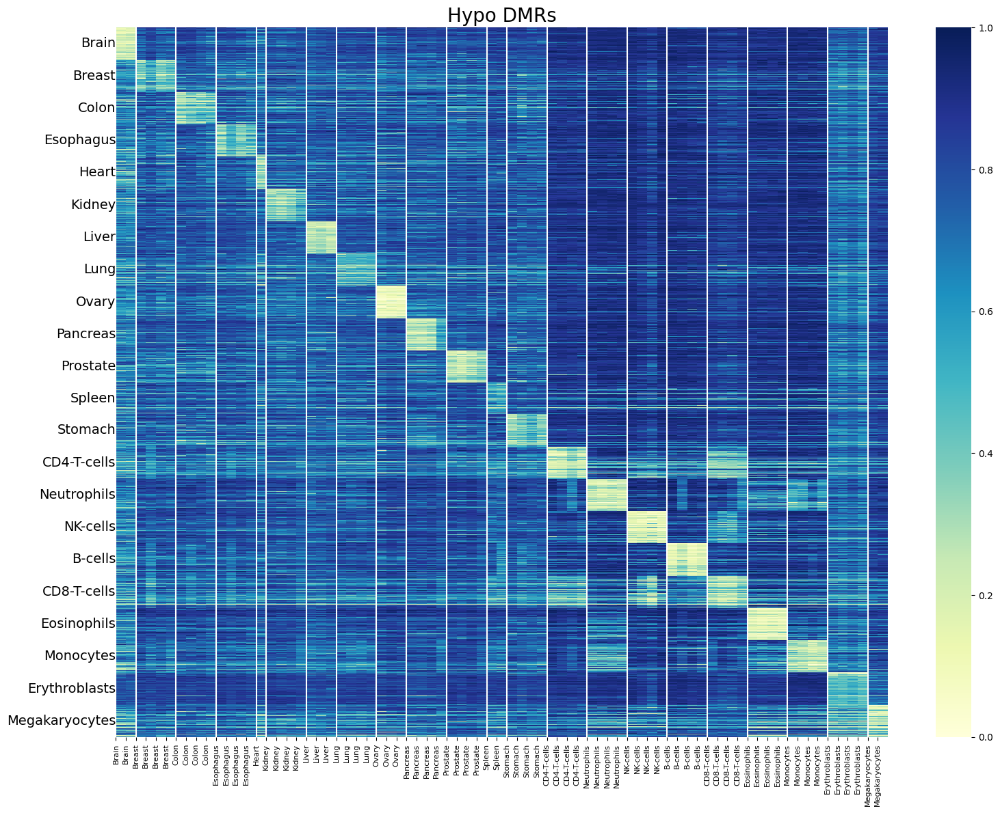

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [154]:
plot_single_heatmap(dmbs)

In [124]:
pd.unique(dmbs['selected_tissue'])

array(['Brain', 'Breast', 'Colon', 'Esophagus', 'Heart', 'Kidney',
       'Liver', 'Lung', 'Ovary', 'Pancreas', 'Prostate', 'Spleen',
       'Stomach', 'CD4-T-cells', 'Neutrophils', 'NK-cells', 'B-cells',
       'CD8-T-cells', 'Eosinophils', 'Monocytes', 'Erythroblasts',
       'Megakaryocytes'], dtype=object)

In [155]:
unique_tissues

array(['Brain', 'Breast', 'Colon', 'Esophagus', 'Heart', 'Kidney',
       'Liver', 'Lung', 'Ovary', 'Pancreas', 'Prostate', 'Spleen',
       'Stomach', 'CD4-T-cells', 'Neutrophils', 'NK-cells', 'B-cells',
       'CD8-T-cells', 'Eosinophils', 'Monocytes', 'Erythroblasts',
       'Megakaryocytes'], dtype=object)

In [158]:
subset

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,most_related_tissue,delta_means_nearest_group
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr6_149044584_149044717,0.763750,0.878250,0.914250,0.799750,0.805500,0.815750,0.792750,0.663000,0.907500,0.918750,...,0.818123,0.009625,0.509062,0.499437,1.601726e-60,True,Hypo,Megakaryocytes,Erythroblasts,0.594500
chr2_96483290_96484187,0.858857,0.852857,0.850643,0.805643,0.844786,0.870929,0.826571,0.849500,0.728786,0.741500,...,0.663489,0.196964,0.692096,0.495132,2.591519e-03,False,Hypo,Megakaryocytes,Erythroblasts,0.639268
chr12_48771838_48771889,0.897250,0.854250,0.772250,0.819500,0.865250,0.848000,0.895000,0.816250,0.775750,0.720000,...,0.662155,0.154312,0.623062,0.468750,7.035719e-03,False,Hypo,Megakaryocytes,Erythroblasts,0.593875
chr11_68598269_68598942,0.902100,0.924600,0.702200,0.783200,0.845400,0.779600,0.833200,0.844500,0.808700,0.771300,...,0.741311,0.117200,0.582605,0.465405,1.441387e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.741450
chr12_604623_605012,0.848000,0.865000,0.858667,0.822333,0.852833,0.834500,0.813667,0.840167,0.704333,0.617167,...,0.720176,0.033583,0.494625,0.461042,1.344080e-24,True,Hypo,Megakaryocytes,Erythroblasts,0.528083
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr12_117050880_117051748,0.752167,0.734278,0.700944,0.780611,0.787000,0.794278,0.807444,0.723778,0.639667,0.728500,...,0.550630,0.115250,0.183089,0.067839,1.173143e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.448847
chr18_35087517_35088544,0.810000,0.878750,0.822000,0.719000,0.735250,0.749000,0.724500,0.698000,0.779250,0.785000,...,0.424063,0.278250,0.345750,0.067500,2.232451e-10,True,Hypo,Megakaryocytes,Erythroblasts,0.133750
chr14_37074411_37074861,0.771833,0.816667,0.809333,0.816500,0.870500,0.923667,0.846167,0.842500,0.760333,0.774167,...,0.166184,0.638750,0.706042,0.067292,1.696030e-04,False,Hypo,Megakaryocytes,Erythroblasts,0.206833


In [159]:
correlations

Brain            0.517306
Breast           0.613145
Colon            0.575730
Esophagus        0.633762
Heart            0.618761
Kidney           0.585643
Liver            0.553271
Lung             0.664015
Ovary            0.505633
Pancreas         0.505767
Prostate         0.532167
Spleen           0.680954
Stomach          0.607454
CD4-T-cells      0.531713
Neutrophils      0.650565
NK-cells         0.594085
B-cells          0.600859
CD8-T-cells      0.534630
Eosinophils      0.695260
Monocytes        0.652267
Erythroblasts    0.771607
Name: Megakaryocytes, dtype: float64

In [160]:
merged_df

,Brain,Breast,Colon,Esophagus,Heart,Kidney,Liver,Lung,Ovary,Pancreas,...,Stomach,CD4-T-cells,Neutrophils,NK-cells,B-cells,CD8-T-cells,Eosinophils,Monocytes,Erythroblasts,Megakaryocytes
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr6_149044584_149044717,0.288375,0.759813,0.839000,0.811562,0.776750,0.865125,0.879667,0.722000,0.880833,0.900125,...,0.858125,0.941125,0.838813,0.929312,0.948250,0.941125,0.808813,0.852875,0.603250,0.008750
chr2_96483290_96484187,0.691571,0.834732,0.842000,0.823518,0.704286,0.801929,0.799976,0.683571,0.833048,0.846268,...,0.838768,0.928982,0.923643,0.944964,0.954696,0.918161,0.915054,0.926054,0.827625,0.188357
chr12_48771838_48771889,0.687375,0.819000,0.835813,0.848375,0.596250,0.869500,0.802333,0.827063,0.838167,0.884250,...,0.877750,0.796687,0.774188,0.649375,0.921875,0.739500,0.737938,0.831937,0.737250,0.143375
chr11_68598269_68598942,0.414150,0.830775,0.828025,0.844575,0.648400,0.780350,0.777400,0.702975,0.804033,0.886600,...,0.863175,0.945250,0.861525,0.926575,0.938850,0.944675,0.892425,0.918525,0.841850,0.100400
chr12_604623_605012,0.512333,0.809958,0.848500,0.831583,0.358333,0.803958,0.681389,0.651583,0.858056,0.829292,...,0.793167,0.874625,0.598833,0.821917,0.874667,0.820500,0.632083,0.654000,0.558250,0.030167
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr12_117050880_117051748,0.612056,0.579903,0.742000,0.638361,0.339167,0.584889,0.569148,0.671542,0.688611,0.329653,...,0.569944,0.853639,0.925375,0.182597,0.821681,0.546042,0.756931,0.910764,0.544181,0.095333
chr18_35087517_35088544,0.282875,0.762062,0.807438,0.767750,0.582750,0.685250,0.626583,0.640250,0.760333,0.819000,...,0.786188,0.860125,0.581438,0.811250,0.751437,0.816125,0.552813,0.577000,0.406750,0.273000
chr14_37074411_37074861,0.673417,0.791375,0.803583,0.767917,0.722500,0.728875,0.808389,0.799333,0.773222,0.791625,...,0.762167,0.814458,0.826958,0.812500,0.856833,0.759500,0.851958,0.861333,0.842167,0.635333


### Compare delta means

In [181]:
unique_tissues = pd.unique(dmbs['selected_tissue'])
all_subsets = []
hypo = True
for tissue in unique_tissues:
    subset = dmbs.loc[dmbs['selected_tissue']==tissue]
    subset = subset.reset_index()
    merged_df = subset[['chr_start_end']].copy()

    for group_name in unique_tissues:
        columns = tissue_id_map[group_name]
        merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)
    
    merged_df = merged_df.set_index('chr_start_end')
    correlations = merged_df.corr().loc[tissue].drop(tissue)
    most_related_tissue = correlations.idxmax()
    
    
    subset['most_related_tissue'] = most_related_tissue
    subset.set_index('chr_start_end',inplace=True)
    
    toi_samples = [u for u in tissue_id_map[tissue] if u in dmbs.columns]
    most_related_tissue_samples = [u for u in tissue_id_map[most_related_tissue] if u in dmbs.columns]
    
#     subset[toi_samples]
#     subset[most_related_tissue_samples]
    
    if hypo: # if hypo, we want target tissue to have lowest methylation
        subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
    else:
        subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
    print(f"For {tissue}, most correlated tissue = {most_related_tissue}")

    all_subsets.append(subset)

#     subset.corr()
    
    

For Brain, most correlated tissue = Breast
For Breast, most correlated tissue = Esophagus
For Colon, most correlated tissue = Kidney
For Esophagus, most correlated tissue = Breast
For Heart, most correlated tissue = Lung
For Kidney, most correlated tissue = Breast
For Liver, most correlated tissue = Stomach
For Lung, most correlated tissue = Esophagus
For Ovary, most correlated tissue = Breast
For Pancreas, most correlated tissue = Stomach
For Prostate, most correlated tissue = Colon
For Spleen, most correlated tissue = Lung
For Stomach, most correlated tissue = Lung
For CD4-T-cells, most correlated tissue = CD8-T-cells
For Neutrophils, most correlated tissue = Monocytes
For NK-cells, most correlated tissue = CD8-T-cells
For B-cells, most correlated tissue = Spleen
For CD8-T-cells, most correlated tissue = CD4-T-cells
For Eosinophils, most correlated tissue = Stomach
For Monocytes, most correlated tissue = Neutrophils
For Erythroblasts, most correlated tissue = Heart
For Megakaryocytes

### Add t test between target and nearest group

In [183]:
unique_tissues = pd.unique(dmbs['selected_tissue'])
all_subsets = []
hypo = True
for tissue in unique_tissues:
    subset = dmbs.loc[dmbs['selected_tissue']==tissue]
    subset = subset.reset_index()
    merged_df = subset[['chr_start_end']].copy()

    for group_name in unique_tissues:
        columns = tissue_id_map[group_name]
        merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)
    
    merged_df = merged_df.set_index('chr_start_end')
    correlations = merged_df.corr().loc[tissue].drop(tissue)
    most_related_tissue = correlations.idxmax()
    
    
    subset['most_related_tissue'] = most_related_tissue
    subset.set_index('chr_start_end',inplace=True)
    
    toi_samples = [u for u in tissue_id_map[tissue] if u in dmbs.columns]
    most_related_tissue_samples = [u for u in tissue_id_map[most_related_tissue] if u in dmbs.columns]
    
#     subset[toi_samples]
#     subset[most_related_tissue_samples]
    
    if hypo: # if hypo, we want target tissue to have lowest methylation
        subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
    else:
        subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
    print(f"For {tissue}, most correlated tissue = {most_related_tissue}")
    
    
    
    
    pval=0.05
    bonferroni_alpha = pval / len(subset)

    tg_names = toi_samples
    bg_names = most_related_tissue_samples
    if len(tg_names) == 1:
        # Use the single value in tg_names as the population mean
        print(f"Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single value in tg_group. \nNull hypothesis is expected value (mean) of samples is equal to existing population mean")
        popmean = subset[tg_names].values.flatten()[0]
        r = ttest_1samp(subset[bg_names], popmean, axis=1, nan_policy='omit')
    elif len(bg_names) == 1:
        # Use the single value in bg_names as the population mean
        print(f"Only one tissue sample in bg_group, so using one-sample independent t-test (two-sided) - comparing mean of tg_group to a single value in bg_group")
        popmean = subset[bg_names].values.flatten()[0]
        r = ttest_1samp(subset[tg_names], popmean, axis=1, nan_policy='omit')
    else:
        print(f"Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. \n Size of tg_group={len(tg_names)} and size of bg_group={len(bg_names)}")
        # r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')
        r = ttest_ind(subset[tg_names], subset[bg_names], axis=1, nan_policy='omit',equal_var=False)

    subset['nearest_tissue_ttest'] = r.pvalue
    # tfX['nearest_tissue_ttest'] = tfX['ttest'] <= bonferroni_alpha

    
    
    
    

    all_subsets.append(subset)

#     subset.corr()
    
    

For Brain, most correlated tissue = Breast
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=2 and size of bg_group=4
For Breast, most correlated tissue = Esophagus
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Colon, most correlated tissue = Kidney
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Esophagus, most correlated tissue = Breast
Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. 
 Size of tg_group=4 and size of bg_group=4
For Heart, most correlated tissue = Lung
Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single

In [ ]:
unique_tissues = pd.unique(dmbs['selected_tissue'])
all_subsets = []
hypo = True
for tissue in unique_tissues:
    subset = dmbs.loc[dmbs['selected_tissue']==tissue]
    subset = subset.reset_index()
    merged_df = subset[['chr_start_end']].copy()

    for group_name in unique_tissues:
        columns = tissue_id_map[group_name]
        merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)
    
    merged_df = merged_df.set_index('chr_start_end')
    correlations = merged_df.corr().loc[tissue].drop(tissue)
    most_related_tissue = correlations.idxmax()
    
    
    subset['most_related_tissue'] = most_related_tissue
    subset.set_index('chr_start_end',inplace=True)
    if hypo: # if hypo, we want target tissue to have lowest methylation
        subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
    else:
        subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
    print(f"For {tissue}, most correlated tissue = {most_related_tissue}")
    
    

    all_subsets.append(subset)

#     subset.corr()
    
    

In [184]:
new_dmbs = pd.concat(all_subsets)

In [185]:
new_dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,most_related_tissue,delta_means_nearest_group,nearest_tissue_ttest
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.146217,0.808623,0.662405,1.063672e-02,False,Hypo,Brain,Breast,0.750989,0.010898
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.100045,0.701491,0.601445,7.845894e-07,False,Hypo,Brain,Breast,0.745523,0.000034
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.121500,0.712820,0.591320,2.531644e-80,True,Hypo,Brain,Breast,0.687850,0.000518
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.187203,0.776881,0.589678,2.605540e-85,True,Hypo,Brain,Breast,0.691312,0.000007
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.140404,0.727688,0.587285,8.537094e-03,False,Hypo,Brain,Breast,0.759635,0.000262
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr12_117050880_117051748,0.752167,0.734278,0.700944,0.780611,0.787000,0.794278,0.807444,0.723778,0.639667,0.728500,...,0.115250,0.183089,0.067839,1.173143e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.448847,0.007670
chr18_35087517_35088544,0.810000,0.878750,0.822000,0.719000,0.735250,0.749000,0.724500,0.698000,0.779250,0.785000,...,0.278250,0.345750,0.067500,2.232451e-10,True,Hypo,Megakaryocytes,Erythroblasts,0.133750,0.002646
chr14_37074411_37074861,0.771833,0.816667,0.809333,0.816500,0.870500,0.923667,0.846167,0.842500,0.760333,0.774167,...,0.638750,0.706042,0.067292,1.696030e-04,False,Hypo,Megakaryocytes,Erythroblasts,0.206833,0.000604


<Axes: >

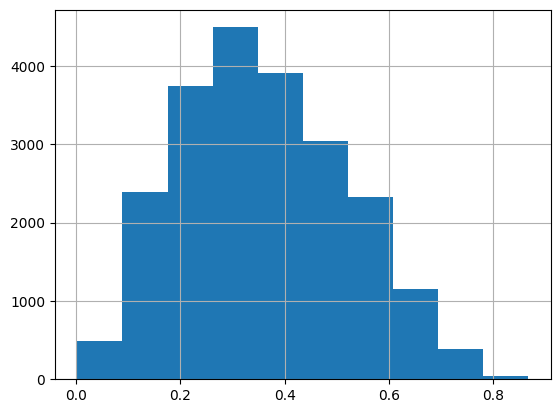

In [162]:
new_dmbs['delta_means_nearest_group'].hist()

In [166]:
# new_dmbs['delta_means_nearest_group'].hist()

In [164]:
tissue_id_map.keys()

dict_keys(['Colon', 'Stomach-Tumour', 'Prostate', 'Spleen', 'Kidney', 'Kidney-Tumour', 'Liver-Cirrhosis', 'Stomach', 'Pancreas-Pancreatitis', 'Liver', 'Brain', 'Ovary-Tumour', 'Lung-Tumour', 'Colon-Tumour', 'Pancreas', 'Pancreas-Tumour', 'Lung', 'Thymus', 'Liver-Tumour', 'Prostate-Tumour', 'Ovary', 'Heart', 'Breast', 'Breast-Tumour', 'Brain-Tumour', 'Esophagus', 'Bone-Marrow', 'CD4-T-cells', 'Neutrophils', 'NK-cells', 'B-cells', 'CD8-T-cells', 'Eosinophils', 'Monocytes', 'Erythroblasts', 'Megakaryocytes'])

<Axes: >

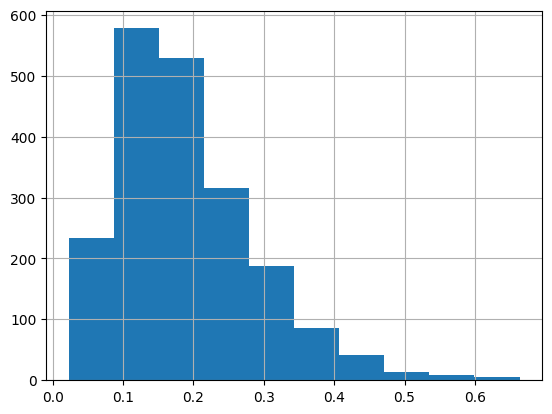

In [165]:
new_dmbs.loc[new_dmbs['selected_tissue'].isin(['CD8-T-cells','CD4-T-cells'])]['delta_means_nearest_group'].hist()

<Axes: >

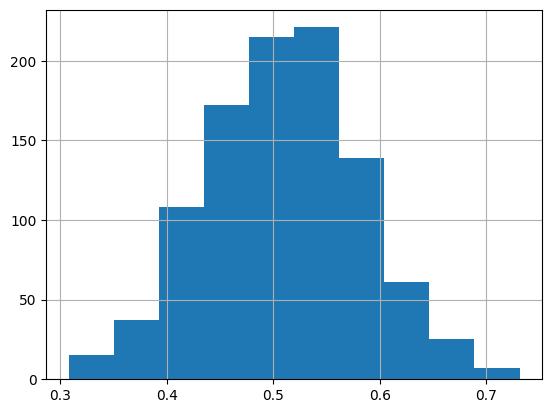

In [167]:
new_dmbs.loc[new_dmbs['selected_tissue'].isin(['Liver'])]['delta_means_nearest_group'].hist()

In [131]:
new_dmbs['selected_tissue'].value_counts()

Brain             1000
Breast            1000
Erythroblasts     1000
Monocytes         1000
Eosinophils       1000
CD8-T-cells       1000
B-cells           1000
NK-cells          1000
Neutrophils       1000
CD4-T-cells       1000
Stomach           1000
Megakaryocytes    1000
Prostate          1000
Pancreas          1000
Ovary             1000
Lung              1000
Liver             1000
Kidney            1000
Heart             1000
Esophagus         1000
Colon             1000
Spleen             977
Name: selected_tissue, dtype: int64

In [171]:
new_dmbs_filtered = new_dmbs.loc[new_dmbs['delta_means_nearest_group']>0.2]
new_dmbs_filtered['selected_tissue'].value_counts()

Brain             1000
Ovary             1000
B-cells           1000
Liver             1000
Eosinophils       1000
NK-cells           999
Heart              997
Neutrophils        992
Pancreas           985
Kidney             983
Erythroblasts      981
Prostate           970
Colon              903
Stomach            868
Esophagus          825
Breast             753
Monocytes          654
Lung               589
Megakaryocytes     474
Spleen             434
CD4-T-cells        415
CD8-T-cells        351
Name: selected_tissue, dtype: int64

In [179]:
new_dmbs_filtered

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,most_related_tissue,delta_means_nearest_group
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.772439,0.146217,0.808623,0.662405,1.063672e-02,False,Hypo,Brain,Breast,0.750989
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.775427,0.100045,0.701491,0.601445,7.845894e-07,False,Hypo,Brain,Breast,0.745523
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.741037,0.121500,0.712820,0.591320,2.531644e-80,True,Hypo,Brain,Breast,0.687850
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.691871,0.187203,0.776881,0.589678,2.605540e-85,True,Hypo,Brain,Breast,0.691312
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.733215,0.140404,0.727688,0.587285,8.537094e-03,False,Hypo,Brain,Breast,0.759635
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr6_20750911_20751221,0.716250,0.698500,0.551750,0.443000,0.589750,0.585250,0.666500,0.681250,0.791500,0.865000,...,0.513958,0.226687,0.298762,0.072075,1.868113e-04,False,Hypo,Megakaryocytes,Erythroblasts,0.518187
chr5_168434265_168434397,0.792750,0.606500,0.585000,0.589500,0.575250,0.515500,0.637500,0.565250,0.531250,0.517750,...,0.508913,0.145250,0.216850,0.071600,8.005480e-12,True,Hypo,Megakaryocytes,Erythroblasts,0.430375
chr1_214330937_214331211,0.833000,0.867000,0.879625,0.672375,0.637625,0.519125,0.711000,0.629375,0.625250,0.560250,...,0.471610,0.354187,0.424356,0.070169,6.405571e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.366312


In [173]:
new_dmbs_filtered = new_dmbs.loc[new_dmbs['delta_means_nearest_group']>0.3]
new_dmbs_filtered['selected_tissue'].value_counts()

Brain             1000
Liver             1000
Ovary             1000
Eosinophils        999
B-cells            993
Heart              839
NK-cells           838
Pancreas           819
Prostate           775
Erythroblasts      755
Kidney             750
Neutrophils        724
Colon              567
Stomach            528
Esophagus          390
Monocytes          370
Breast             308
Megakaryocytes     224
Lung               141
CD4-T-cells        138
CD8-T-cells        124
Spleen             104
Name: selected_tissue, dtype: int64

### Compare old dmbs to new

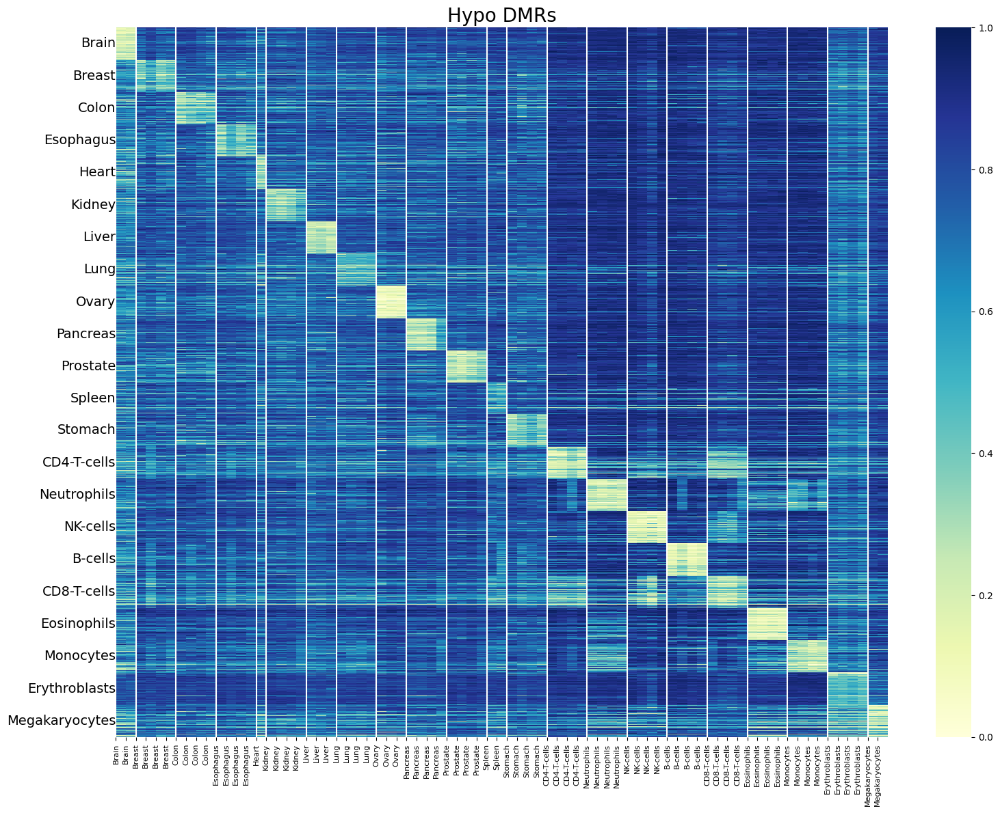

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [170]:

plot_single_heatmap(dmbs)

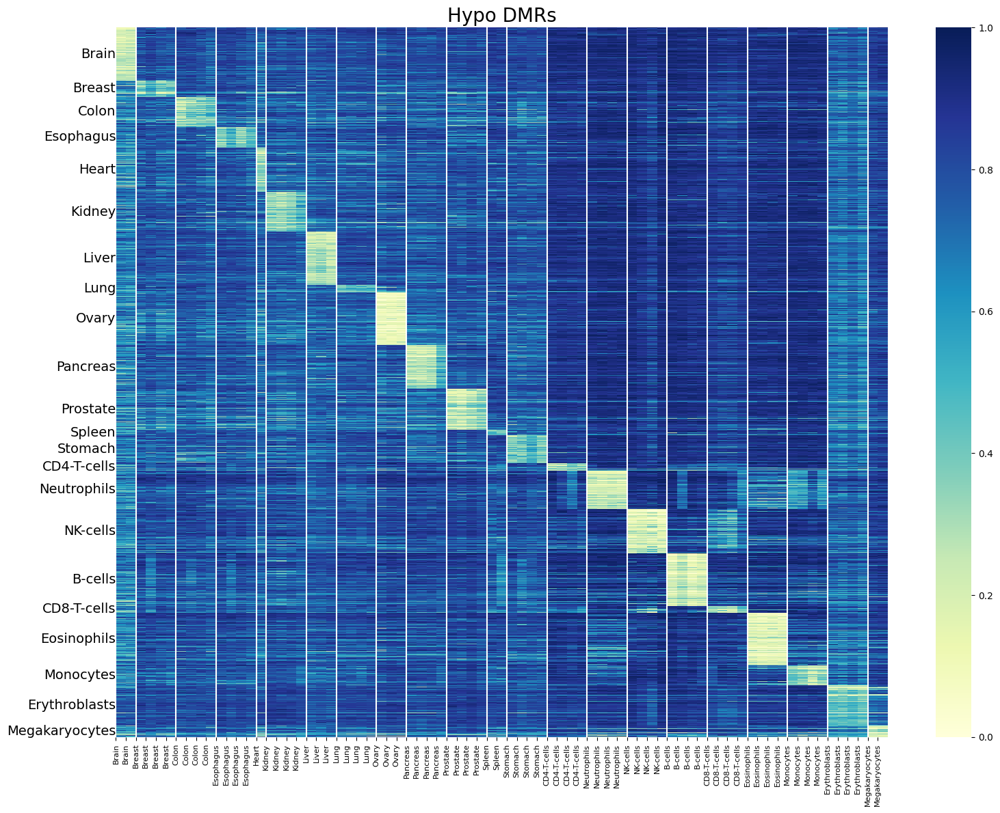

(<Figure size 1600x1200 with 2 Axes>, <Axes: title={'center': 'Hypo DMRs'}>)

In [174]:
plot_single_heatmap(new_dmbs_filtered)
# _,_= plot_basic_dmb_heatmap(new_dmbs_filtered)

In [178]:
new_dmbs_filtered

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,most_related_tissue,delta_means_nearest_group
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.772439,0.146217,0.808623,0.662405,1.063672e-02,False,Hypo,Brain,Breast,0.750989
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.775427,0.100045,0.701491,0.601445,7.845894e-07,False,Hypo,Brain,Breast,0.745523
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.741037,0.121500,0.712820,0.591320,2.531644e-80,True,Hypo,Brain,Breast,0.687850
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.691871,0.187203,0.776881,0.589678,2.605540e-85,True,Hypo,Brain,Breast,0.691312
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.733215,0.140404,0.727688,0.587285,8.537094e-03,False,Hypo,Brain,Breast,0.759635
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr6_20750911_20751221,0.716250,0.698500,0.551750,0.443000,0.589750,0.585250,0.666500,0.681250,0.791500,0.865000,...,0.513958,0.226687,0.298762,0.072075,1.868113e-04,False,Hypo,Megakaryocytes,Erythroblasts,0.518187
chr5_168434265_168434397,0.792750,0.606500,0.585000,0.589500,0.575250,0.515500,0.637500,0.565250,0.531250,0.517750,...,0.508913,0.145250,0.216850,0.071600,8.005480e-12,True,Hypo,Megakaryocytes,Erythroblasts,0.430375
chr1_214330937_214331211,0.833000,0.867000,0.879625,0.672375,0.637625,0.519125,0.711000,0.629375,0.625250,0.560250,...,0.471610,0.354187,0.424356,0.070169,6.405571e-02,False,Hypo,Megakaryocytes,Erythroblasts,0.366312


### Repeat for all samples

In [ ]:
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 1000

### Get subset of settings df corresponding to these settings
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])
sample_grouping = "healthy_high_cov_samples"
# delta_quants = -10
delta_quants = -10
# top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
settings_subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
# subset




for samples_exp in ['TAPSbeta','CAPS'][0:1]:
    for hyper_or_hypo in ['Hypo','Hyper'][0:1]:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
        filename = settings_subset.loc[settings_subset['exp']==samples_exp]['savename'].values[0]

        dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    


        ## Remove cirrhosis and pancreatitis from rows and cols
        dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
        drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
        dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])


        dmbs = dmbs[dmbs['delta_quants'] > 0]
        # Set 'chr_start_end' as the index of the DataFrame
        dmbs.set_index('chr_start_end', inplace=True)

#         dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=="Hypo"]
        dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']==hyper_or_hypo]
        
        
        
        
        
        ### Add nearest_tissue stats to dmbs
        
        unique_tissues = pd.unique(dmbs['selected_tissue'])
        all_subsets = []
        hypo = True
        for tissue in unique_tissues:
            subset = dmbs.loc[dmbs['selected_tissue']==tissue]
            subset = subset.reset_index()
            merged_df = subset[['chr_start_end']].copy()

            for group_name in unique_tissues:
                columns = tissue_id_map[group_name]
                merged_df[group_name] = subset[[u for u in columns if u in subset.columns]].mean(axis=1)

            merged_df = merged_df.set_index('chr_start_end')
            correlations = merged_df.corr().loc[tissue].drop(tissue)
            most_related_tissue = correlations.idxmax()


            subset['most_related_tissue'] = most_related_tissue
            subset.set_index('chr_start_end',inplace=True)

            toi_samples = [u for u in tissue_id_map[tissue] if u in dmbs.columns]
            most_related_tissue_samples = [u for u in tissue_id_map[most_related_tissue] if u in dmbs.columns]

        #     subset[toi_samples]
        #     subset[most_related_tissue_samples]

            if hypo: # if hypo, we want target tissue to have lowest methylation
                subset['delta_means_nearest_group'] = merged_df[most_related_tissue] - merged_df[tissue]
            else:
                subset['delta_means_nearest_group'] = merged_df[tissue] - merged_df[most_related_tissue]
            print(f"For {tissue}, most correlated tissue = {most_related_tissue}")




            pval=0.05
            bonferroni_alpha = pval / len(subset)

            tg_names = toi_samples
            bg_names = most_related_tissue_samples
            if len(tg_names) == 1:
                # Use the single value in tg_names as the population mean
                print(f"Only one tissue sample in tg_group, so using one-sample independent t-test (two-sided) - comparing mean of bg_group to a single value in tg_group. \nNull hypothesis is expected value (mean) of samples is equal to existing population mean")
                popmean = subset[tg_names].values.flatten()[0]
                r = ttest_1samp(subset[bg_names], popmean, axis=1, nan_policy='omit')
            elif len(bg_names) == 1:
                # Use the single value in bg_names as the population mean
                print(f"Only one tissue sample in bg_group, so using one-sample independent t-test (two-sided) - comparing mean of tg_group to a single value in bg_group")
                popmean = subset[bg_names].values.flatten()[0]
                r = ttest_1samp(subset[tg_names], popmean, axis=1, nan_policy='omit')
            else:
                print(f"Performing two sample independent t-test (two sided). Null hypothesis is two independent samples have identical means. \n Size of tg_group={len(tg_names)} and size of bg_group={len(bg_names)}")
                # r = ttest_ind(tfX[tg_names], tfX[bg_names], axis=1, nan_policy='omit')
                r = ttest_ind(subset[tg_names], subset[bg_names], axis=1, nan_policy='omit',equal_var=False)

            subset['nearest_tissue_ttest'] = r.pvalue
            # tfX['nearest_tissue_ttest'] = tfX['ttest'] <= bonferroni_alpha






            all_subsets.append(subset)

            
            
            
        new_dmbs = pd.concat(all_subsets)
#         new_dmbs.to_csv(dmr_dir + filename[0:-4] + f".{hyper_or_hypo}.delta_quants0.ADD_nearest_tissue_stats.csv",
#                        sep='\t')
#         #     subset.corr()
    
    

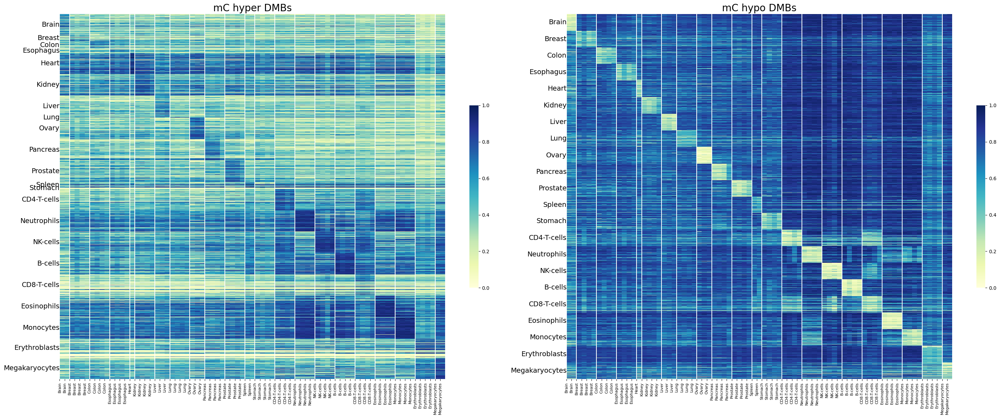

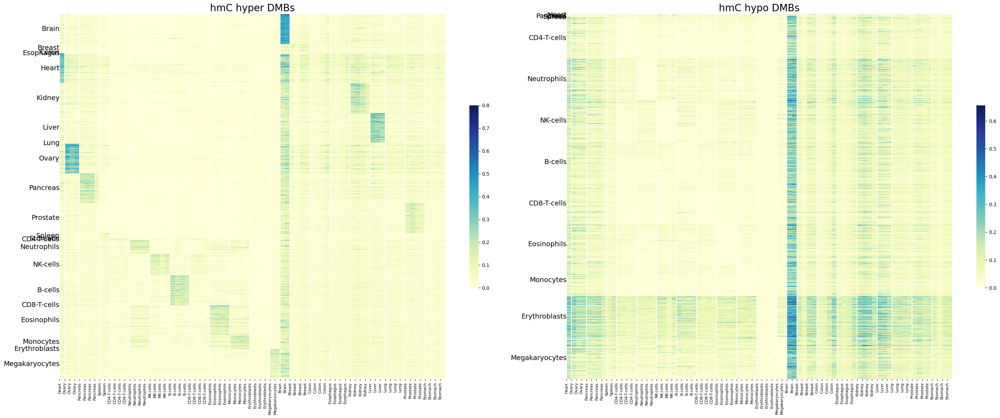

In [39]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr13/"
segment_method = "hmm"
top_n = 1000

### Get subset of settings df corresponding to these settings
savedir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr12/"
settings_df = pd.read_csv(savedir + "all_dmr_settings_df.dmr12.csv",sep='\t').drop(columns=['Unnamed: 0'])
sample_grouping = "healthy_high_cov_samples"
# delta_quants = -10
delta_quants = -10
# top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
# subset




for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    
    ## Remove cirrhosis and pancreatitis from rows and cols
    dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
    drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
    dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])

    
    dmbs = dmbs[dmbs['delta_quants'] > 0]
    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.healthy_dmbs.{samples_exp}.dmr10.png')
    
    

In [40]:
for samples_exp in ['TAPSbeta','CAPS'][0:1]:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    
    ## Remove cirrhosis and pancreatitis from rows and cols
    dmbs = dmbs.loc[dmbs['selected_tissue'].isin(healthy_tissue_types + cancer_tissue_types)]
    drop_cols = tissue_id_map['Pancreas-Pancreatitis'] + tissue_id_map['Liver-Cirrhosis']
    dmbs = dmbs.drop(columns = [u for u in drop_cols if u in dmbs.columns])

    
#     dmbs = dmbs[dmbs['delta_quants'] > 0]
    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)

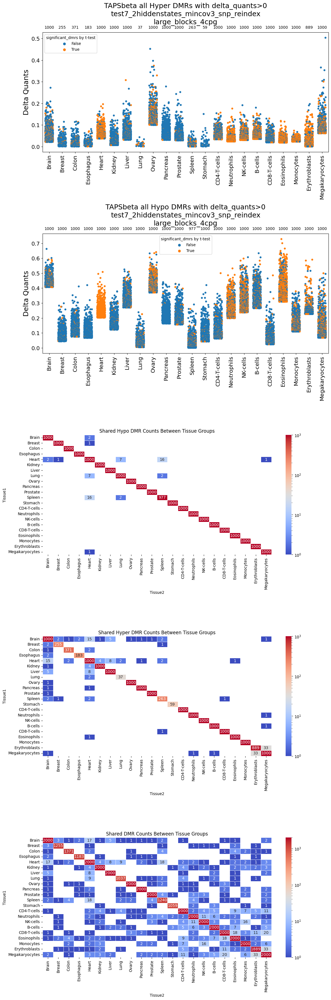

In [41]:
selected_regions = dmbs
### Filter by delta quants and significance
delta_quants_threshold = 0
t_test_filter = False

df_subset = selected_regions.loc[selected_regions['delta_quants']>delta_quants_threshold]
if t_test_filter:
    df_subset = df_subset.loc[df_subset['significant_dmrs']==True]


# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')






ax = axs[2]
# Plot 2: Heatmap for Hypo
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"]
shared_dmr_counts_df_hypo = generate_shared_dmr_counts_df(df_hypo)
sns.heatmap(shared_dmr_counts_df_hypo, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df_hyper = generate_shared_dmr_counts_df(df_hyper)
sns.heatmap(shared_dmr_counts_df_hyper, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df_all = generate_shared_dmr_counts_df(df_subset)
sns.heatmap(shared_dmr_counts_df_all, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


In [32]:
dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr1_186566123_186567783,0.000000,0.020000,0.000000,0.000000,0.000000,0.0180,0.122500,0.255500,0.000000,0.121500,...,0.000000,0.018504,0.018504,0.000000,0.000000,0.000000,1.317122e-06,True,Hypo,Brain
chr2_41592406_41594459,0.000000,0.000000,0.000000,0.000000,0.118000,0.0000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.010772,0.010772,0.000000,0.000000,0.000000,2.135470e-05,True,Hypo,Brain
chr4_144127000_144127772,0.037000,0.011500,0.000000,0.089000,0.024000,0.0210,0.024000,0.045500,0.040000,0.000000,...,0.000000,0.028237,0.028237,0.000000,0.000000,0.000000,2.879756e-14,True,Hypo,Brain
chr3_169053422_169054089,0.000000,0.000000,0.033500,0.000000,0.037000,0.0000,0.045500,0.079000,0.022500,0.091000,...,0.000000,0.021890,0.021890,0.000000,0.000000,0.000000,2.174688e-09,True,Hypo,Brain
chr2_49255153_49256463,0.000000,0.033000,0.000000,0.067000,0.000000,0.0000,0.000000,0.000000,0.000000,0.032000,...,0.000000,0.018825,0.018825,0.000000,0.000000,0.000000,1.571815e-06,True,Hypo,Brain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr9_30689039_30689153,0.000000,0.008667,0.045667,0.016000,0.015000,0.0000,0.000000,0.055667,0.020667,0.030333,...,0.138833,0.016374,0.122459,0.069417,0.055392,0.014025,5.398311e-01,False,Hyper,Brain-Tumour
chr7_118308664_118309869,0.000000,0.004600,0.000000,0.000000,0.020000,0.0068,0.000000,0.012400,0.012600,0.019600,...,0.041500,0.007488,0.034012,0.040750,0.026730,0.014020,4.339053e-03,False,Hyper,Brain-Tumour
chr13_94714760_94715650,0.000000,0.009400,0.035800,0.032600,0.010600,0.0000,0.082800,0.039000,0.019600,0.015400,...,0.075800,0.015246,0.060554,0.068100,0.054090,0.014010,1.459113e-01,False,Hyper,Brain-Tumour


In [40]:
filename

'TAPSbeta.all_samples.Tissue_Group_DMBs.top300.TAPSbeta_hmm.all_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv'

<Axes: >

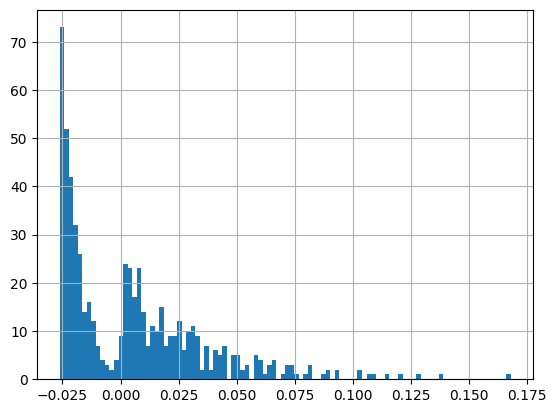

In [43]:
dmbs.loc[dmbs['selected_tissue']=="Lung"]['delta_quants'].hist(bins=100)

In [33]:
dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr22_15409468_15414200,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.032000,0.015000,0.006000,...,0.000000,0.002677,0.002677,0.000000,0.000000,0.000000,9.598876e-06,True,Hypo,Brain
chr7_62746779_62800428,0.019000,0.000000,0.023500,0.000000,0.000000,0.000000,0.000000,0.000000,0.026500,0.035500,...,0.000000,0.003022,0.003022,0.000000,0.000000,0.000000,1.227512e-03,False,Hypo,Brain
chr13_68993685_69005094,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.143000,0.000000,...,0.000000,0.013088,0.013088,0.000000,0.000000,0.000000,8.915775e-04,False,Hypo,Brain
chr13_69661146_69662742,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.006132,0.006132,0.000000,0.000000,0.000000,1.965009e-04,False,Hypo,Brain
chr13_78137286_78138322,0.000000,0.000000,0.018667,0.000000,0.000000,0.000000,0.000000,0.011333,0.011000,0.016000,...,0.000000,0.005082,0.005082,0.000000,0.000000,0.000000,1.971031e-08,True,Hypo,Brain
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr11_62621262_62622345,0.004266,0.003215,0.004013,0.005595,0.002430,0.002127,0.002228,0.002747,0.003962,0.003342,...,0.004791,0.003447,0.001344,0.004506,0.006514,-0.002008,7.151886e-02,False,Hyper,Liver-Cirrhosis
chr12_56223952_56224863,0.001681,0.001830,0.002447,0.004213,0.002064,0.000000,0.004064,0.002191,0.003298,0.002383,...,0.007590,0.003327,0.004264,0.005564,0.007573,-0.002009,4.332061e-02,False,Hyper,Liver-Cirrhosis
chr7_149872733_149874652,0.002497,0.004952,0.006701,0.007782,0.001680,0.003102,0.006823,0.004367,0.007054,0.006231,...,0.006543,0.004299,0.002244,0.005747,0.007756,-0.002009,1.966146e-02,False,Hyper,Liver-Cirrhosis


### DMR 10

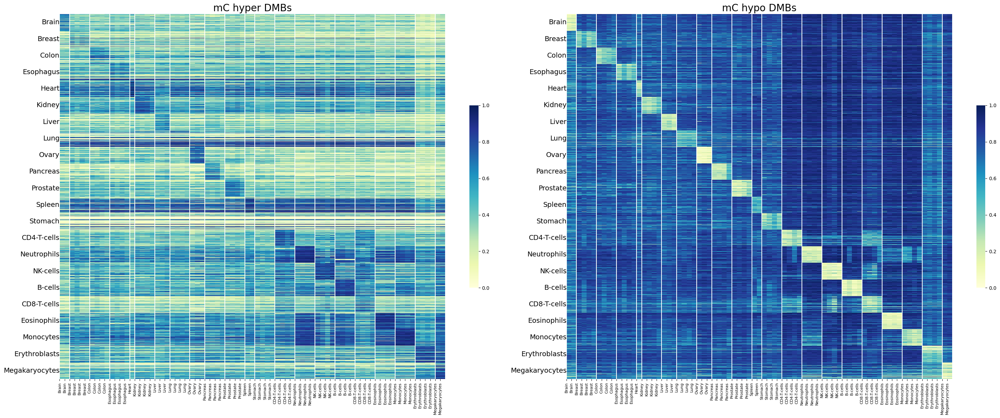

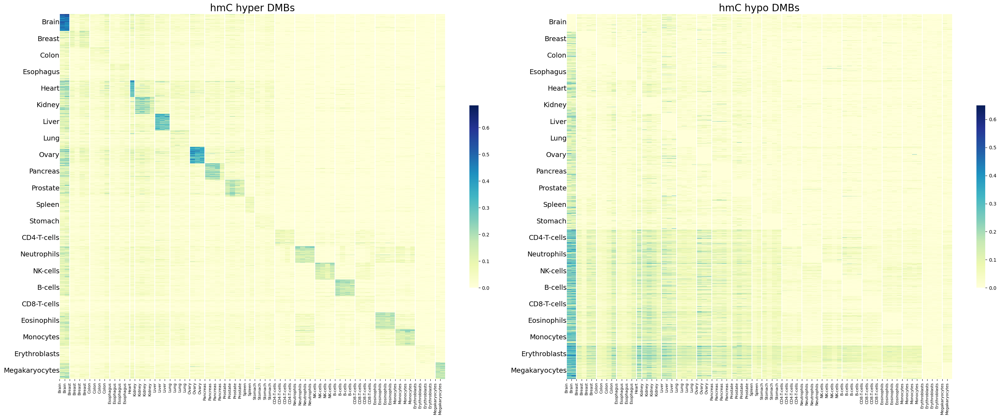

In [21]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr10/"
segment_method = "hmm"
top_n = 300

for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.healthy_dmbs.{samples_exp}.dmr10.png')
    
    

In [25]:
filename = subset.loc[subset['exp']=="CAPS"]['savename'].values[0]

In [26]:
filename

'CAPS.healthy_high_cov_samples.Tissue_Group_DMBs.top300.CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv'

In [17]:
dmbs['delta_means']

chr_start_end
chr15_37995715_37996018      0.014037
chr14_102305450_102305522    0.013339
chr17_27457372_27457482      0.012424
chr19_48716914_48716949      0.011152
chr17_69569466_69569538      0.012733
                               ...   
chr9_136633152_136633733     0.133383
chr17_68189664_68190729      0.143601
chr5_134872523_134872643     0.149738
chr1_19325035_19325222       0.115905
chr1_26550963_26551770       0.129824
Name: delta_means, Length: 13200, dtype: float64

In [27]:
# # test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# # test_name = f"test6_2hiddenstates_astair_snp_filter"
# # filter_name = "large_blocks_4cpg"
# # filter_name = "relaxed_filter_2cpg"
# sample_grouping = list(sample_list_dict.keys())[0]


# # Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr8/"
# segment_method = "hmm"
# top_n = 300

# for samples_exp in ['TAPSbeta','CAPS']:
# #     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
# #     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
# #     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
#     filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
# #     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

#     dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

#     # Set 'chr_start_end' as the index of the DataFrame
#     dmbs.set_index('chr_start_end', inplace=True)
    
#     fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
#                                     y_label_tissue_groups=True,
#                                     xticklabel_frequency=1,
#                                     cmap='Spectral_r',
#                                          landscape=True,
#                                          figsize=(30,12),
#                                          cbar_shrink=0.5
#                                     )


In [ ]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[0]


# Read the CSV file
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr9/"
segment_method = "hmm"
top_n = 300

for samples_exp in ['TAPSbeta','CAPS'][1:2]:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
#     filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = "CAPS_samples.healthy_high_cov_samples.CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.Top300_block_DMBs.csv"
#     filename = "CAPS_samples.healthy_high_cov_samples.CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.Top300_block_DMBs.csv"
#     filename = "CAPS_samples.healthy_high_cov_samples.CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.Top300_block_DMBs.csv"
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    filename = "CAPS.healthy_high_cov_samples.Tissue_Group_DMBs.top300.all_delta_quants0.CAPS_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"
    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
                                    cmap='Spectral_r',
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5
                                    )


In [ ]:
# # test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# # test_name = f"test6_2hiddenstates_astair_snp_filter"
# # filter_name = "large_blocks_4cpg"
# # filter_name = "relaxed_filter_2cpg"
# sample_grouping = list(sample_list_dict.keys())[0]


# # Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr3/"
# segment_method = "hmm"
# top_n = 300

# for samples_exp in ['TAPSbeta','CAPS']:
# #     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
# #     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
# #     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

#     dmbs = pd.read_csv(dmr_dir +  filename, sep=',')    

#     # Set 'chr_start_end' as the index of the DataFrame
#     dmbs.set_index('chr_start_end', inplace=True)
    
#     fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
#                                     y_label_tissue_groups=True,
#                                     xticklabel_frequency=1,
# #                                     cmap='Spectral_r',
#                                          landscape=True,
#                                          figsize=(30,12),
#                                          cbar_shrink=0.5
#                                     )


In [ ]:
# # test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# # test_name = f"test6_2hiddenstates_astair_snp_filter"
# # filter_name = "large_blocks_4cpg"
# # filter_name = "relaxed_filter_2cpg"
# sample_grouping = list(sample_list_dict.keys())[0]


# # Read the CSV file
# dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr9/"
# segment_method = "hmm"
# top_n = 300

# for samples_exp in ['TAPSbeta','CAPS']:
# #     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
# #     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
# #     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

#     dmbs = pd.read_csv(dmr_dir +  filename, sep=',')    

#     # Set 'chr_start_end' as the index of the DataFrame
#     dmbs.set_index('chr_start_end', inplace=True)
    
#     fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
#                                     y_label_tissue_groups=True,
#                                     xticklabel_frequency=1,
# #                                     cmap='Spectral_r',
#                                          landscape=True,
#                                          figsize=(30,12),
#                                          cbar_shrink=0.5
#                                     )


### Tumour DMBs from all samples

In [ ]:
sample_grouping = "all_samples"
# delta_quants = -10
delta_quants = -10
top_n = 300

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
subset

In [ ]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
sample_grouping = list(sample_list_dict.keys())[2]


# Read the CSV file
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr10/"
segment_method = "hmm"
top_n = 300

for samples_exp in ['TAPSbeta','CAPS']:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename, sep='\t')    

    # Set 'chr_start_end' as the index of the DataFrame
    dmbs.set_index('chr_start_end', inplace=True)
    
    fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                         cmap="YlGnBu",
                                         landscape=True,
                                         figsize=(30,12),
                                         cbar_shrink=0.5,
                                         dividing_line_color="white",
                                         ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
                                         ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
                                    )

    
    savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
#     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.{filename}.png')
    
    

In [ ]:
filename

In [ ]:
dmbs

### Visualise DMBs on MLML data

In [ ]:
filename = "/gpfs3/well/ludwig/users/cfo155/tissueMap/methcalls/mC_vs_hmC/CAPS.healthy_high_cov_samples.Top300_block_DMBs.all.meth.txt"
test = pd.read_csv(filename, sep='\t')  



### Picking optimal sets of DMBs

Considering all possible DMBs that meet our loose criteria (eg delta_quants>0), how many should we pick? 

Can either get a cutoff with statistical tests, or get this number by iterative optimisation


In [32]:
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
filename = "selecting_top_n_dmbs_metrics_50_1500.csv"
clustering_scores_df = pd.read_csv(dmr_dir + filename,
                                    sep='\t')

In [33]:
clustering_scores_df

,Unnamed: 0


In [61]:
filename = "TAPSbeta.all_samples.NOBRAIN.Tissue_Group_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr10/"
dmr_candidates = pd.read_csv(dmr_dir + filename,
                 sep='\t',
                nrows=100).set_index('chr_start_end')



In [62]:
hyper_or_hypo = "Hypo"
dmr_candidates = dmr_candidates.loc[dmr_candidates['Hyper_or_Hypo']=="Hypo"]
# df.groupby('selected_tissue').sort_values(by="delta_quants",ascending=False)

In [65]:
# topn_values = [50, 100, 150,10000]  # List of topn values to evaluate
topn_values = np.arange(100,50100,100)

# Function to select top N DMRs for each tissue
def select_topn_dmrs(dataframe, topn):
    grouped = dataframe.groupby('selected_tissue')
    topn_dmrs = pd.DataFrame()

    for name, group in grouped:
        top_dmrs = group.nlargest(topn, 'delta_quants')
        top_dmrs['rank'] = range(1, len(top_dmrs) + 1)  # Add a rank column
        topn_dmrs = pd.concat([topn_dmrs, top_dmrs])

    return topn_dmrs

# Dictionary to hold the resulting DataFrames for each topn value
resulting_dfs = {}

# for n in topn_values:
#     resulting_dfs[n] = select_topn_dmrs(df, n)

for n in topn_values:
    df = select_topn_dmrs(dmr_candidates, n)
    
    df = df[[u for u in df.columns if u in list(id_tissue_map.keys())]]
    
    
    mean_scores = apply_metrics_and_get_mean_scores(df)

    # Create a DataFrame from the mean scores dictionary for visualization
    mean_scores_all = pd.DataFrame.from_dict(mean_scores, orient='index', columns=['Mean Score'])
    

Applying Counts metric...
Completed Counts metric. Mean Score: 103.18
Applying Tau metric...
Completed Tau metric. Mean Score: 0.16813097131636734
Applying Gini metric...
Completed Gini metric. Mean Score: -0.07924156412121958
Applying Simpson metric...
Completed Simpson metric. Mean Score: 0.9904203136497988
Applying Corrected Gini metric...
Completed Corrected Gini metric. Mean Score: 0.07924156412121955
Applying Shannon Entropy metric...
Completed Shannon Entropy metric. Mean Score: 0.02036909909006477
Applying ROKU metric...
Completed ROKU metric. Mean Score: 0.5719327840951017
Applying Counts metric...
Completed Counts metric. Mean Score: 103.24
Applying Tau metric...
Completed Tau metric. Mean Score: 0.1659751648585781
Applying Gini metric...
Completed Gini metric. Mean Score: -0.07729604752752707
Applying Simpson metric...
Completed Simpson metric. Mean Score: 0.9904318686803282
Applying Corrected Gini metric...
Completed Corrected Gini metric. Mean Score: 0.07729604752752707
Ap

In [32]:
df = dmr_candidates[[u for u in dmr_candidates.columns if u in list(id_tissue_map.keys())]]
df

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,UKVAC-003-6_Monocytes,UKVAC-001-5_Monocytes,UKVAC-140_Monocytes,UKVAC-049-3_Monocytes,D30_CD34-erythroblasts,D37_CD34-erythroblasts,D66_CD34-erythroblasts,D70_CD34-erythroblasts,D66_CD34-megakaryocytes,D30_CD34-megakaryocytes
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_84789176_84789785,0.857846,0.877231,0.795538,0.831077,0.768385,0.841308,0.826231,0.805000,0.888077,0.829385,...,0.854846,0.863769,0.833538,0.799308,0.833769,0.747231,0.851846,0.650462,0.921308,0.921846
chr16_49560721_49560791,0.770167,0.645333,0.670500,0.594667,0.594500,0.761000,0.827333,0.852167,0.805667,0.883833,...,0.945500,0.955167,0.902833,0.962333,0.668833,0.599333,0.706167,0.666833,0.769667,0.906333
chr12_120217039_120217076,0.790250,0.847500,0.713250,0.659750,0.868500,0.825000,0.834000,0.591750,0.718750,0.662250,...,0.908250,0.961500,0.900000,0.955500,0.583000,0.502000,0.770250,0.916750,0.728500,0.841000
chr17_4550173_4551105,0.889828,0.900690,0.863276,0.766517,0.874069,0.884379,0.837759,0.776862,0.834207,0.825517,...,0.952448,0.957655,0.952138,0.958034,0.848069,0.815862,0.814690,0.802448,0.864621,0.915621
chr3_27560320_27560468,0.881500,0.892000,0.636500,0.327250,0.857250,0.853500,0.777750,0.813750,0.742000,0.857500,...,0.929750,0.876500,0.906250,0.797500,0.794250,0.772500,0.767750,0.623000,0.771500,0.840250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr6_33888461_33889155,0.908909,0.866636,0.773545,0.689545,0.642727,0.777091,0.833364,0.758818,0.732909,0.801909,...,0.933818,0.919182,0.963727,0.933818,0.736364,0.658545,0.685818,0.617273,0.864273,0.831545
chr18_74292688_74295165,0.871385,0.840269,0.830192,0.767500,0.818577,0.826000,0.845385,0.823269,0.844846,0.843654,...,0.929077,0.925808,0.916462,0.927269,0.798654,0.803115,0.824115,0.784615,0.806538,0.875538
chr14_89026309_89026482,0.865300,0.801200,0.789000,0.786800,0.777300,0.827200,0.770200,0.707200,0.762300,0.802500,...,0.945300,0.853500,0.889600,0.927000,0.716300,0.722500,0.735600,0.660100,0.736000,0.775600


In [48]:
def counts_metric(row, threshold=0.5):
    # Count the number of tissues where methylation is above the threshold
    return sum(methylation > threshold for methylation in row if isinstance(methylation, float))

def tau_metric(row):
    normalized_methylation = row / row.max()
    return sum(1 - normalized_methylation) / (len(row) - 1)

def gini_coefficient(row):
    # Sort the row and calculate the Gini coefficient
    sorted_row = row.sort_values()
    n = len(sorted_row)
    cumsum = sorted_row.cumsum()
    return (2 * cumsum.sum() / cumsum.iloc[-1] - (n + 1)) / n

def simpson_index(row):
    # Calculate proportions
    p = row / row.sum()
    # Calculate the Simpson index
    return 1 - (p**2).sum()

def correct_gini_coefficient(row):
    sorted_row = row.sort_values()
    n = len(sorted_row)
    index = np.arange(1, n + 1)
    return (np.sum((2 * index - n - 1) * sorted_row)) / (n * np.sum(sorted_row))


def shannon_entropy_specificity(row):
    p = row / row.sum()
    entropy = -np.sum(p * np.log2(p + 1e-10))  # Adding a small constant to avoid log(0)
    max_entropy = np.log2(len(row))
    return max_entropy - entropy

def roku_specificity(row):
    M = np.median(row)
    S = np.median(abs(row - M))
    u = (row - M) / (5 * S + 1e-10)
    w = np.where(abs(u) <= 1, (1 - u**2)**2, 0)
    t = np.sum(row * w) / np.sum(w)
    X_prime = abs(row - t)
    p = X_prime / X_prime.sum()
    entropy = -np.sum(p * np.log2(p + 1e-10))
    max_entropy = np.log2(len(row))
    return max_entropy - entropy


def apply_metrics_and_get_mean_scores(df):
    metrics = {
        "Counts": counts_metric,
        "Tau": tau_metric,
        "Gini": gini_coefficient,
        "Simpson": simpson_index,
        "Corrected Gini": correct_gini_coefficient,
        "Shannon Entropy": shannon_entropy_specificity,
        "ROKU": roku_specificity
    }

    mean_scores = {}
    for metric_name, metric_func in metrics.items():
        print(f"Applying {metric_name} metric...")
        # Apply the metric to each row and calculate the mean score
        score = df.apply(metric_func, axis=1).mean()
        mean_scores[metric_name] = score
        print(f"Completed {metric_name} metric. Mean Score: {score}")

    return mean_scores


In [49]:
mean_scores = apply_metrics_and_get_mean_scores(df)

# Create a DataFrame from the mean scores dictionary for visualization
mean_scores_all = pd.mDataFrame.from_dict(mean_scores, orient='index', columns=['Mean Score'])

Applying Counts metric...
Completed Counts metric. Mean Score: 103.24
Applying Tau metric...
Completed Tau metric. Mean Score: 0.1659751648585781
Applying Gini metric...
Completed Gini metric. Mean Score: -0.07729604752752707
Applying Simpson metric...
Completed Simpson metric. Mean Score: 0.9904318686803282
Applying Corrected Gini metric...
Completed Corrected Gini metric. Mean Score: 0.07729604752752707
Applying Shannon Entropy metric...
Completed Shannon Entropy metric. Mean Score: 0.019172569792368054
Applying ROKU metric...
Completed ROKU metric. Mean Score: 0.5580897584244123


In [68]:
mean_scores_all

,Mean Score
Counts,103.240000
Tau,0.165975
Gini,-0.077296
Simpson,0.990432
Corrected Gini,0.077296
Shannon Entropy,0.019173
ROKU,0.558090


Silhouette Score at cut-off height 10: 0.5716095922388154
Normalized Mutual Information Score: 0.10883615097133814
Adjusted Rand Index Score: 0.005179291684559008


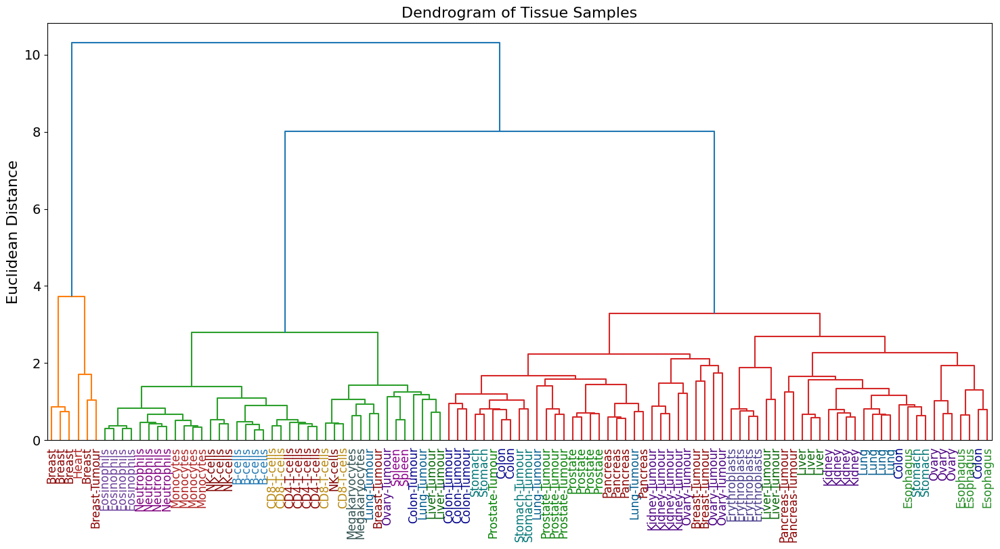

In [44]:
import pandas as pd
import scipy.cluster.hierarchy as sch
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score
from sklearn.metrics import normalized_mutual_info_score
from scipy.cluster.hierarchy import fcluster
from sklearn.metrics import adjusted_rand_score

# Assuming your DataFrame is named 'df'
# Assuming id_tissue_map is your mapping dictionary

tissue_labels = [id_tissue_map.get(sample, 'Unknown') for sample in df.columns]



# Perform hierarchical clustering
# Z = sch.linkage(df.T, method='ward')  # Transpose df to cluster samples

# # Plot dendrogram
# plt.figure(figsize=(20, 10))
# # dendrogram = sch.dendrogram(Z, labels=df.columns, leaf_rotation=90)
# dendrogram = sch.dendrogram(Z, labels=tissue_labels, leaf_rotation=90)

# plt.title("Dendrogram of Tissue Samples")
# plt.ylabel("Euclidean Distance")
# plt.show()


# Perform hierarchical clustering
Z = sch.linkage(df.T, method='ward')  # Transpose df to cluster samples

# Plot dendrogram
plt.figure(figsize=(18, 8))  # Adjusted figure size
dendrogram_data = sch.dendrogram(Z, labels=tissue_labels, leaf_rotation=90)

# Access and adjust the x-axis tick labels
ax = plt.gca()
xticks = ax.get_xticklabels()
for xtick in xticks:
    xtick.set_color(TISSUE_COLOR_MAP3.get(xtick.get_text(), 'black'))  # Default to black if not found
    xtick.set_fontsize(12)  # Increased font size
#     new_label = tissue_id_map.get(xtick.get_text(), xtick.get_text())
    new_label = xtick.get_text()
    xtick.set_text(new_label)
    
    
    
# Increase the size of y-tick labels
yticks = ax.get_yticklabels()
plt.setp(yticks, fontsize=14)

plt.title("Dendrogram of Tissue Samples", fontsize=16)
plt.ylabel("Euclidean Distance", fontsize=16)
# plt.show()





##silhouette score
# Define a cut-off height (this is arbitrary and can be adjusted)
cutoff_height = 10  # Example value, adjust based on dendrogram

# Form flat clusters from the hierarchical clustering defined by the given cut-off
cluster_labels = fcluster(Z, cutoff_height, criterion='distance')

# Map samples to their tissue types
tissue_labels = [id_tissue_map.get(sample, 'Unknown') for sample in df.columns]

# Calculate the silhouette score
score = silhouette_score(df.T, cluster_labels, metric='euclidean')

print(f"Silhouette Score at cut-off height {cutoff_height}: {score}")




#nmi
from sklearn.metrics import normalized_mutual_info_score
from scipy.cluster.hierarchy import fcluster

# Assuming your DataFrame is named 'df'
# Assuming id_tissue_map is your mapping dictionary

# Perform hierarchical clustering
# Z = sch.linkage(df.T, method='ward')  # Transpose df to cluster samples

# Define a cut-off height for clustering (adjust based on dendrogram)
cutoff_height = 10  # Example value

# Form flat clusters from the hierarchical clustering
cluster_labels = fcluster(Z, cutoff_height, criterion='distance')

# Map samples to their tissue types
# tissue_labels = [id_tissue_map.get(sample.split('_')[0], 'Unknown') for sample in df.columns]
tissue_labels = [id_tissue_map.get(sample, 'Unknown') for sample in df.columns]


# Calculate NMI
nmi_score = normalized_mutual_info_score(tissue_labels, cluster_labels)
print(f"Normalized Mutual Information Score: {nmi_score}")

ari_score = adjusted_rand_score(tissue_labels, cluster_labels)
print(f"Adjusted Rand Index Score: {ari_score}")


# clustering_scores['gini'].append(mean_scores_all.loc['Corrected Gini','Mean Score'])
# clustering_scores['shannon_entropy'].append(mean_scores_all.loc['Shannon Entropy','Mean Score'])
# clustering_scores['roku'].append(mean_scores_all.loc['ROKU','Mean Score'])
clustering_scores['silhouette'].append(score)
clustering_scores['nmi'].append(nmi_score)
clustering_scores['ari'].append(ari_score)


# savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/wgbs_atlas/"
# plt.savefig(savedir + f'wgbs_atlas.dendrogram.all_regions.{feature}.png')

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,UKVAC-003-6_Monocytes,UKVAC-001-5_Monocytes,UKVAC-140_Monocytes,UKVAC-049-3_Monocytes,D30_CD34-erythroblasts,D37_CD34-erythroblasts,D66_CD34-erythroblasts,D70_CD34-erythroblasts,D66_CD34-megakaryocytes,D30_CD34-megakaryocytes
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_84789176_84789785,0.857846,0.877231,0.795538,0.831077,0.768385,0.841308,0.826231,0.805000,0.888077,0.829385,...,0.854846,0.863769,0.833538,0.799308,0.833769,0.747231,0.851846,0.650462,0.921308,0.921846
chr16_49560721_49560791,0.770167,0.645333,0.670500,0.594667,0.594500,0.761000,0.827333,0.852167,0.805667,0.883833,...,0.945500,0.955167,0.902833,0.962333,0.668833,0.599333,0.706167,0.666833,0.769667,0.906333
chr12_120217039_120217076,0.790250,0.847500,0.713250,0.659750,0.868500,0.825000,0.834000,0.591750,0.718750,0.662250,...,0.908250,0.961500,0.900000,0.955500,0.583000,0.502000,0.770250,0.916750,0.728500,0.841000
chr17_4550173_4551105,0.889828,0.900690,0.863276,0.766517,0.874069,0.884379,0.837759,0.776862,0.834207,0.825517,...,0.952448,0.957655,0.952138,0.958034,0.848069,0.815862,0.814690,0.802448,0.864621,0.915621
chr3_27560320_27560468,0.881500,0.892000,0.636500,0.327250,0.857250,0.853500,0.777750,0.813750,0.742000,0.857500,...,0.929750,0.876500,0.906250,0.797500,0.794250,0.772500,0.767750,0.623000,0.771500,0.840250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr6_33888461_33889155,0.908909,0.866636,0.773545,0.689545,0.642727,0.777091,0.833364,0.758818,0.732909,0.801909,...,0.933818,0.919182,0.963727,0.933818,0.736364,0.658545,0.685818,0.617273,0.864273,0.831545
chr18_74292688_74295165,0.871385,0.840269,0.830192,0.767500,0.818577,0.826000,0.845385,0.823269,0.844846,0.843654,...,0.929077,0.925808,0.916462,0.927269,0.798654,0.803115,0.824115,0.784615,0.806538,0.875538
chr14_89026309_89026482,0.865300,0.801200,0.789000,0.786800,0.777300,0.827200,0.770200,0.707200,0.762300,0.802500,...,0.945300,0.853500,0.889600,0.927000,0.716300,0.722500,0.735600,0.660100,0.736000,0.775600


In [ ]:
# filename = "Tumour_vs_healthy_background_DMBs.top10000.delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.healthy_high_cov_samples_tissue_DMBs.all_delta_quants0.TAPSbeta_hmm.healthy_high_cov_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"

filename = "TAPSbeta.healthy_high_cov_samples.Tissue_Group_DMBs.top300.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr3/"

selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')


In [9]:
selected_regions

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_27297969_27298503,0.922400,0.862200,0.923800,0.878600,0.944000,0.946600,0.936400,0.940000,0.944400,0.758400,...,0.160550,0.920170,0.759620,0.173650,0.807160,0.633510,1.950060e-43,True,Hypo,B-cells
chr1_161705427_161705933,0.840750,0.754750,0.828125,0.888000,0.951500,0.888125,0.945625,0.909500,0.832000,0.790875,...,0.092719,0.885166,0.792447,0.138750,0.744600,0.605850,4.697406e-35,True,Hypo,B-cells
chr8_38277339_38277521,0.798500,0.794000,0.797750,0.817500,0.815000,0.935500,0.911750,0.905750,0.926000,0.727750,...,0.070375,0.840377,0.770002,0.089500,0.673150,0.583650,1.190996e-31,True,Hypo,B-cells
chr13_99429748_99430115,0.845222,0.757556,0.771333,0.911889,0.909667,0.839778,0.939556,0.856111,0.833111,0.720556,...,0.095056,0.866289,0.771234,0.113167,0.672467,0.559300,8.087414e-29,True,Hypo,B-cells
chr9_123233925_123234191,0.803091,0.751000,0.728545,0.704091,0.921545,0.890455,0.884273,0.897727,0.815909,0.680091,...,0.065659,0.835194,0.769535,0.075364,0.631964,0.556600,1.688950e-27,True,Hypo,B-cells
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr4_2040302_2043017,0.043709,0.046265,0.029676,0.026971,0.030462,0.044324,0.033709,0.032985,0.032531,0.030287,...,0.037278,0.032113,0.005165,0.033630,0.051513,-0.017883,2.918977e-01,False,Hyper,Stomach
chr4_190037296_190038854,0.325056,0.217806,0.150111,0.142861,0.310306,0.151472,0.159194,0.238444,0.217250,0.150306,...,0.252215,0.150296,0.101920,0.241840,0.259750,-0.017910,2.642654e-04,False,Hyper,Stomach
chr22_38453684_38456458,0.022869,0.026393,0.032484,0.029459,0.053881,0.047127,0.050689,0.040143,0.028439,0.025016,...,0.038982,0.032197,0.006785,0.037680,0.055590,-0.017910,2.769400e-01,False,Hyper,Stomach


In [9]:
selected_regions['Hyper_or_Hypo'].value_counts()

Hypo     741545
Hyper     88474
Name: Hyper_or_Hypo, dtype: int64

### Filtering DMBs by significance

In [92]:
sample_grouping = "healthy_high_cov_samples"
# delta_quants = -10
delta_quants = 0
top_n = 0

subset = settings_df.loc[(settings_df['sample_grouping']==sample_grouping)&(settings_df['delta_quants']==delta_quants)&(settings_df['top_n']==top_n)]
# subset = subset.loc[subset['brain']==True]
subset = subset.loc[subset['no_brain']==False]
# subset['savename'].iloc[0]
subset


,no_brain,feature,exp,sample_grouping,filter_name,delta_quants,top_n,savename
2,False,TAPSbeta_hmm.healthy_high_cov_samples.test7_2h...,TAPSbeta,healthy_high_cov_samples,large_blocks_4cpg,0,0,TAPSbeta.healthy_high_cov_samples.Tissue_Group...
7,False,CAPS_hmm.healthy_high_cov_samples.test7_2hidde...,CAPS,healthy_high_cov_samples,large_blocks_4cpg,0,0,CAPS.healthy_high_cov_samples.Tissue_Group_DMB...


In [93]:
# test_name = "test5_2hiddenstates_mincov3_astair_snp_filter"
# test_name = f"test6_2hiddenstates_astair_snp_filter"
# filter_name = "large_blocks_4cpg"
# filter_name = "relaxed_filter_2cpg"
# sample_grouping = list(sample_list_dict.keys())[2]


# Read the CSV file
dmr_dir  = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr11/"
segment_method = "hmm"
top_n = 300

for samples_exp in ['TAPSbeta','CAPS'][0:1]:
#     dmbs = pd.read_csv(dmr_dir + f'{samples_exp}_samples.{samples_exp}_{segment_method}.Filtered_blocks.Grail_filtering_criteria.Top300_block_DMBs.csv', sep='\t')
#     dmbs = pd.read_csv(dmr_dir +  f"{samples_exp}_samples.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top300_block_DMBs.csv", sep='\t')
#     filename = f"{samples_exp}_samples.{sample_grouping}.{samples_exp}_{segment_method}.{sample_grouping}.{test_name}.Filtered_blocks.{filter_name}.Top{top_n}_block_DMBs.csv"
    filename = subset.loc[subset['exp']==samples_exp]['savename'].values[0]
#     filename = f"{exp}.{sample_grouping}.Tissue_Group_DMBs.top{top_n}.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.csv"

    dmbs = pd.read_csv(dmr_dir +  filename,
                       sep='\t',
                      nrows=10000).set_index('chr_start_end')

#     # Set 'chr_start_end' as the index of the DataFrame
#     dmbs.set_index('chr_start_end', inplace=True)
    
#     fig,ax = plot_hypo_hyper_dmr_heatmap(dmbs,
#                                     y_label_tissue_groups=True,
#                                     xticklabel_frequency=1,
# #                                     cmap='Spectral_r',
#                                          cmap="YlGnBu",
#                                          landscape=True,
#                                          figsize=(30,12),
#                                          cbar_shrink=0.5,
#                                          dividing_line_color="white",
#                                          ax1_title=f"{exp_molecule_mapping[samples_exp]} hyper DMBs",
#                                          ax2_title=f"{exp_molecule_mapping[samples_exp]} hypo DMBs",
#                                     )

    
#     savedir = "/well/ludwig/users/dyp502/thesis/thesis_figures/taps_atlas/"
# #     plt.savefig(savedir + f'taps_atlas.DMR_schematic.pancreas.png')
    
#     fig.savefig(savedir + f'taps_atlas.DMR_heatmap.{filename}.png')
    
    

In [104]:
dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,CD565017_Spleen,CD563880_Spleen,...,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue,perm_p_value
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426815,0.938739,0.918565,0.850413,0.780326,0.852348,0.880913,0.901630,0.903348,0.949609,0.941717,...,0.908591,0.772439,0.146217,0.808623,0.662405,1.274622e-36,True,Hypo,Brain,0.00
chr16_19872226_19872443,0.953636,0.872818,0.930545,0.918182,0.924000,0.852727,0.903364,0.902727,0.916091,0.853091,...,0.870608,0.775427,0.100045,0.701491,0.601445,6.498889e-21,True,Hypo,Brain,0.00
chr14_68691272_68691329,0.781000,0.890600,0.885200,0.824000,0.859400,0.920400,0.867800,0.851800,0.874600,0.903800,...,0.862237,0.741037,0.121500,0.712820,0.591320,1.545155e-25,True,Hypo,Brain,0.00
chr18_76979312_76979548,0.870125,0.909500,0.815625,0.829750,0.956313,0.915687,0.914687,0.850938,0.895000,0.910125,...,0.879028,0.691871,0.187203,0.776881,0.589678,5.485431e-30,True,Hypo,Brain,0.00
chr6_14641823_14642266,0.846308,0.914077,0.896077,0.864308,0.885769,0.936308,0.887769,0.883846,0.755385,0.764462,...,0.863330,0.733215,0.140404,0.727688,0.587285,1.994703e-27,True,Hypo,Brain,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr1_5385364_5385423,0.738750,0.721000,0.838000,0.761500,0.718500,0.648750,0.768500,0.646000,0.853000,0.740750,...,0.733457,0.573207,0.171000,0.460100,0.289100,2.325980e-10,True,Hypo,Brain,0.98
chr1_153873063_153875483,0.825905,0.815524,0.750905,0.680238,0.803857,0.763619,0.795429,0.810190,0.858000,0.799857,...,0.812665,0.433951,0.379310,0.668410,0.289100,2.568993e-11,True,Hypo,Brain,0.32
chr20_38761757_38763118,0.916875,0.935250,0.922625,0.859125,0.905875,0.921125,0.973000,0.905500,0.884250,0.900750,...,0.887870,0.396682,0.501781,0.790881,0.289100,9.599891e-17,True,Hypo,Brain,0.00


In [122]:
filename = "TAPSbeta.healthy_high_cov_samples.Tissue_Group_DMBs.all_delta_quants0.TAPSbeta_hmm.healthy_high_cov_samples.test7_2hiddenstates_mincov3_snp_reindex.Filtered_blocks.large_blocks_4cpg.ADD_perm_delta_quants.csv"
file_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/permutation_test/results/"
df = pd.read_csv(file_dir + filename,
                sep='\t'
                ,nrows=100000)



In [123]:
df['significant_perm_pval'] = df['perm_pvals']<0.05
selected_regions = df

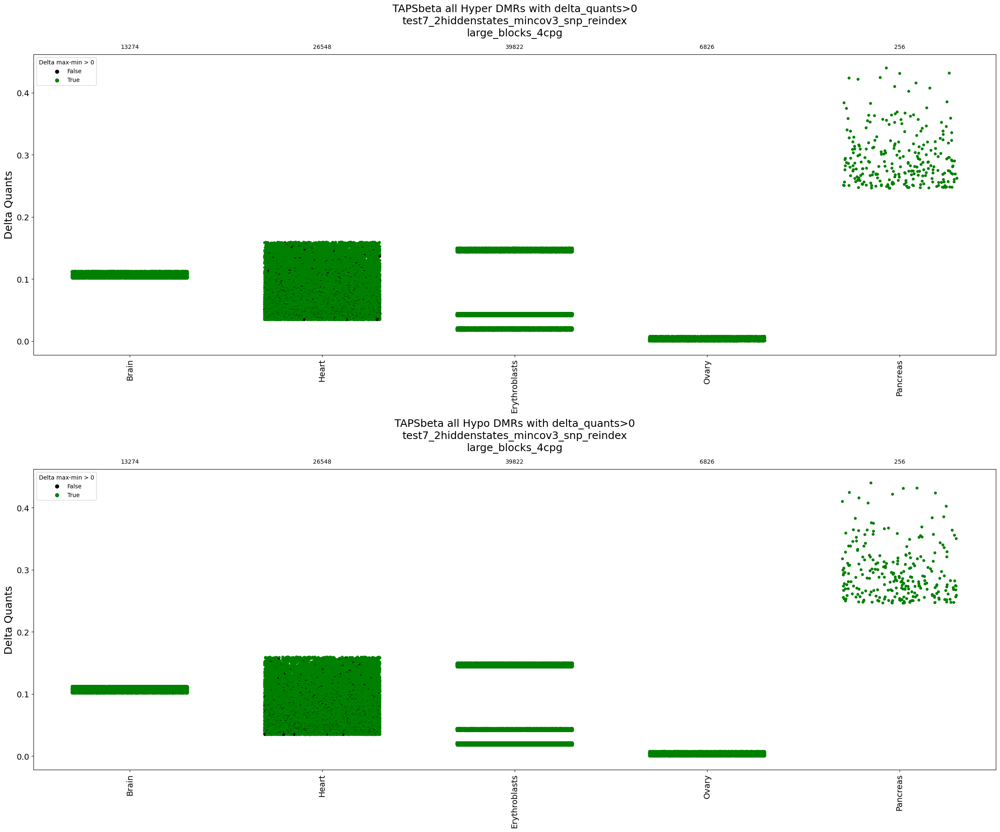

In [124]:
fig, axes = plt.subplots(2, 1, figsize=(24, 20))

# Define the custom color palette
custom_palette = {True: 'green', False: 'black'}

for ax, hyper_or_hypo in zip(axes, ["Hyper", "Hypo"]):
    df_sub = selected_regions.loc[selected_regions['Hyper_or_Hypo'] == "Hypo"]

    # Use the custom palette in the stripplot
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_perm_pval', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax, palette=custom_palette)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    ax.legend_.set_title("Delta max-min > 0")
    
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')

plt.tight_layout()
plt.show()

In [52]:
from joblib import load
filename = "Delta_quants_permutations_dict_Attempt3.Part_0.4_target_samples.TAPSbeta.healthy_high_cov_samples.Tissue_Group_DMBs.all_delta_quants0.pkl"
permutation_test_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/permutation_test/"
# # with open(permutation_test_dir + filename, 'rb') as file:
#     permutations_dict = pickle.load(file)


permutations_dict = load(permutation_test_dir + filename)


In [97]:
import numpy as np

def calculate_p_value(observed_stat, permutations):
    """
    Calculate the p-value for the observed test statistic based on the permutation distribution.

    Parameters:
    observed_stat (float): The observed test statistic.
    permutations (np.array): Array of test statistics from permutations.

    Returns:
    float: The p-value.
    """
    # Count how many permutations have a test statistic at least as extreme as the observed
    extreme_count = np.sum(np.abs(permutations) >= np.abs(observed_stat))

    # Calculate p-value
    p_value = extreme_count / len(permutations)

    return p_value

# Example usage
observed_stat = 0.3  
permutations = permutations_dict["chr16_72425131_72426815"]
p_value = calculate_p_value(observed_stat, permutations)

print(f"P-value: {p_value}")


P-value: 0.154


In [101]:

def calculate_p_value(observed_stat, permutations):
    extreme_count = np.sum(np.abs(permutations) >= np.abs(observed_stat))
    p_value = extreme_count / len(permutations)
    return p_value

# Apply the p-value calculation to each row of the DataFrame
dmbs['perm_p_value'] = dmbs.apply(lambda row: calculate_p_value(row['delta_quants'], permutations_dict[row.name]), axis=1)


<Axes: >

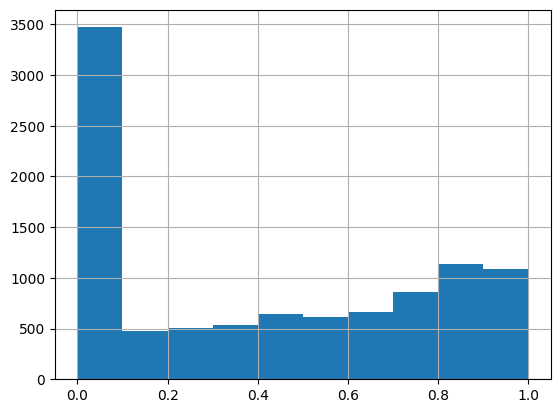

In [103]:
dmbs['perm_p_value'].hist()

In [ ]:
def get_permute_pvalue(row):
    
    observed_stat = row['delta_quants']
    
    permutations = permutations_dict[row.index]
    p_value = calculate_p_value(observed_stat, permutations)

In [56]:
permutations_dict.keys()

dict_keys(['chr16_72425131_72426815', 'chr16_19872226_19872443', 'chr14_68691272_68691329', 'chr18_76979312_76979548', 'chr6_14641823_14642266', 'chr9_94084441_94086402', 'chr6_163137122_163137712', 'chr21_32334908_32335957', 'chr10_129896223_129896528', 'chr11_121022500_121022795', 'chr12_122848264_122848730', 'chr15_28935746_28936567', 'chr6_161256176_161256467', 'chr2_95312750_95312937', 'chr8_130109142_130109802', 'chr2_95312971_95313517', 'chr11_45902785_45903125', 'chr18_79250174_79250882', 'chr3_183819080_183819436', 'chr6_108799428_108800192', 'chr13_67225877_67226142', 'chr1_44015274_44018098', 'chr7_1610643_1610896', 'chr2_238586223_238586338', 'chr18_10463533_10464128', 'chr18_76989514_76990361', 'chr7_6158533_6159659', 'chr8_25685500_25685719', 'chr18_76997397_76998752', 'chr6_166423142_166424076', 'chr7_102079889_102080454', 'chr3_12942596_12943381', 'chr2_241869695_241869809', 'chr10_639821_640047', 'chr10_104033943_104034192', 'chr8_60867054_60867645', 'chr6_157941328_15

In [95]:
permutations_dict["chr16_72425131_72426815"]

array([-0.11979348, -0.25180326, -0.26345543, -0.30500435, -0.292825  ,
       -0.30963478, -0.27425435, -0.2922    , -0.27000978, -0.25741739,
       -0.27491196, -0.27562391, -0.26436848, -0.24789022, -0.3003087 ,
       -0.25747717, -0.23608587, -0.29017283, -0.30786304, -0.2722    ,
       -0.30236848, -0.2940587 , -0.30141739, -0.30120543, -0.11489674,
       -0.26381957, -0.2892    , -0.24036304, -0.25156413, -0.29695543,
       -0.23160217, -0.297575  , -0.30858043, -0.27805326, -0.27542283,
       -0.2991837 , -0.25948261, -0.24655326, -0.30003696, -0.273325  ,
       -0.27215109, -0.29802609, -0.27864022, -0.30588478, -0.292825  ,
       -0.25689565, -0.27097717, -0.28956957, -0.3145587 , -0.14466304,
       -0.29890652, -0.10404891, -0.30336304, -0.27000978, -0.23369457,
       -0.30031413, -0.24892283, -0.28873804, -0.25354783, -0.29545543,
       -0.26406413, -0.25479239, -0.31561848, -0.29246087, -0.23947717,
       -0.2497163 , -0.08148913, -0.28846087, -0.28873804, -0.24

(array([142., 151., 114.,  38.,   6.,   1.,  13.,  12.,  15.,   8.]),
 array([-0.31809674, -0.29372076, -0.26934478, -0.2449688 , -0.22059283,
        -0.19621685, -0.17184087, -0.14746489, -0.12308891, -0.09871293,
        -0.07433696]),
 <BarContainer object of 10 artists>)

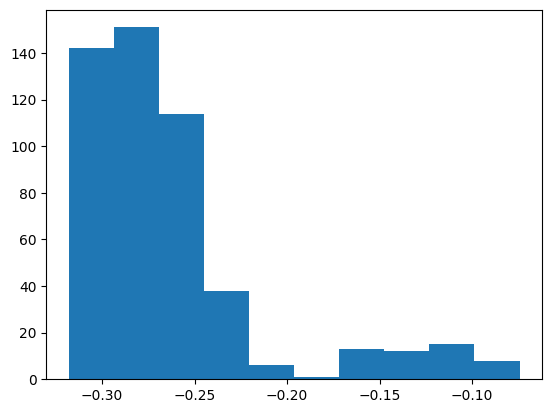

In [72]:
plt.hist(permutations_dict["chr16_72425131_72426815"])

In [42]:
permutations_dict.keys()

dict_keys(['chr5_165949632_165950261', 'chr14_59721991_59722751', 'chr1_172646055_172646648', 'chr7_89750478_89752930', 'chr4_188076339_188077490', 'chr7_106724054_106727249', 'chr8_66990943_66993633', 'chr10_24189190_24190514', 'chr1_17866666_17867961', 'chr3_166026634_166027381', 'chr11_7457307_7461968', 'chr11_116475222_116476126', 'chr1_115847813_115849087', 'chr3_156200961_156201681', 'chr14_84417264_84417905', 'chr4_23426350_23427639', 'chr8_1003242_1003367', 'chr5_127476154_127477863', 'chr5_163266226_163266353', 'chr4_112080289_112083112', 'chr10_98100944_98104176', 'chr8_23351338_23352031', 'chr19_53243499_53247258', 'chr2_141434537_141437687', 'chr2_167380715_167382740', 'chr17_12628855_12629552', 'chr1_224558946_224563337', 'chr15_94614539_94615232', 'chr10_105174982_105176650', 'chr2_31024403_31026119', 'chr12_46212569_46214390', 'chr16_9502968_9504906', 'chr20_23990326_23992290', 'chr18_42826456_42828724', 'chr9_82521892_82525254', 'chr11_109789991_109790726', 'chr11_13601

### Visualise DMB heatmap

In [31]:
sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/tissue_atlas_codebase/')
from dmr_functions import grail_find_markers_copy, get_grail_dmrs, plot_hypo_hyper_dmr_heatmap, get_tissue_labels_positions


In [9]:
# filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
# dmbs = pd.read_csv(dmr_dir + filename).set_index("chr_start_end")



In [10]:
# Group by 'selected_tissue' and sort within each group by 'delta_quants'
grouped = selected_regions.groupby('selected_tissue', group_keys=False)

# Apply a lambda function to each group to sort and select the top 1000
top_1000_dmrs_per_tissue = grouped.apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))


In [11]:
top_1000_dmrs_per_tissue

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426403,0.945974,0.927684,0.844711,0.781053,0.898553,0.895395,0.884158,0.890368,0.927605,0.919026,...,0.223632,0.893742,0.670110,0.252224,0.718413,0.466189,4.663773e-10,True,Hypo,Brain-Tumour
chr18_78562383_78562484,0.856600,0.908000,0.849800,0.907400,0.811000,0.696600,0.909400,0.840600,0.920400,0.895600,...,0.135400,0.814792,0.679392,0.146000,0.558780,0.412780,9.052029e-09,True,Hypo,Brain-Tumour
chr2_130869703_130869964,0.911818,0.869727,0.851909,0.820455,0.805727,0.871182,0.723364,0.827455,0.803455,0.811273,...,0.171909,0.831701,0.659792,0.195136,0.601736,0.406600,9.075886e-10,True,Hypo,Brain-Tumour
chr6_122717838_122717952,0.853750,0.723500,0.716500,0.664250,0.844750,0.687750,0.866000,0.768500,0.863250,0.789250,...,0.130250,0.774987,0.644737,0.144000,0.541325,0.397325,1.384596e-10,True,Hypo,Brain-Tumour
chr5_103499087_103499290,0.859500,0.827250,0.837000,0.706000,0.909750,0.832750,0.772000,0.723000,0.843500,0.770000,...,0.210875,0.816532,0.605657,0.217938,0.598875,0.380938,8.462509e-09,True,Hypo,Brain-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr1_10024715_10025154,0.768500,0.858333,0.790667,0.708167,0.554000,0.518500,0.771333,0.703667,0.744667,0.696667,...,0.536250,0.813100,0.276850,0.545125,0.664250,0.119125,3.043507e-06,False,Hypo,Stomach-Tumour
chr8_142874943_142875394,0.758222,0.797889,0.800833,0.751611,0.565722,0.563500,0.786556,0.776778,0.856778,0.821056,...,0.564611,0.818647,0.254036,0.565167,0.684289,0.119122,2.653091e-06,False,Hypo,Stomach-Tumour
chr9_130904013_130904702,0.880524,0.885381,0.837929,0.760452,0.548024,0.631381,0.825000,0.852786,0.838857,0.851738,...,0.589702,0.844933,0.255231,0.610542,0.729652,0.119111,5.125505e-07,True,Hypo,Stomach-Tumour


In [12]:
filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.healthy_high_cov_samples_tissue_DMBs.all_delta_quants0.TAPSbeta_hmm.healthy_high_cov_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"


dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"


dmbs = top_1000_dmrs_per_tissue

# Split the data into hyper and hypo
hyper_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hyper'].dropna()
hypo_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hypo'].dropna()



# Drop the non-numeric columns
hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

tissue_sample_order = []
# for tissue in dmbs[sample_grouping]:
for tissue in list(dmbs['selected_tissue'].unique()):
    tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in hyper_dmbs.columns])


# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))

# Plot the heatmaps 
sns.heatmap(hyper_df[tissue_sample_order], cmap='flare_r', ax=axs[0])
axs[0].set_title('Hyper DMRs')

sns.heatmap(hypo_df[tissue_sample_order], cmap='flare_r', ax=axs[1])
axs[1].set_title('Hypo DMRs')

# Show the plot
plt.tight_layout()
plt.show()


NameError: name 'top_1000_dmrs_per_tissue' is not defined

In [16]:
selected_regions

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr2_32277470_32277629,0.058500,0.038000,0.190750,0.075250,0.000000,0.000000,0.092500,0.145250,0.05000,0.057250,...,0.000000,0.087438,0.087438,0.000000,0.011525,0.011525,0.044824,False,Hypo,Stomach-Tumour
chr22_21954820_21955079,0.054600,0.026400,0.053400,0.045800,0.000000,0.000000,0.033800,0.082600,0.04340,0.039600,...,0.000000,0.049145,0.049145,0.000000,0.007400,0.007400,0.061918,False,Hypo,Stomach-Tumour
chr9_125964931_125965174,0.036750,0.097500,0.050750,0.194500,0.000000,0.000000,0.114500,0.116000,0.04500,0.082250,...,0.000000,0.064714,0.064714,0.000000,0.007175,0.007175,0.153763,False,Hypo,Stomach-Tumour
chr22_29597346_29598019,0.047500,0.053333,0.071667,0.155333,0.013833,0.012167,0.073000,0.131500,0.11200,0.128167,...,0.013000,0.074853,0.061853,0.013417,0.020583,0.007167,0.058001,False,Hypo,Stomach-Tumour
chr8_102307003_102308287,0.021800,0.031600,0.124800,0.143600,0.000000,0.000000,0.075800,0.118400,0.04920,0.040200,...,0.000000,0.058784,0.058784,0.000000,0.006660,0.006660,0.121606,False,Hypo,Stomach-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr1_175319762_175320136,0.000000,0.006750,0.000000,0.014750,0.017750,0.000000,0.035250,0.000000,0.02125,0.037250,...,0.050125,0.009477,0.040648,0.037562,0.037525,0.000038,0.000016,True,Hyper,Brain-Tumour
chr13_71909596_71909940,0.005429,0.023857,0.004429,0.027714,0.004714,0.000000,0.018429,0.009286,0.02500,0.008286,...,0.048786,0.009143,0.039643,0.044536,0.044500,0.000036,0.000010,True,Hyper,Brain-Tumour
chr6_24157841_24158451,0.026000,0.013500,0.075500,0.118000,0.000000,0.008250,0.033750,0.015750,0.02450,0.030750,...,0.111250,0.026584,0.084666,0.100250,0.100225,0.000025,0.000414,False,Hyper,Brain-Tumour


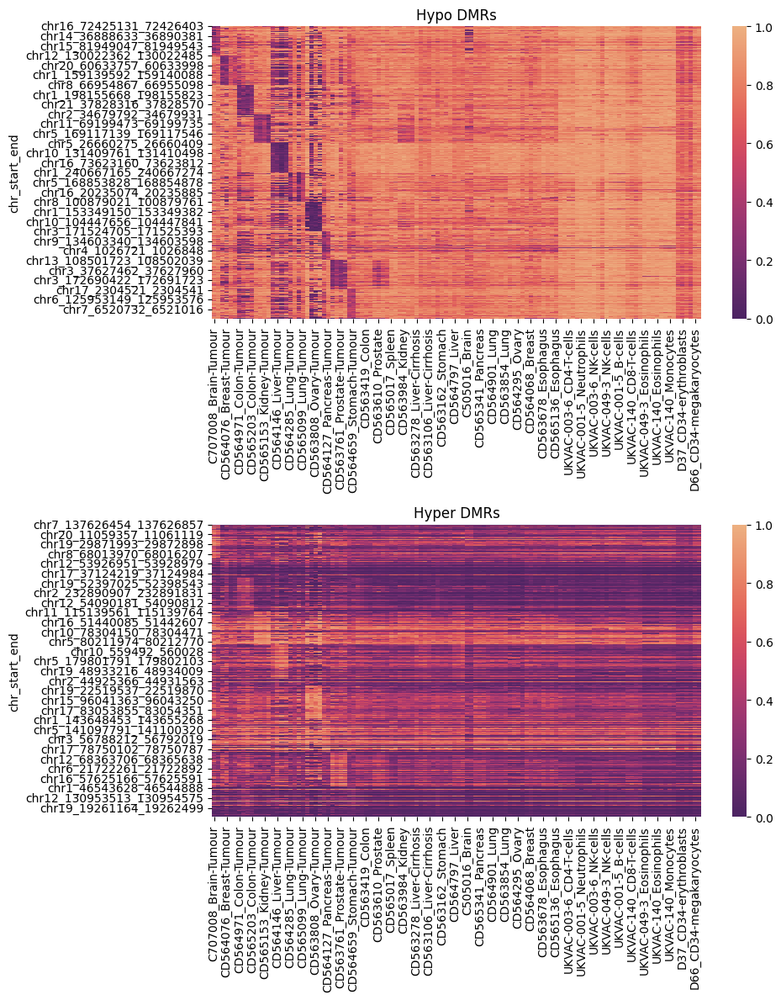

In [25]:
### Take top 1000 hyper DMBs AND top 1000 hypo DMBs

filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.healthy_high_cov_samples_tissue_DMBs.all_delta_quants0.TAPSbeta_hmm.healthy_high_cov_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))
hyper_or_hypo = 'Hyper'
for k,hyper_or_hypo in enumerate(['Hypo','Hyper']):
    dmbs = selected_regions.loc[selected_regions['Hyper_or_Hypo']==hyper_or_hypo].dropna()
    top_n_dmbs = dmbs.groupby('selected_tissue', group_keys=False).apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))


    # # Drop the non-numeric columns
    # hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
    # hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

    tissue_sample_order = []
    # for tissue in dmbs[sample_grouping]:
    for tissue in list(top_n_dmbs['selected_tissue'].unique()):
        tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in top_n_dmbs.columns])

    tissue_sample_order += [u for u in top_n_dmbs.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]



    # Plot the heatmaps 
    sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[k])
    axs[k].set_title(f'{hyper_or_hypo} DMRs')

# sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[1])
# axs[1].set_title('Hypo DMRs')

# Show the plot
plt.tight_layout()
plt.show()


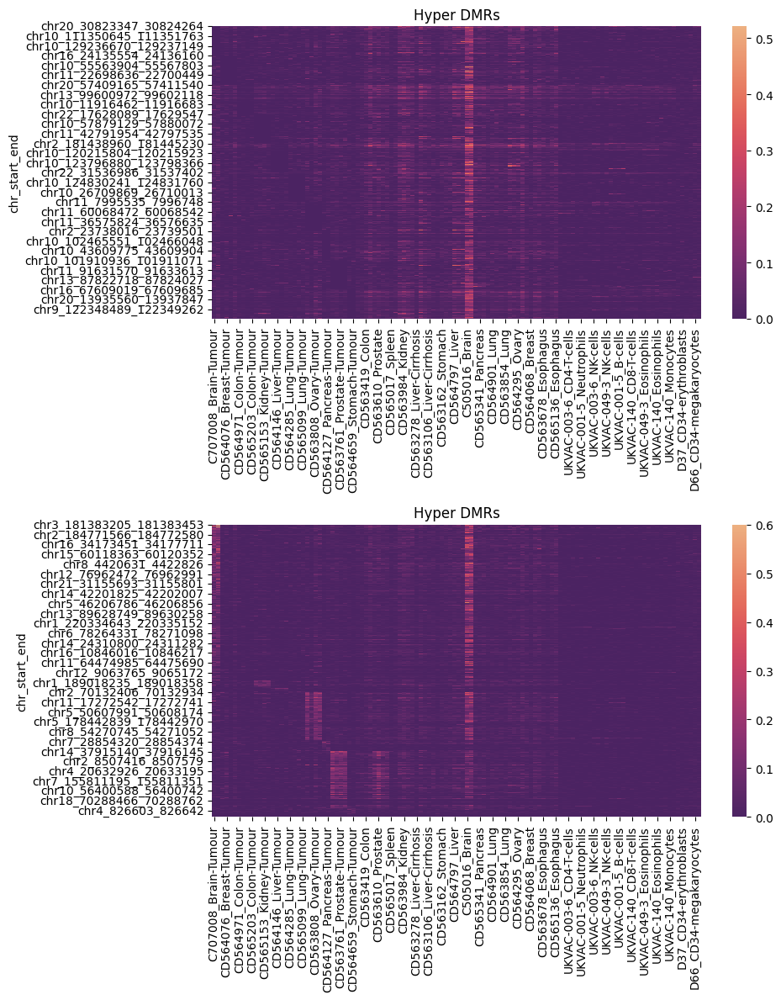

In [24]:
### Take top 1000 hyper DMBs AND top 1000 hypo DMBs

filename = "CAPS.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.CAPS_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"

### Take top 1000 hyper DMBs AND top 1000 hypo DMBs
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

hyper_or_hypo = 'Hyper'
# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))
for k,hyper_or_hypo in enumerate(['Hypo','Hyper']):
    dmbs = selected_regions.loc[selected_regions['Hyper_or_Hypo']==hyper_or_hypo].dropna()
    top_n_dmbs = dmbs.groupby('selected_tissue', group_keys=False).apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))


    # # Drop the non-numeric columns
    # hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
    # hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

    tissue_sample_order = []
    # for tissue in dmbs[sample_grouping]:
    for tissue in list(top_n_dmbs['selected_tissue'].unique()):
        tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in top_n_dmbs.columns])

    tissue_sample_order += [u for u in top_n_dmbs.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]



    # Plot the heatmaps 
    sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[k])
    axs[k].set_title('Hyper DMRs')

# sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[1])
# axs[1].set_title('Hypo DMRs')

# Show the plot
plt.tight_layout()
plt.show()


### Repeat with brain removed from 'rest'

In [35]:
top_n_dmbs[tissue_sample_order + ['Hyper_or_Hypo','selected_tissue']]

,C707008_Brain-Tumour,C707009_Brain-Tumour,CD564575_Breast-Tumour,CD564076_Breast-Tumour,CD563503_Breast-Tumour,CD565056_Breast-Tumour,CD564971_Colon-Tumour,CD563649_Colon-Tumour,CD564145_Colon-Tumour,CD565203_Colon-Tumour,...,UKVAC-140_Monocytes,UKVAC-049-3_Monocytes,D30_CD34-erythroblasts,D37_CD34-erythroblasts,D66_CD34-erythroblasts,D70_CD34-erythroblasts,D66_CD34-megakaryocytes,D30_CD34-megakaryocytes,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr3_181383205_181383453,0.177750,0.260250,0.009250,0.008000,0.000000,0.029250,0.000000,0.006000,0.000000,0.000000,...,0.000000,0.000000,0.007250,0.000000,0.000000,0.000000,0.007000,0.007750,Hyper,Brain-Tumour
chr5_88091313_88092375,0.262000,0.192000,0.000000,0.024750,0.007500,0.014500,0.007250,0.007500,0.000000,0.016750,...,0.000000,0.000000,0.017750,0.000000,0.010500,0.010500,0.016500,0.018250,Hyper,Brain-Tumour
chr6_113179534_113180437,0.073250,0.562500,0.000000,0.036750,0.000000,0.050250,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.010750,0.017500,0.012500,0.000000,0.000000,0.015000,Hyper,Brain-Tumour
chr12_77953583_77954948,0.083600,0.600000,0.015400,0.013000,0.005800,0.053800,0.021200,0.014200,0.000000,0.000000,...,0.009000,0.000000,0.008400,0.010600,0.011000,0.010000,0.000000,0.012600,Hyper,Brain-Tumour
chr12_106671284_106671809,0.232500,0.135250,0.000000,0.021750,0.008000,0.006500,0.009000,0.000000,0.000000,0.009000,...,0.009500,0.000000,0.006750,0.010250,0.000000,0.000000,0.015500,0.000000,Hyper,Brain-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr10_931483_932255,0.001981,0.003368,0.002943,0.002179,0.001538,0.000698,0.002877,0.001821,0.000472,0.000377,...,0.002660,0.002679,0.001925,0.001962,0.001594,0.001104,0.002387,0.002208,Hyper,Stomach-Tumour
chr7_40432577_40433201,0.008250,0.052500,0.000000,0.000000,0.000000,0.000000,0.010500,0.000000,0.000000,0.000000,...,0.000000,0.010500,0.009500,0.020000,0.000000,0.012000,0.000000,0.006000,Hyper,Stomach-Tumour
chr19_47274359_47274529,0.002118,0.002294,0.003647,0.002647,0.000000,0.001588,0.000000,0.000000,0.002235,0.002353,...,0.010235,0.000000,0.000941,0.002235,0.001000,0.003235,0.002000,0.000000,Hyper,Stomach-Tumour


In [36]:
top_n_dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr3_181383205_181383453,0.029000,0.008000,0.053000,0.044500,0.000000,0.000000,0.034000,0.045750,0.019250,0.000000,...,0.219000,0.013733,0.205267,0.198375,0.047475,0.150900,1.407085e-20,True,Hyper,Brain-Tumour
chr5_88091313_88092375,0.008250,0.011250,0.015500,0.040250,0.000000,0.000000,0.064500,0.012500,0.025000,0.000000,...,0.227000,0.013747,0.213253,0.209500,0.062587,0.146913,5.696515e-20,True,Hyper,Brain-Tumour
chr6_113179534_113180437,0.009000,0.036500,0.068000,0.068000,0.000000,0.000000,0.014750,0.052000,0.025750,0.018500,...,0.317875,0.019523,0.298352,0.195563,0.075837,0.119725,2.861856e-13,True,Hyper,Brain-Tumour
chr12_77953583_77954948,0.031800,0.020800,0.086400,0.149000,0.007600,0.000000,0.044000,0.078600,0.043600,0.072000,...,0.341800,0.027792,0.314008,0.212700,0.094160,0.118540,2.312679e-12,True,Hyper,Brain-Tumour
chr12_106671284_106671809,0.010000,0.013500,0.013250,0.056000,0.000000,0.000000,0.042750,0.050000,0.026500,0.023500,...,0.183875,0.018303,0.165572,0.159562,0.056562,0.103000,2.098185e-18,True,Hyper,Brain-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr10_931483_932255,0.002509,0.002434,0.001028,0.001896,0.003991,0.003264,0.002170,0.002972,0.001283,0.001953,...,0.003627,0.001991,0.001636,0.003446,0.003325,0.000120,5.721494e-03,False,Hyper,Stomach-Tumour
chr7_40432577_40433201,0.000000,0.005500,0.020250,0.009250,0.027750,0.059500,0.000000,0.000000,0.006750,0.000000,...,0.043625,0.006577,0.037048,0.035687,0.035575,0.000112,7.571068e-06,True,Hyper,Stomach-Tumour
chr19_47274359_47274529,0.001941,0.000000,0.002118,0.004824,0.014000,0.008647,0.002824,0.009824,0.004647,0.003529,...,0.011324,0.002299,0.009025,0.009985,0.009885,0.000100,2.357353e-04,True,Hyper,Stomach-Tumour


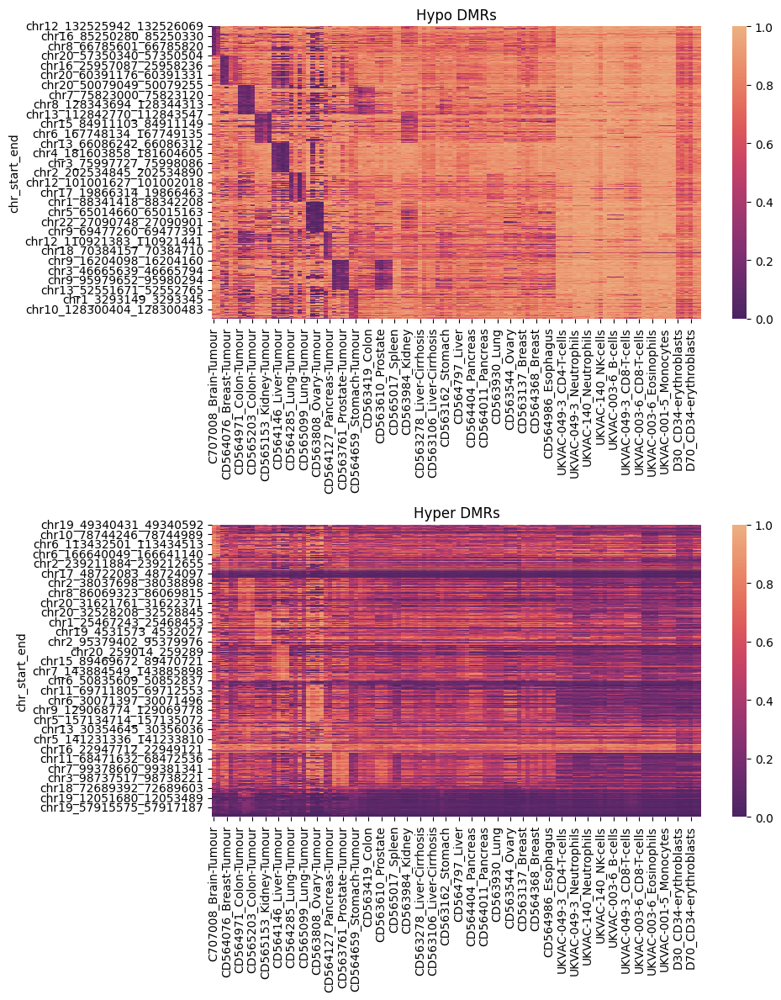

In [37]:
### Take top 1000 hyper DMBs AND top 1000 hypo DMBs

filename = "TAPSbeta_NOBRAIN.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# filename = "TAPSbeta.healthy_high_cov_samples_tissue_DMBs.all_delta_quants0.TAPSbeta_hmm.healthy_high_cov_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))
hyper_or_hypo = 'Hyper'
for k,hyper_or_hypo in enumerate(['Hypo','Hyper']):
    dmbs = selected_regions.loc[selected_regions['Hyper_or_Hypo']==hyper_or_hypo].dropna()
#     top_n_dmbs = dmbs.groupby('selected_tissue', group_keys=False).apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))
    top_n_dmbs = dmbs.groupby('selected_tissue', group_keys=False).apply(lambda x: x.sort_values('delta_means', ascending=False).head(1000))

    # # Drop the non-numeric columns
    # hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
    # hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

    tissue_sample_order = []
    # for tissue in dmbs[sample_grouping]:
    for tissue in list(top_n_dmbs['selected_tissue'].unique()):
        tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in top_n_dmbs.columns])

    tissue_sample_order += [u for u in top_n_dmbs.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]



    # Plot the heatmaps 
    sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[k])
    axs[k].set_title(f'{hyper_or_hypo} DMRs')

# sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[1])
# axs[1].set_title('Hypo DMRs')

# Show the plot
plt.tight_layout()
plt.show()


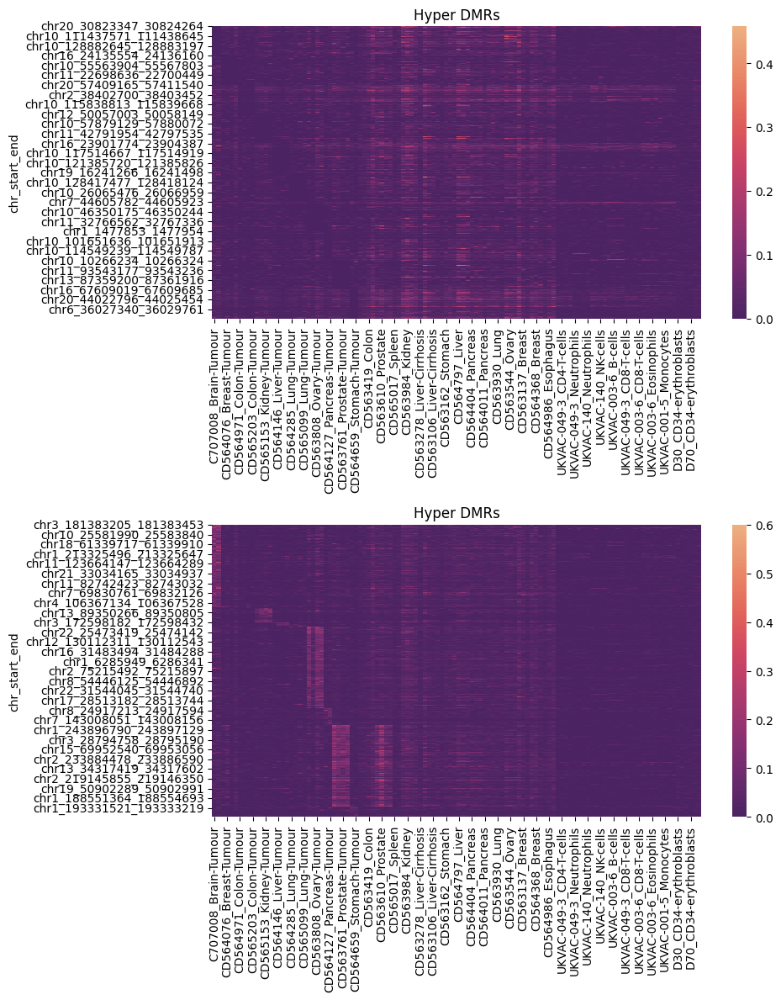

In [27]:
### Take top 1000 hyper DMBs AND top 1000 hypo DMBs

filename = "CAPS_NOBRAIN.Tumour_vs_healthy_background_DMBs.all_samples.all_delta_quants0.CAPS_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"

### Take top 1000 hyper DMBs AND top 1000 hypo DMBs
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

hyper_or_hypo = 'Hyper'
# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))
for k,hyper_or_hypo in enumerate(['Hypo','Hyper']):
    dmbs = selected_regions.loc[selected_regions['Hyper_or_Hypo']==hyper_or_hypo].dropna()
    top_n_dmbs = dmbs.groupby('selected_tissue', group_keys=False).apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))


    # # Drop the non-numeric columns
    # hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
    # hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

    tissue_sample_order = []
    # for tissue in dmbs[sample_grouping]:
    for tissue in list(top_n_dmbs['selected_tissue'].unique()):
        tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in top_n_dmbs.columns])

    tissue_sample_order += [u for u in top_n_dmbs.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]



    # Plot the heatmaps 
    sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[k])
    axs[k].set_title('Hyper DMRs')

# sns.heatmap(top_n_dmbs[tissue_sample_order], cmap='flare_r', ax=axs[1])
# axs[1].set_title('Hypo DMRs')

# Show the plot
plt.tight_layout()
plt.show()


### Get top 1000 tumour vs rest healthy for TAPS and CAPS

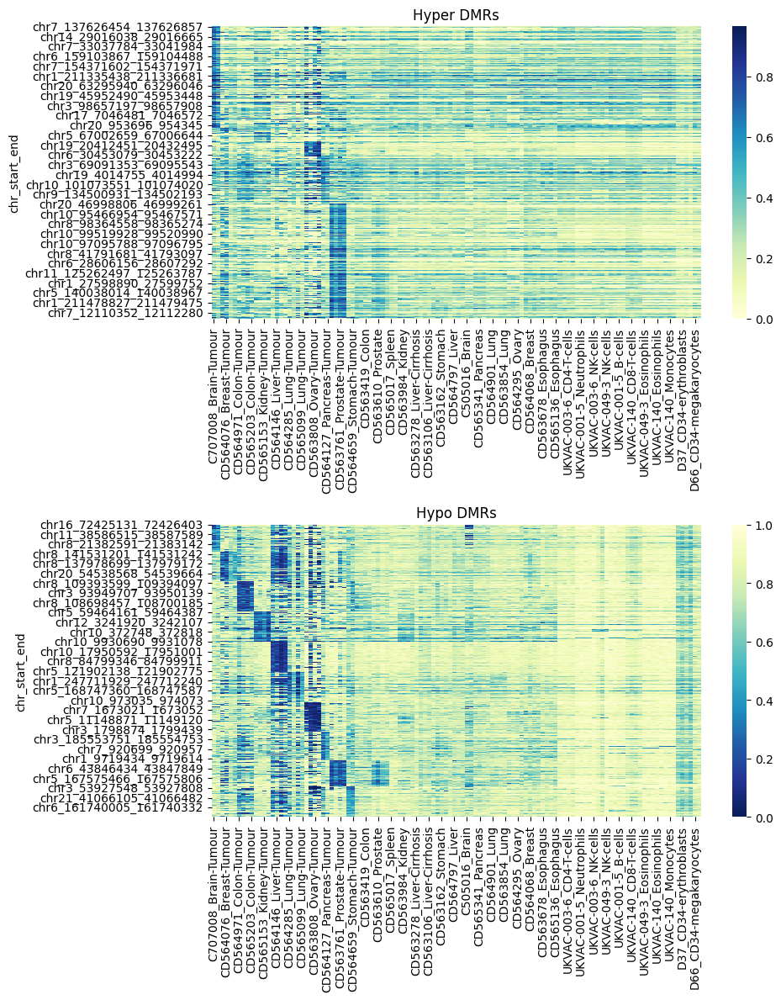

In [55]:
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"


selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

# Group by 'selected_tissue' and sort within each group by 'delta_quants'
grouped = selected_regions.groupby('selected_tissue', group_keys=False)

# Apply a lambda function to each group to sort and select the top 1000
top_1000_dmrs_per_tissue = grouped.apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))




dmbs = top_1000_dmrs_per_tissue

# Split the data into hyper and hypo
hyper_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hyper'].dropna()
hypo_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hypo'].dropna()

# Drop the non-numeric columns
hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

# tissue_sample_order = []
# # for tissue in dmbs[sample_grouping]:
# for tissue in list(dmbs['selected_tissue'].unique()):
#     tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in hyper_dmbs.columns])


# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))

tissue_sample_order = []
for tissue in list(dmbs['selected_tissue'].unique()):
    tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in hyper_dmbs.columns])

tissue_sample_order += [u for u in hyper_df.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]
## Plot the heatmaps 
sns.heatmap(hyper_df[tissue_sample_order], cmap='YlGnBu', ax=axs[0])
axs[0].set_title('Hyper DMRs')

sns.heatmap(hypo_df[tissue_sample_order], cmap='YlGnBu_r', ax=axs[1])
axs[1].set_title('Hypo DMRs')


# Show the plot
plt.tight_layout()
plt.show()



# dmr_testing_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/dmr_testing/"
# savename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.top1000_delta_quants.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# top_1000_dmrs_per_tissue.to_csv(dmr_testing_dir +savename,
#                                sep='\t')


['C707008_Brain-Tumour', 'C707009_Brain-Tumour', 'CD564575_Breast-Tumour', 'CD564076_Breast-Tumour', 'CD563503_Breast-Tumour', 'CD565056_Breast-Tumour', 'CD564971_Colon-Tumour', 'CD563649_Colon-Tumour', 'CD564145_Colon-Tumour', 'CD565203_Colon-Tumour', 'CD564876_Kidney-Tumour', 'CD564953_Kidney-Tumour', 'CD565153_Kidney-Tumour', 'CD563857_Kidney-Tumour', 'CD564208_Liver-Tumour', 'CD564146_Liver-Tumour', 'CD563176_Liver-Tumour', 'CD564934_Liver-Tumour', 'CD564285_Lung-Tumour', 'CD564572_Lung-Tumour', 'CD565285_Lung-Tumour', 'CD565099_Lung-Tumour', 'CD565018_Ovary-Tumour', 'CD565088_Ovary-Tumour', 'CD563808_Ovary-Tumour', 'CD564888_Ovary-Tumour', 'CD564422_Pancreas-Tumour', 'CD564127_Pancreas-Tumour', 'CD564980_Prostate-Tumour', 'CD563882_Prostate-Tumour', 'CD563761_Prostate-Tumour', 'CD564414_Prostate-Tumour', 'CD564588_Stomach-Tumour', 'CD564659_Stomach-Tumour']
['C707008_Brain-Tumour', 'C707009_Brain-Tumour', 'CD564575_Breast-Tumour', 'CD564076_Breast-Tumour', 'CD563503_Breast-Tumour'

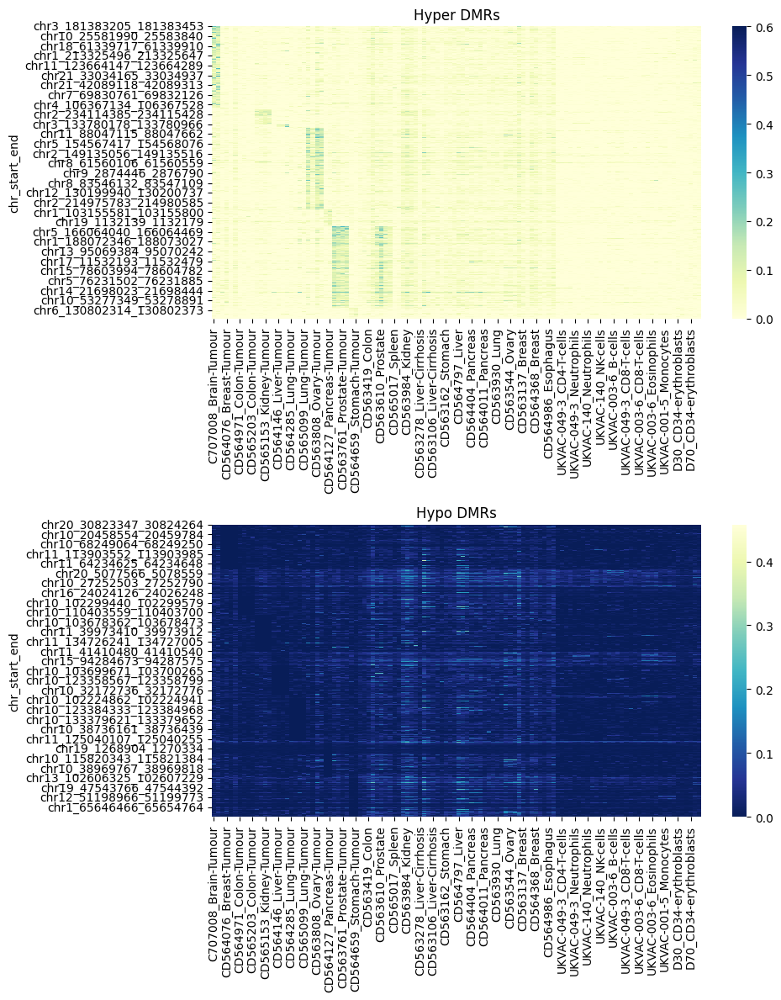

In [54]:
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
filename = "CAPS_nobrain.Tumour_vs_healthy_background_DMBs.all_delta_quants0.CAPS_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"


selected_regions = pd.read_csv(dmr_dir + filename,
#                               nrows=100000,\
                              ).set_index('chr_start_end')

# Group by 'selected_tissue' and sort within each group by 'delta_quants'
grouped = selected_regions.groupby('selected_tissue', group_keys=False)

# Apply a lambda function to each group to sort and select the top 1000
top_1000_dmrs_per_tissue = grouped.apply(lambda x: x.sort_values('delta_quants', ascending=False).head(1000))




dmbs = top_1000_dmrs_per_tissue

# Split the data into hyper and hypo
hyper_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hyper'].dropna()
hypo_dmbs = dmbs.loc[dmbs['Hyper_or_Hypo']=='Hypo'].dropna()

# Drop the non-numeric columns
hyper_df = hyper_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])
hypo_df = hypo_dmbs.drop(columns=['delta_maxmin', 'tg_mean', 'bg_mean', 'delta_means', 'tg_quant', 'bg_quant', 'delta_quants', 'Hyper_or_Hypo', 'selected_tissue'])

# tissue_sample_order = []
# # for tissue in dmbs[sample_grouping]:
# for tissue in list(dmbs['selected_tissue'].unique()):
#     tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in hyper_dmbs.columns])


# Create two subplots
fig, axs = plt.subplots(2, 1, figsize=(10, 12))

tissue_sample_order = []
for tissue in list(dmbs['selected_tissue'].unique()):
    tissue_sample_order.extend([u for u in tissue_id_map[tissue] if u in hyper_dmbs.columns])

tissue_sample_order += [u for u in hyper_df.columns if (u in id_tissue_map.keys()) and (u not in tissue_sample_order)]
## Plot the heatmaps 
sns.heatmap(hyper_df[tissue_sample_order], cmap='YlGnBu', ax=axs[0])
axs[0].set_title('Hyper DMRs')

sns.heatmap(hypo_df[tissue_sample_order], cmap='YlGnBu_r', ax=axs[1])
axs[1].set_title('Hypo DMRs')


# Show the plot
plt.tight_layout()
plt.show()




# dmr_testing_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/dmr_testing/"
# savename = "CAPS.Tumour_vs_healthy_background_DMBs.top1000_delta_quants.CAPS_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
# top_1000_dmrs_per_tissue.to_csv(dmr_testing_dir +savename,
#                                sep='\t')



In [52]:
tissue_sample_order

['C707008_Brain-Tumour',
 'C707009_Brain-Tumour',
 'CD564575_Breast-Tumour',
 'CD564076_Breast-Tumour',
 'CD563503_Breast-Tumour',
 'CD565056_Breast-Tumour',
 'CD564971_Colon-Tumour',
 'CD563649_Colon-Tumour',
 'CD564145_Colon-Tumour',
 'CD565203_Colon-Tumour',
 'CD564876_Kidney-Tumour',
 'CD564953_Kidney-Tumour',
 'CD565153_Kidney-Tumour',
 'CD563857_Kidney-Tumour',
 'CD564208_Liver-Tumour',
 'CD564146_Liver-Tumour',
 'CD563176_Liver-Tumour',
 'CD564934_Liver-Tumour',
 'CD564285_Lung-Tumour',
 'CD564572_Lung-Tumour',
 'CD565285_Lung-Tumour',
 'CD565099_Lung-Tumour',
 'CD565018_Ovary-Tumour',
 'CD565088_Ovary-Tumour',
 'CD563808_Ovary-Tumour',
 'CD564888_Ovary-Tumour',
 'CD564422_Pancreas-Tumour',
 'CD564127_Pancreas-Tumour',
 'CD564980_Prostate-Tumour',
 'CD563882_Prostate-Tumour',
 'CD563761_Prostate-Tumour',
 'CD564414_Prostate-Tumour',
 'CD564588_Stomach-Tumour',
 'CD564659_Stomach-Tumour',
 'CD564159_Colon',
 'CD563663_Colon',
 'CD563419_Colon',
 'CD565189_Colon',
 'CD564242_Prost

In [23]:
top_1000_dmrs_per_tissue

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr16_72425131_72426403,0.945974,0.927684,0.844711,0.781053,0.898553,0.895395,0.884158,0.890368,0.927605,0.919026,...,0.223632,0.893742,0.670110,0.252224,0.718413,0.466189,4.663773e-10,True,Hypo,Brain-Tumour
chr18_78562383_78562484,0.856600,0.908000,0.849800,0.907400,0.811000,0.696600,0.909400,0.840600,0.920400,0.895600,...,0.135400,0.814792,0.679392,0.146000,0.558780,0.412780,9.052029e-09,True,Hypo,Brain-Tumour
chr2_130869703_130869964,0.911818,0.869727,0.851909,0.820455,0.805727,0.871182,0.723364,0.827455,0.803455,0.811273,...,0.171909,0.831701,0.659792,0.195136,0.601736,0.406600,9.075886e-10,True,Hypo,Brain-Tumour
chr6_122717838_122717952,0.853750,0.723500,0.716500,0.664250,0.844750,0.687750,0.866000,0.768500,0.863250,0.789250,...,0.130250,0.774987,0.644737,0.144000,0.541325,0.397325,1.384596e-10,True,Hypo,Brain-Tumour
chr5_103499087_103499290,0.859500,0.827250,0.837000,0.706000,0.909750,0.832750,0.772000,0.723000,0.843500,0.770000,...,0.210875,0.816532,0.605657,0.217938,0.598875,0.380938,8.462509e-09,True,Hypo,Brain-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr1_10024715_10025154,0.768500,0.858333,0.790667,0.708167,0.554000,0.518500,0.771333,0.703667,0.744667,0.696667,...,0.536250,0.813100,0.276850,0.545125,0.664250,0.119125,3.043507e-06,False,Hypo,Stomach-Tumour
chr8_142874943_142875394,0.758222,0.797889,0.800833,0.751611,0.565722,0.563500,0.786556,0.776778,0.856778,0.821056,...,0.564611,0.818647,0.254036,0.565167,0.684289,0.119122,2.653091e-06,False,Hypo,Stomach-Tumour
chr9_130904013_130904702,0.880524,0.885381,0.837929,0.760452,0.548024,0.631381,0.825000,0.852786,0.838857,0.851738,...,0.589702,0.844933,0.255231,0.610542,0.729652,0.119111,5.125505e-07,True,Hypo,Stomach-Tumour


In [21]:
dmbs

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.267722,0.889732,0.622009,0.268472,0.753900,4.854278e-01,6.056053e-24,True,Hypo,Stomach-Tumour
chr12_132203632_132203760,0.838455,0.792727,0.821364,0.833727,0.194182,0.179545,0.857455,0.729091,0.890273,0.882182,...,0.186864,0.846877,0.660014,0.190523,0.639355,4.488318e-01,4.250413e-14,True,Hypo,Stomach-Tumour
chr15_53540208_53540998,0.828214,0.901500,0.937107,0.922679,0.280500,0.254071,0.725036,0.762036,0.781214,0.797857,...,0.267286,0.888112,0.620827,0.273893,0.701004,4.271107e-01,2.174129e-19,True,Hypo,Stomach-Tumour
chr18_46560416_46560536,0.832083,0.883167,0.806917,0.877500,0.253667,0.295750,0.903583,0.841917,0.896917,0.882917,...,0.274708,0.879266,0.604558,0.285229,0.709050,4.238208e-01,8.149720e-19,True,Hypo,Stomach-Tumour
chr13_52551671_52552765,0.862067,0.821133,0.817600,0.914133,0.396367,0.195033,0.813233,0.750933,0.886100,0.851900,...,0.295700,0.894996,0.599296,0.346033,0.763473,4.174400e-01,9.533866e-25,True,Hypo,Stomach-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr6_164156917_164157655,0.628250,0.646000,0.681750,0.765250,0.488000,0.434750,0.815750,0.674250,0.805000,0.732250,...,0.903000,0.709685,0.193315,0.892500,0.892500,1.110223e-16,2.859909e-02,False,Hyper,Brain-Tumour
chr7_111013773_111014222,0.780500,0.875000,0.793750,0.712750,0.781750,0.717500,0.722250,0.698750,0.762500,0.698250,...,0.900000,0.728935,0.171065,0.887625,0.887625,1.110223e-16,2.245519e-02,False,Hyper,Brain-Tumour
chr22_37043638_37044362,0.133867,0.195333,0.163400,0.183867,0.261267,0.248133,0.158000,0.163667,0.191867,0.266800,...,0.479800,0.302179,0.177621,0.462933,0.462933,5.551115e-17,2.780330e-02,False,Hyper,Brain-Tumour


In [ ]:
filename = "TAPSbeta.Tumour_vs_healthy_background_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv"
dmr_dir = "/well/ludwig/users/dyp502/tissue_atlas_v3/dmr/"
dmbs = pd.read_csv(dmr_dir + filename,sep='\t')

sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/tissue_atlas_codebase/')
from dmr_functions import grail_find_markers_copy, get_grail_dmrs, plot_hypo_hyper_dmr_heatmap, get_tissue_labels_positions

fig,ax = plot_hypo_hyper_dmr_heatmap(df_subset[[u for u in df_subset.columns if u in id_tissue_map.keys()]+['Hyper_or_Hypo','selected_tissue']],
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                    )



### Combined plot

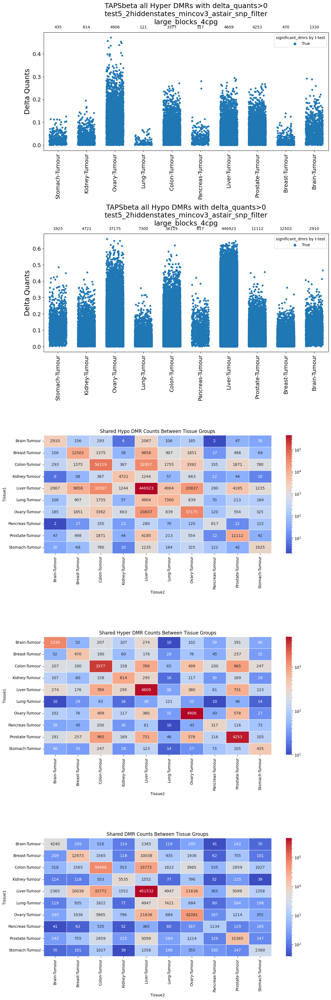

In [8]:

### Filter by delta quants and significance
delta_quants_threshold = 0
t_test_filter = True

df_subset = selected_regions.loc[selected_regions['delta_quants']>delta_quants_threshold]
if t_test_filter:
    df_subset = df_subset.loc[df_subset['significant_dmrs']==True]


# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')






ax = axs[2]
# Plot 2: Heatmap for Hypo
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"]
shared_dmr_counts_df_hypo = generate_shared_dmr_counts_df(df_hypo)
sns.heatmap(shared_dmr_counts_df_hypo, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df_hyper = generate_shared_dmr_counts_df(df_hyper)
sns.heatmap(shared_dmr_counts_df_hyper, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df_all = generate_shared_dmr_counts_df(df_subset)
sns.heatmap(shared_dmr_counts_df_all, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


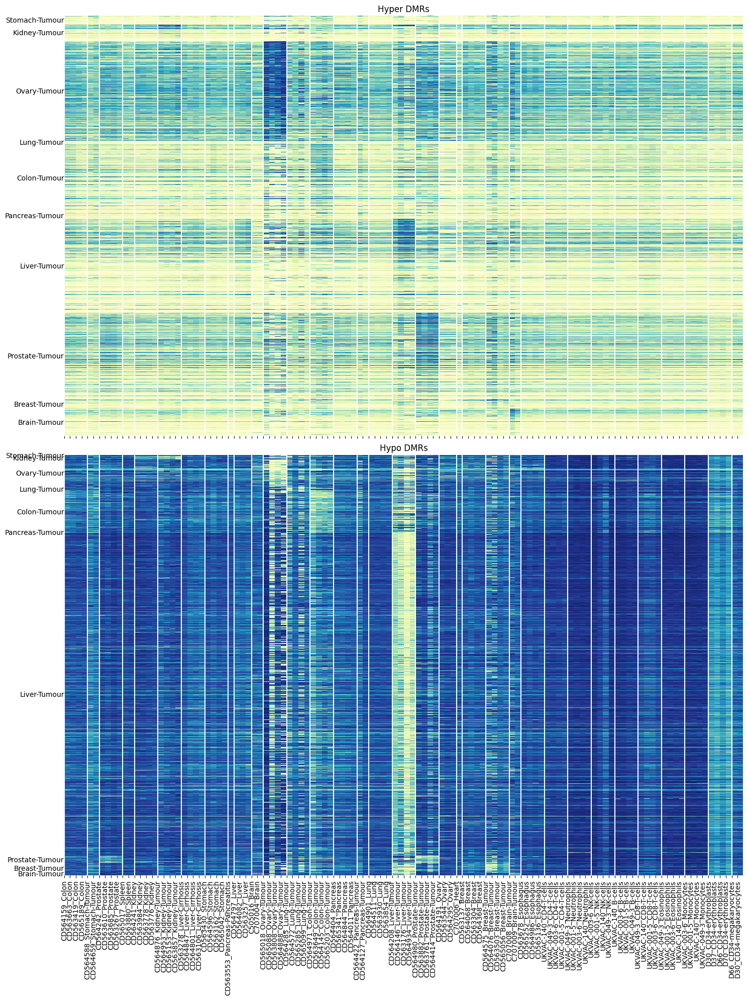

ValueError: too many values to unpack (expected 2)

In [15]:
"TAPSbeta.Tumour_vs_healthy_background_DMBs.all_delta_quants0.TAPSbeta_hmm.all_samples.test5_2hiddenstates_mincov3_astair_snp_filter.Filtered_blocks.large_blocks_4cpg.csv

"

sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/tissue_atlas_codebase/')
from dmr_functions import grail_find_markers_copy, get_grail_dmrs, plot_hypo_hyper_dmr_heatmap, get_tissue_labels_positions

fig,ax = plot_hypo_hyper_dmr_heatmap(df_subset[[u for u in df_subset.columns if u in id_tissue_map.keys()]+['Hyper_or_Hypo','selected_tissue']],
                                    y_label_tissue_groups=True,
                                    xticklabel_frequency=1,
#                                     cmap='Spectral_r',
                                    )



### Normalised

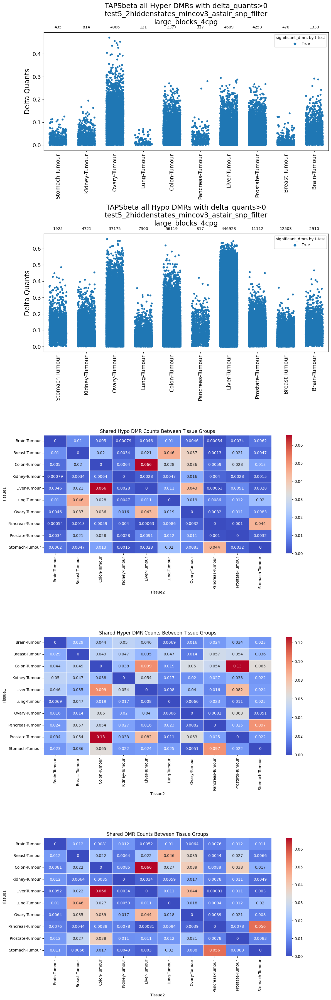

In [17]:

### Filter by delta quants and significance
delta_quants_threshold = 0
t_test_filter = True

df_subset = selected_regions.loc[selected_regions['delta_quants']>delta_quants_threshold]
if t_test_filter:
    df_subset = df_subset.loc[df_subset['significant_dmrs']==True]


# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')








ax = axs[2]
# Plot 2: Heatmap for Hypo
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"]
shared_dmr_counts_df = generate_shared_dmr_counts_df(df_hypo)
total_dmr_counts = np.diag(shared_dmr_counts_df.values)
total_dmrs = pd.DataFrame({
    "Total DMRs": total_dmr_counts
}, index=shared_dmr_counts_df.index)

# Normalizing shared DMR counts by the sum of the total DMRs for the two tissues
normalized_shared_dmrs = shared_dmr_counts_df.copy()
for tissue1 in normalized_shared_dmrs.columns:
    for tissue2 in normalized_shared_dmrs.index:
        sum_of_dmrs = total_dmrs.loc[tissue1, "Total DMRs"] + total_dmrs.loc[tissue2, "Total DMRs"]
        normalized_shared_dmrs.loc[tissue2, tissue1] /= sum_of_dmrs

        
np.fill_diagonal(normalized_shared_dmrs.values, 0)
sns.heatmap(normalized_shared_dmrs, 
            annot=True, 
            cmap='coolwarm',
            linewidths=.5,
            ax=ax
           )



ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df = generate_shared_dmr_counts_df(df_hyper)
total_dmr_counts = np.diag(shared_dmr_counts_df.values)
total_dmrs = pd.DataFrame({
    "Total DMRs": total_dmr_counts
}, index=shared_dmr_counts_df.index)

# Normalizing shared DMR counts by the sum of the total DMRs for the two tissues
normalized_shared_dmrs = shared_dmr_counts_df.copy()
for tissue1 in normalized_shared_dmrs.columns:
    for tissue2 in normalized_shared_dmrs.index:
        sum_of_dmrs = total_dmrs.loc[tissue1, "Total DMRs"] + total_dmrs.loc[tissue2, "Total DMRs"]
        normalized_shared_dmrs.loc[tissue2, tissue1] /= sum_of_dmrs

        
np.fill_diagonal(normalized_shared_dmrs.values, 0)
sns.heatmap(normalized_shared_dmrs, 
            annot=True, 
            cmap='coolwarm',
            linewidths=.5,
            ax=ax
           )
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df = generate_shared_dmr_counts_df(df_subset)
total_dmr_counts = np.diag(shared_dmr_counts_df.values)
total_dmrs = pd.DataFrame({
    "Total DMRs": total_dmr_counts
}, index=shared_dmr_counts_df.index)

# Normalizing shared DMR counts by the sum of the total DMRs for the two tissues
normalized_shared_dmrs = shared_dmr_counts_df.copy()
for tissue1 in normalized_shared_dmrs.columns:
    for tissue2 in normalized_shared_dmrs.index:
        sum_of_dmrs = total_dmrs.loc[tissue1, "Total DMRs"] + total_dmrs.loc[tissue2, "Total DMRs"]
        normalized_shared_dmrs.loc[tissue2, tissue1] /= sum_of_dmrs



np.fill_diagonal(normalized_shared_dmrs.values, 0)
sns.heatmap(normalized_shared_dmrs, 
            annot=True, 
            cmap='coolwarm',
            linewidths=.5,
            ax=ax
           )
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


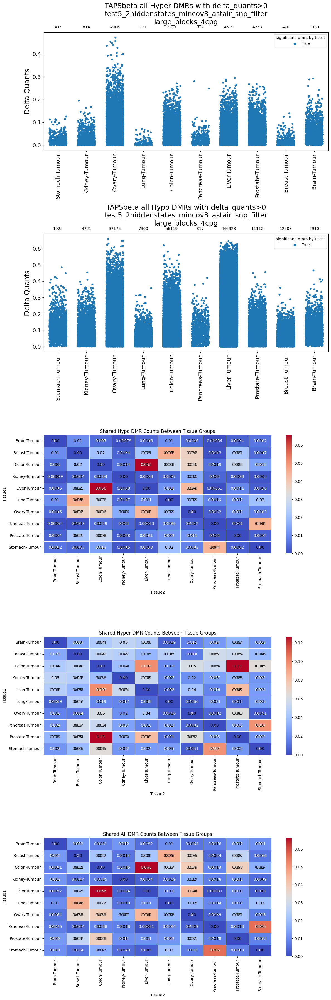

In [21]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm

def custom_heatmap(*args, **kwargs):
    # Draw the heatmap
    ax = sns.heatmap(*args, **kwargs)

    # Retrieve the matrix of data and the matrix of annotations
    data = args[0]
    annot = kwargs.get('annot', False)

    if annot:
        # Loop over data dimensions and create text annotations
        for i in range(data.shape[0]):
            for j in range(data.shape[1]):
                value = data.iloc[i, j]
                if isinstance(value, (int, np.integer)):
                    text = f"{value:d}"
                elif isinstance(value, (float, np.float)):
                    text = f"{value:.2f}"
                else:
                    text = str(value)
                ax.text(j + 0.5, i + 0.5, text, ha="center", va="center", color="black")

    return ax

### Filter by delta quants and significance
delta_quants_threshold = 0
t_test_filter = True
normalize = True  # Set this to True or False as needed

df_subset = selected_regions.loc[selected_regions['delta_quants'] > delta_quants_threshold]
if t_test_filter:
    df_subset = df_subset.loc[df_subset['significant_dmrs'] == True]

# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))

# Strip plots for Hyper and Hypo
for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    ax.legend_.set_title("significant_dmrs by t-test")
    
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), textcoords="offset points", xytext=(0,10), ha='center')

# Heatmaps for Hypo, Hyper, and All
for ax, hyper_or_hypo in zip(axs[2:], ["Hypo", "Hyper", "All"]):
    if hyper_or_hypo != "All":
        df_cond = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    else:
        df_cond = df_subset

    shared_dmr_counts_df = generate_shared_dmr_counts_df(df_cond)
    
    if normalize:
        total_dmr_counts = np.diag(shared_dmr_counts_df.values)
        total_dmrs = pd.DataFrame({"Total DMRs": total_dmr_counts}, index=shared_dmr_counts_df.index)
        normalized_shared_dmrs = shared_dmr_counts_df.copy()

        for tissue1 in normalized_shared_dmrs.columns:
            for tissue2 in normalized_shared_dmrs.index:
                sum_of_dmrs = total_dmrs.loc[tissue1, "Total DMRs"] + total_dmrs.loc[tissue2, "Total DMRs"]
                normalized_shared_dmrs.loc[tissue2, tissue1] /= sum_of_dmrs
        np.fill_diagonal(normalized_shared_dmrs.values, 0)
        data_to_plot = normalized_shared_dmrs
    else:
        data_to_plot = shared_dmr_counts_df

    custom_heatmap(data_to_plot, annot=True, cmap='coolwarm', linewidths=.5, norm=LogNorm() if not normalize else None, ax=ax)
    ax.set_title(f'Shared {hyper_or_hypo} DMR Counts Between Tissue Groups')

plt.tight_layout()
plt.show()


### Delta_quants > 0.1

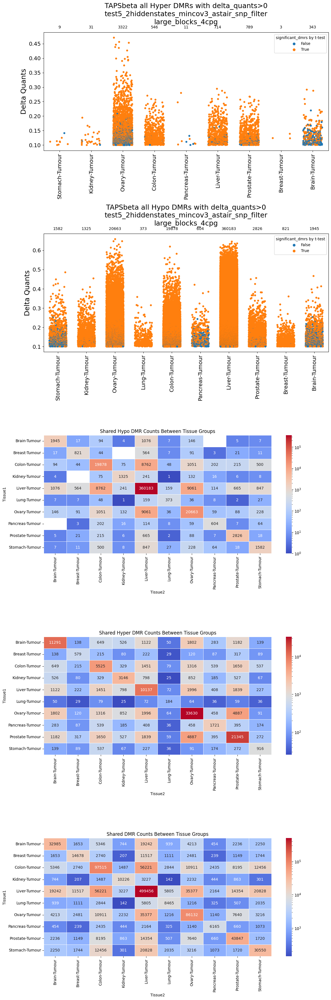

In [22]:
df_subset = selected_regions.loc[selected_regions['delta_quants']>0.1]

df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()
df_hypo['delta_quants'] = df_hypo['delta_quants'] * -1  # Make delta_quants negative for "Hypo"
df_combined = pd.concat([df_hyper, df_hypo])

# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')






df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()




ax = axs[2]
# Plot 2: Heatmap for Hypo
shared_dmr_counts_df_hypo = generate_shared_dmr_counts_df(df_hypo)
sns.heatmap(shared_dmr_counts_df_hypo, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = selected_regions.loc[selected_regions['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df_hyper = generate_shared_dmr_counts_df(df_hyper)
sns.heatmap(shared_dmr_counts_df_hyper, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df_all = generate_shared_dmr_counts_df(selected_regions)
sns.heatmap(shared_dmr_counts_df_all, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


### T-test significant

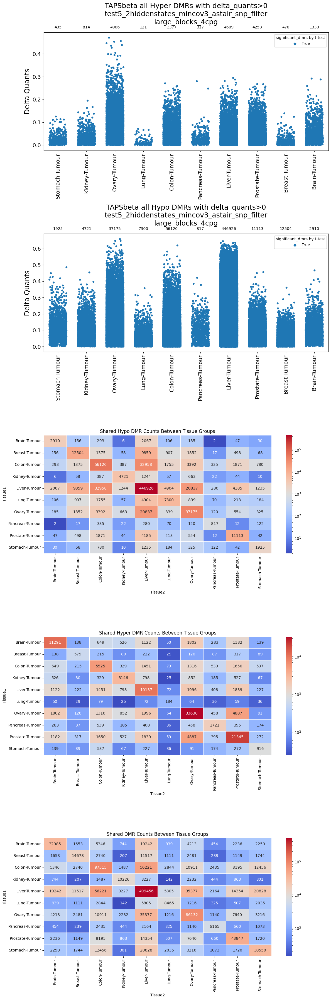

In [23]:
df_subset = selected_regions.loc[selected_regions['significant_dmrs']==True]

df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()
df_hypo['delta_quants'] = df_hypo['delta_quants'] * -1  # Make delta_quants negative for "Hypo"
df_combined = pd.concat([df_hyper, df_hypo])

# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')






df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()

# Function to generate shared_dmr_counts_df for heatmaps
def generate_shared_dmr_counts_df(df, link_character='_'):
    shared_dmrs = df.groupby("selected_tissue").apply(lambda x: x.index).to_dict()
    shared_dmr_counts = {}
    for tissue1, dmrs1 in shared_dmrs.items():
        for tissue2, dmrs2 in shared_dmrs.items():
            shared_key = f"{tissue1}{link_character}{tissue2}"
            shared_dmr_counts[shared_key] = len(set(dmrs1) & set(dmrs2))
    
    shared_dmr_counts_df = pd.Series(shared_dmr_counts).reset_index()
    shared_dmr_counts_df[['Tissue1', 'Tissue2']] = shared_dmr_counts_df['index'].str.split(link_character, expand=True)
    shared_dmr_counts_df = shared_dmr_counts_df.pivot('Tissue1', 'Tissue2', 0).fillna(0)
    shared_dmr_counts_df = shared_dmr_counts_df.reindex(index=[u for u in tissue_order if u in list(shared_dmr_counts_df.index)], columns=[u for u in tissue_order if u in shared_dmr_counts_df.columns])
    return shared_dmr_counts_df


ax = axs[2]
# Plot 2: Heatmap for Hypo
shared_dmr_counts_df_hypo = generate_shared_dmr_counts_df(df_hypo)
sns.heatmap(shared_dmr_counts_df_hypo, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = selected_regions.loc[selected_regions['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df_hyper = generate_shared_dmr_counts_df(df_hyper)
sns.heatmap(shared_dmr_counts_df_hyper, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df_all = generate_shared_dmr_counts_df(selected_regions)
sns.heatmap(shared_dmr_counts_df_all, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


### Next steps

- Normalise shared DMB counts by total number of DMBs

- Look at shared DMBs in tumour, eg liver tumour and colon-tumour, and compare with healthy DMBs - eg do liver and pancreas share DMBs in healthy but not in cancer?

- What is our final method for finding tissue specific DMBs? KNN, PCA? Can we somehow get weights for tissue-specific clustering (eg in t-SNE)? NMF on all data - may be simpler on all tissues?

- Cluster by shared DMBs - maybe choose top_n to avoid just clustering by liver-tumour DMBs

- Find the most convincing pan-cancer DMBs from bottom up approach and ask:
    - What tumour samples tend share DMBs?
    - Export as csv and share for downstream analysis, eg gene enrichment?

### Delta_quants > 0.1 and significant t-test

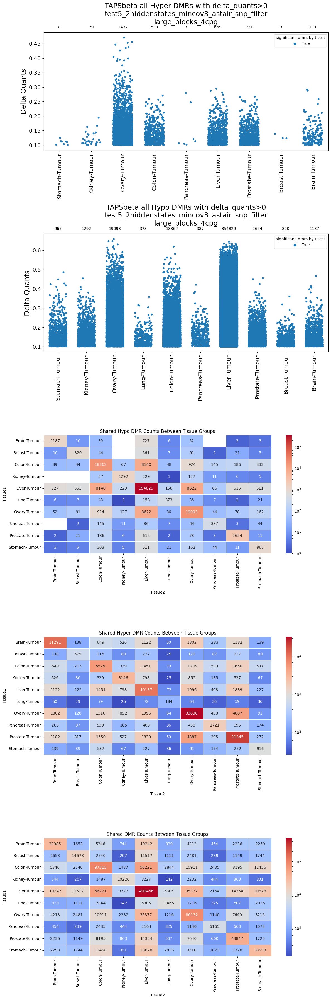

In [24]:
df_subset = selected_regions.loc[(selected_regions['significant_dmrs']==True)& (selected_regions['delta_quants']>0.1)]

df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()
df_hypo['delta_quants'] = df_hypo['delta_quants'] * -1  # Make delta_quants negative for "Hypo"
df_combined = pd.concat([df_hyper, df_hypo])

# Create a single figure with multiple rows and 1 column
fig, axs = plt.subplots(5, 1, figsize=(12, 36))


for ax, hyper_or_hypo in zip(axs[:2], ["Hyper", "Hypo"]):
    df_sub = df_subset.loc[df_subset['Hyper_or_Hypo'] == hyper_or_hypo]
    sns.stripplot(x='selected_tissue', y='delta_quants', hue='significant_dmrs', 
                  data=df_sub, jitter=0.3, dodge=False, ax=ax)
    
    ax.tick_params(axis='both', which='major', labelsize=14)
    ax.set_xlabel('')
    ax.set_ylabel('Delta Quants', fontsize=18)
    ax.set_title(f'{exp} all {hyper_or_hypo} DMRs with delta_quants>0\n{test_name}\n{filter_name}', fontsize=18, y=1.05)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
    
    # Change the legend title
    ax.legend_.set_title("significant_dmrs by t-test")
    
    # Count the occurrences for each 'selected_tissue'
    count_data = df_sub['selected_tissue'].value_counts().reset_index()
    count_data.columns = ['selected_tissue', 'counts']
    
    # Annotate the counts above the appropriate x-axis positions
    for i, label in enumerate(ax.get_xticklabels()):
        tissue = label.get_text()
        count = count_data.loc[count_data['selected_tissue'] == tissue, 'counts'].values
        if len(count) > 0:
            ax.annotate(f'{count[0]}', (i, ax.get_ylim()[1]), 
                        textcoords="offset points", xytext=(0,10), ha='center')






df_hyper = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hyper"].copy()
df_hypo = df_subset.loc[df_subset['Hyper_or_Hypo'] == "Hypo"].copy()

# Function to generate shared_dmr_counts_df for heatmaps
def generate_shared_dmr_counts_df(df, link_character='_'):
    shared_dmrs = df.groupby("selected_tissue").apply(lambda x: x.index).to_dict()
    shared_dmr_counts = {}
    for tissue1, dmrs1 in shared_dmrs.items():
        for tissue2, dmrs2 in shared_dmrs.items():
            shared_key = f"{tissue1}{link_character}{tissue2}"
            shared_dmr_counts[shared_key] = len(set(dmrs1) & set(dmrs2))
    
    shared_dmr_counts_df = pd.Series(shared_dmr_counts).reset_index()
    shared_dmr_counts_df[['Tissue1', 'Tissue2']] = shared_dmr_counts_df['index'].str.split(link_character, expand=True)
    shared_dmr_counts_df = shared_dmr_counts_df.pivot('Tissue1', 'Tissue2', 0).fillna(0)
    shared_dmr_counts_df = shared_dmr_counts_df.reindex(index=[u for u in tissue_order if u in list(shared_dmr_counts_df.index)], columns=[u for u in tissue_order if u in shared_dmr_counts_df.columns])
    return shared_dmr_counts_df


ax = axs[2]
# Plot 2: Heatmap for Hypo
shared_dmr_counts_df_hypo = generate_shared_dmr_counts_df(df_hypo)
sns.heatmap(shared_dmr_counts_df_hypo, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hypo DMR Counts Between Tissue Groups')

ax = axs[3]
# Plot 3: Heatmap for Hyper
df_hyper = selected_regions.loc[selected_regions['Hyper_or_Hypo'] == "Hyper"]
shared_dmr_counts_df_hyper = generate_shared_dmr_counts_df(df_hyper)
sns.heatmap(shared_dmr_counts_df_hyper, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared Hyper DMR Counts Between Tissue Groups')


# Plot 4: Heatmap for All
ax = axs[4]
shared_dmr_counts_df_all = generate_shared_dmr_counts_df(selected_regions)
sns.heatmap(shared_dmr_counts_df_all, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5,
            norm=LogNorm(),
            ax=ax)
ax.set_title('Shared DMR Counts Between Tissue Groups')

# Tight layout to ensure plots do not overlap
plt.tight_layout()
# plt.show()


### Shared between more than two tissue types

In [25]:
dmrs = df
tissue_samples_mr = df[[u for u in df.columns if u in list(id_tissue_map.keys())]]

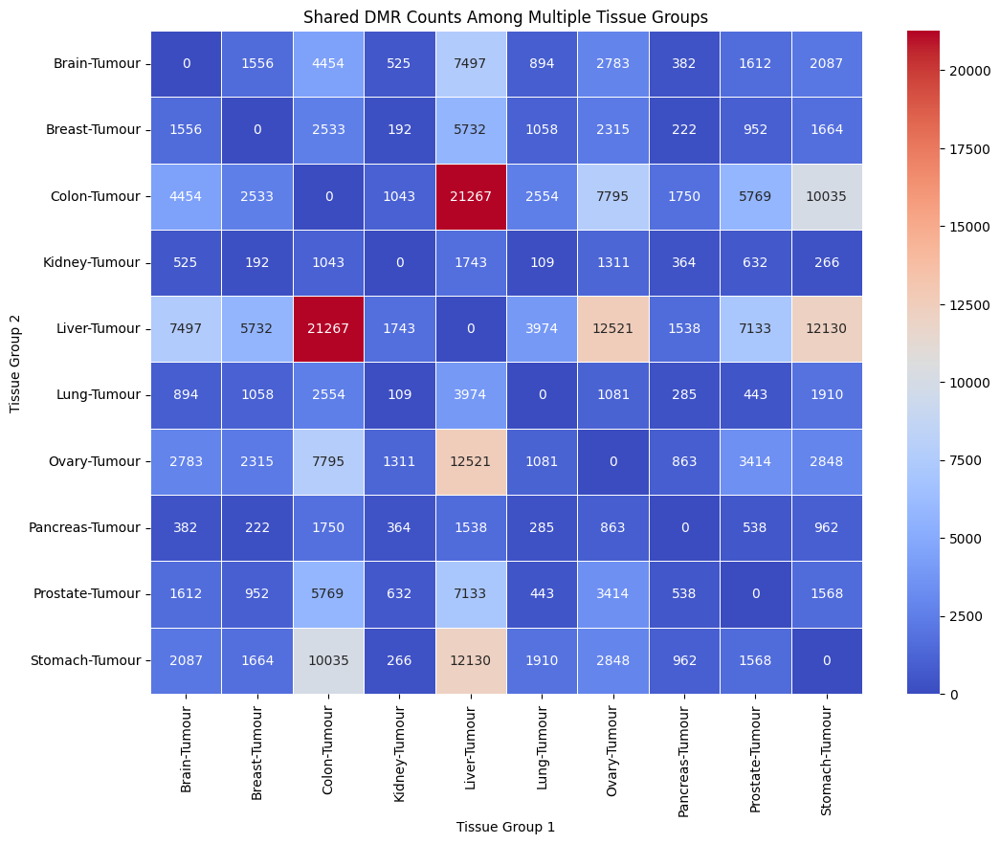

In [26]:
from collections import defaultdict
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Initialize a defaultdict to store DMRs and the tissues they are found in
dmr_to_tissues = defaultdict(set)

# Populate the defaultdict
for tissue, dmrs in shared_dmrs.items():
    for dmr in dmrs:
        dmr_to_tissues[dmr].add(tissue)

# Find DMRs that are shared among multiple tissues
shared_mult_tissue_dmrs = {dmr: tissues for dmr, tissues in dmr_to_tissues.items() if len(tissues) > 2}

# Create a DataFrame to visualize the shared DMR counts among multiple tissues
# Initialize a DataFrame with zeros
tissues = list(shared_dmrs.keys())
multi_tissue_counts_df = pd.DataFrame(0, index=tissues, columns=tissues)

# Populate the DataFrame
for dmr, tissues in shared_mult_tissue_dmrs.items():
    for tissue1 in tissues:
        for tissue2 in tissues:
            if tissue1 != tissue2:
                multi_tissue_counts_df.loc[tissue1, tissue2] += 1

# Set diagonal values to 0
np.fill_diagonal(multi_tissue_counts_df.values, 0)

# Plotting the heatmap
plt.figure(figsize=(12, 9))
sns.heatmap(multi_tissue_counts_df, 
            annot=True, 
            cmap='coolwarm',
            fmt='g',
            linewidths=.5)
plt.title('Shared DMR Counts Among Multiple Tissue Groups')
plt.xlabel('Tissue Group 1')
plt.ylabel('Tissue Group 2')
plt.show()


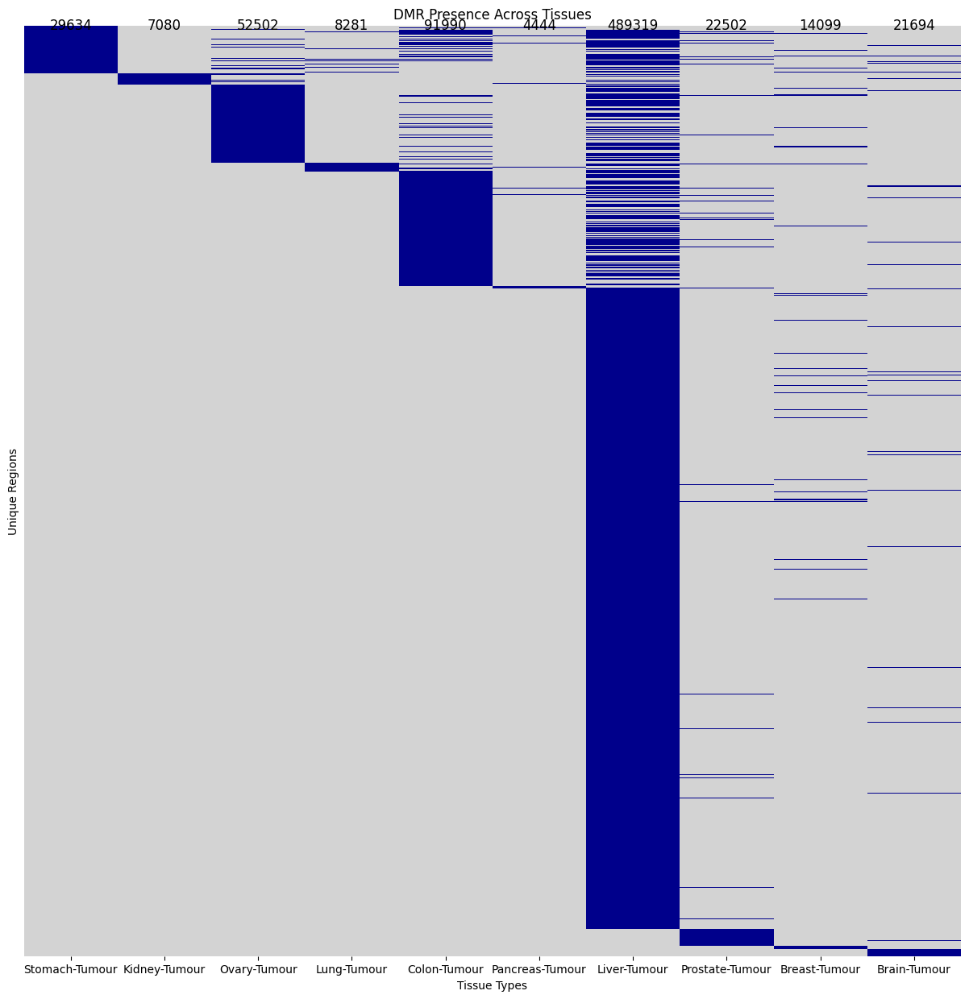

In [12]:
import matplotlib.colors as mcolors

# Create a custom colormap
cmap = mcolors.ListedColormap(['#D3D3D3', 'darkblue'])  # Light grey for 0, dark blue for 1

# Extract unique regions and tissues
unique_regions = df.index.unique()
unique_tissues = df['selected_tissue'].unique()

# Initialize a DataFrame with zeros
binary_dmr_df = pd.DataFrame(0, index=unique_regions, columns=unique_tissues)

# Populate the DataFrame
dmr_counts = {}
for tissue in unique_tissues:
    tissue_df = df[df['selected_tissue'] == tissue]
    dmr_counts[tissue] = len(tissue_df)
    for region in tissue_df.index:
        binary_dmr_df.loc[region, tissue] = 1

# Plotting the heatmap
fig, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(binary_dmr_df, 
            cmap=cmap, 
            cbar=False, 
            yticklabels=False,
#             linewidths=.5,   # Gridline width
#             linecolor='white',  # Gridline color
            ax=ax)
plt.title('DMR Presence Across Tissues')
plt.xlabel('Tissue Types')
plt.ylabel('Unique Regions')

# Annotate the total number of DMRs for each tissue
for i, tissue in enumerate(binary_dmr_df.columns):
    plt.text(i + 0.5, -0.5, str(dmr_counts[tissue]), 
             verticalalignment='center', 
             horizontalalignment='center', 
             fontsize=12,
             color='black')

plt.show()


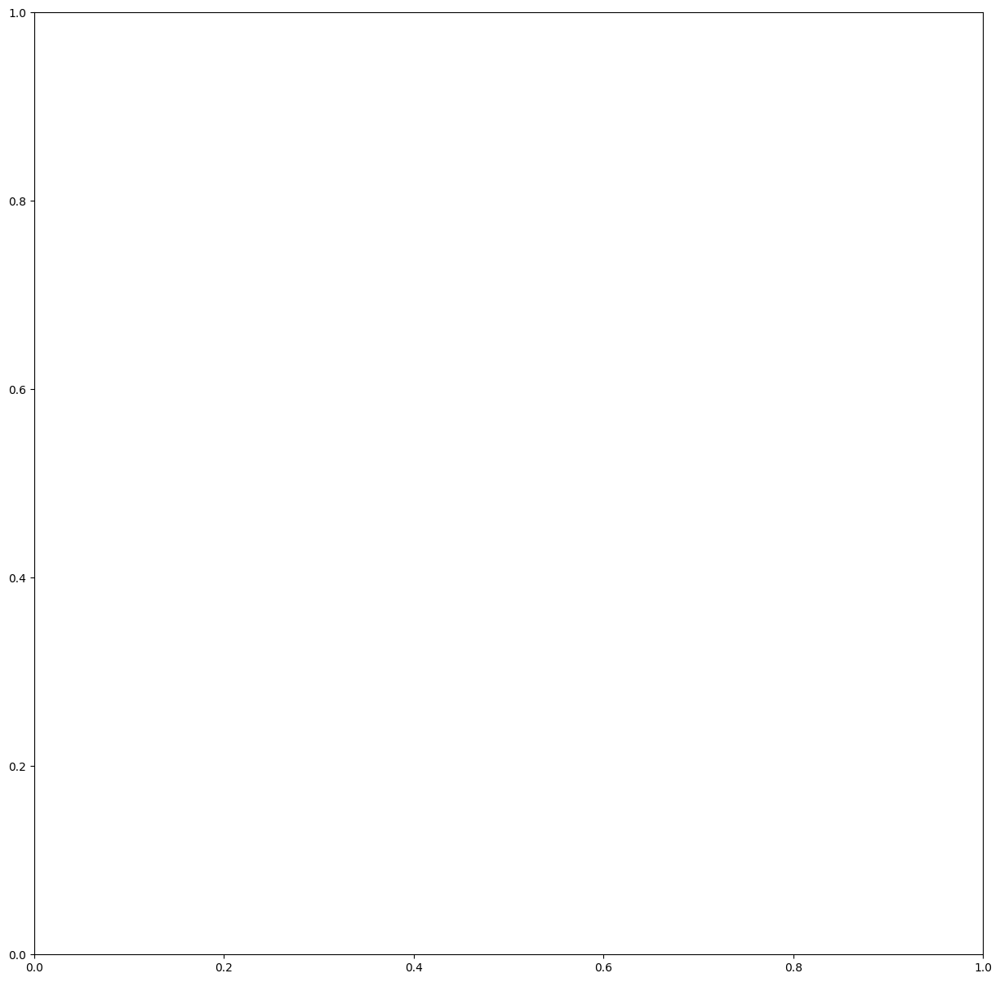

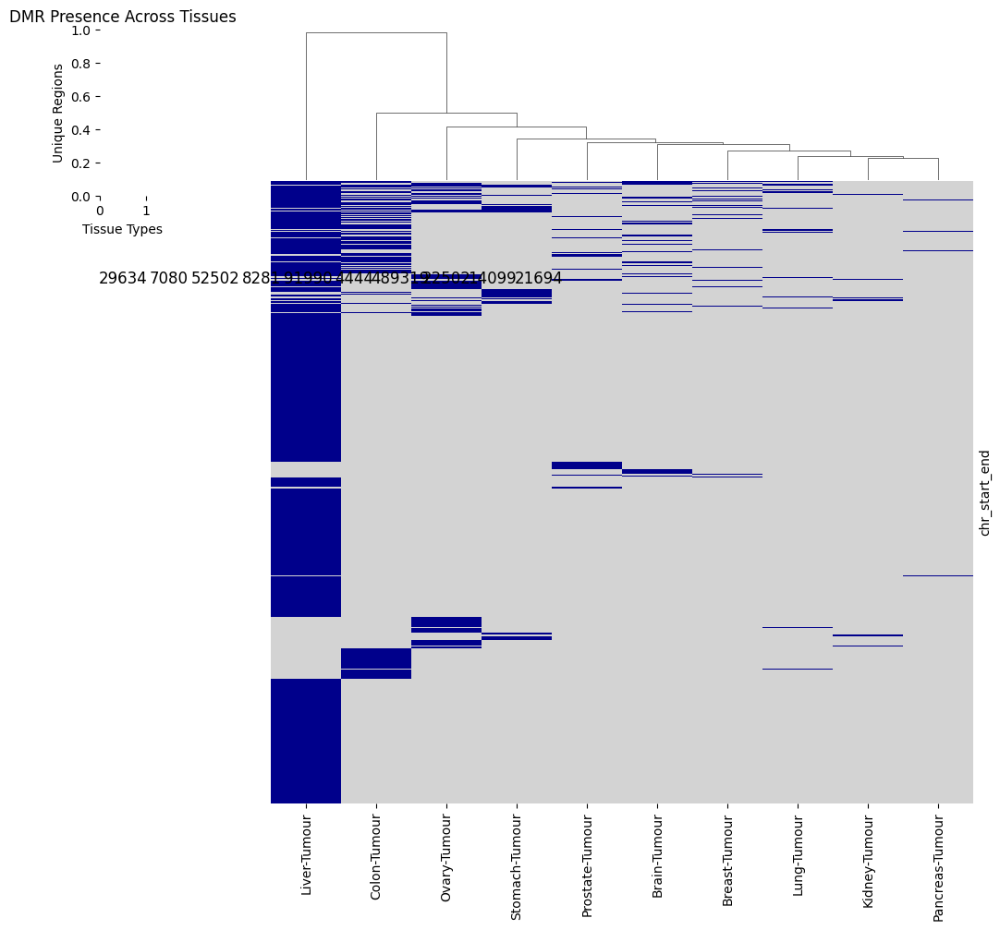

In [13]:
import matplotlib.colors as mcolors
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

# Create a custom colormap
cmap = mcolors.ListedColormap(['#D3D3D3', 'darkblue'])  # Light grey for 0, dark blue for 1

# Extract unique regions and tissues
unique_regions = df.index.unique()
unique_tissues = df['selected_tissue'].unique()

# Initialize a DataFrame with zeros
binary_dmr_df = pd.DataFrame(0, index=unique_regions, columns=unique_tissues)

# Populate the DataFrame
dmr_counts = {}
for tissue in unique_tissues:
    tissue_df = df[df['selected_tissue'] == tissue]
    dmr_counts[tissue] = len(tissue_df)
    for region in tissue_df.index:
        binary_dmr_df.loc[region, tissue] = 1

# Add a row summary for the number of tissues each DMR is present in
binary_dmr_df['Sum'] = binary_dmr_df.sum(axis=1)

# Plotting the heatmap with hierarchical clustering
fig, ax = plt.subplots(figsize=(15, 15))
sns.clustermap(binary_dmr_df.sort_values('Sum', ascending=False).drop('Sum', axis=1), 
               cmap=cmap, 
               cbar=False, 
               yticklabels=False, 
               row_cluster=False,  # Turn this on if you also want to cluster rows
               col_cluster=True,
#                linewidths=.5,
#                linecolor='white',
              )

# Additional title and labels
plt.title('DMR Presence Across Tissues')
plt.xlabel('Tissue Types')
plt.ylabel('Unique Regions')

# Annotate the total number of DMRs for each tissue
for i, tissue in enumerate(binary_dmr_df.columns[:-1]):  # Exclude 'Sum'
    plt.text(i + 0.5, -0.5, str(dmr_counts[tissue]), 
             verticalalignment='center', 
             horizontalalignment='center', 
             fontsize=12,
             color='black')

plt.show()


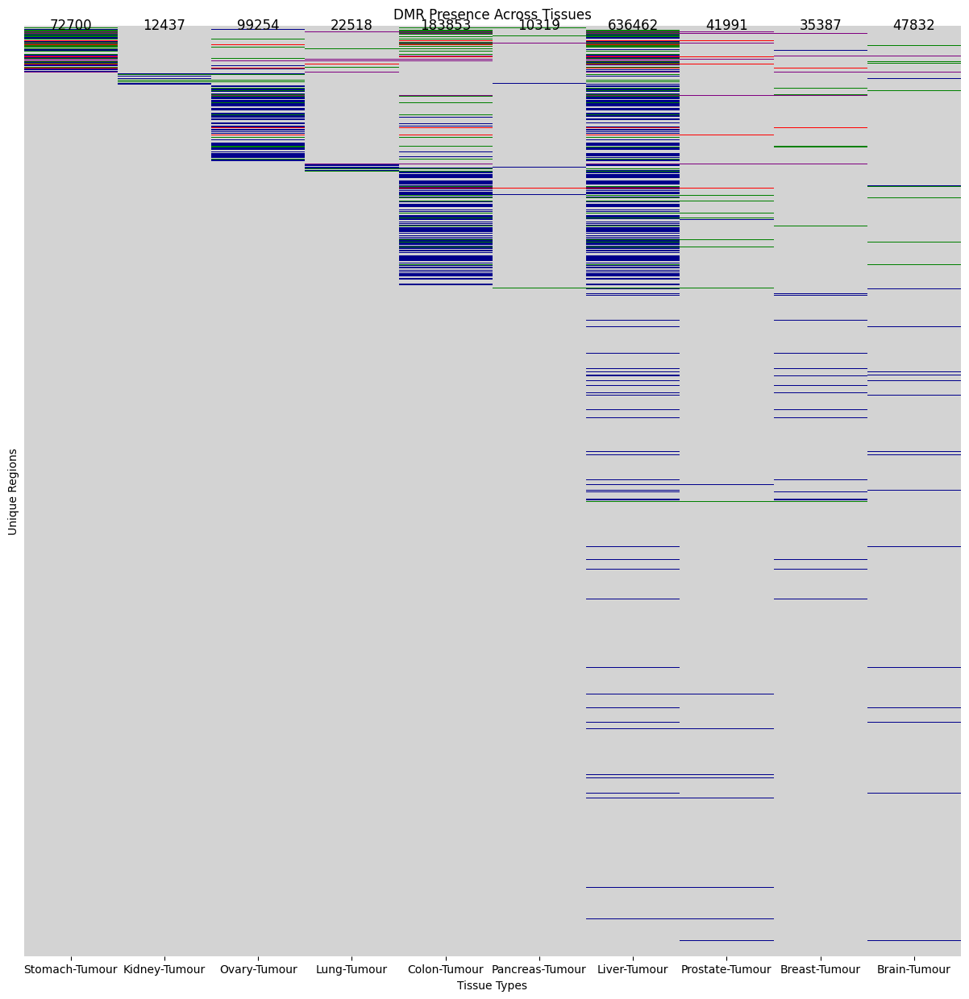

In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Initialize a DataFrame with zeros
binary_dmr_df = pd.DataFrame(0, index=df.index.unique(), columns=df['selected_tissue'].unique())

# Populate the DataFrame
for tissue in binary_dmr_df.columns:
    tissue_df = df[df['selected_tissue'] == tissue]
    for region in tissue_df.index:
        binary_dmr_df.loc[region, tissue] = 1

# Calculate the number of tissues each DMR is found in
dmr_shared_count = binary_dmr_df.sum(axis=1)

# Replace the binary values in binary_dmr_df with the shared count for each DMR
for region in binary_dmr_df.index:
    binary_dmr_df.loc[region] = binary_dmr_df.loc[region] * dmr_shared_count[region]

# Create a custom colormap
cmap = mcolors.ListedColormap(['#D3D3D3', 'darkblue', 'green', 'red', 'purple', 'orange'])

# Plotting the heatmap
fig, ax = plt.subplots(figsize=(15, 15))
sns.heatmap(binary_dmr_df, 
            cmap=cmap, 
            cbar=False, 
            yticklabels=False,
#             linewidths=.5,  # Gridline width
#             linecolor='black',
           )  # Gridline color
plt.title('DMR Presence Across Tissues')
plt.xlabel('Tissue Types')
plt.ylabel('Unique Regions')

# Annotate the total number of DMRs for each tissue
dmr_counts = binary_dmr_df.sum()
for i, tissue in enumerate(binary_dmr_df.columns):
    plt.text(i + 0.5, -0.5, str(dmr_counts[tissue]), 
             verticalalignment='center', 
             horizontalalignment='center', 
             fontsize=12,
             color='black')

plt.show()


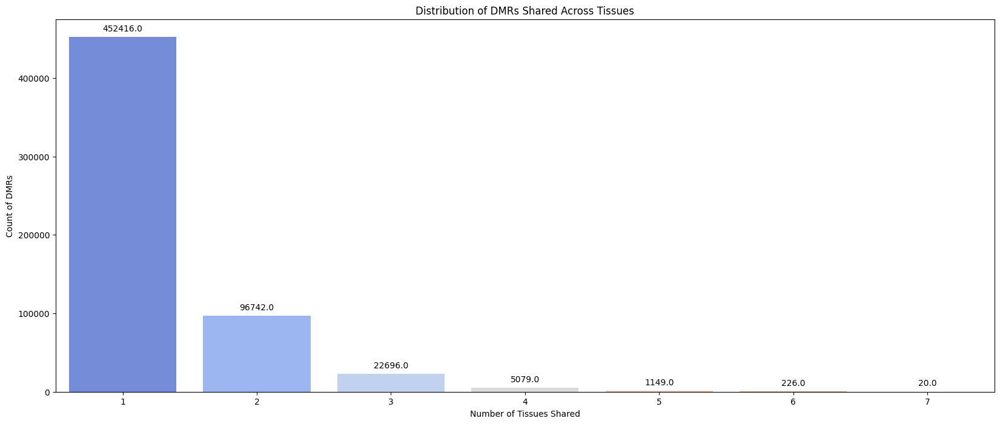

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Initialize a DataFrame with zeros
binary_dmr_df = pd.DataFrame(0, index=df.index.unique(), columns=df['selected_tissue'].unique())

# Populate the DataFrame
for tissue in binary_dmr_df.columns:
    tissue_df = df[df['selected_tissue'] == tissue]
    for region in tissue_df.index:
        binary_dmr_df.loc[region, tissue] = 1

# Calculate the number of tissues each DMR is found in
dmr_shared_count = binary_dmr_df.sum(axis=1).reset_index()
dmr_shared_count.columns = ['DMR', 'Shared_Count']

# Create a bar plot
plt.figure(figsize=(20, 8))
ax = sns.countplot(data=dmr_shared_count, x='Shared_Count', palette='coolwarm')

# Annotate the bars
for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', xytext=(0, 10), textcoords='offset points')

plt.title('Distribution of DMRs Shared Across Tissues')
plt.xlabel('Number of Tissues Shared')
plt.ylabel('Count of DMRs')
plt.show()


In [16]:
dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]

,DMR,Shared_Count
0,chr1_185001490_185001695,6
35,chr11_7861238_7861374,6
62,chr7_141985784_141985914,6
68,chr2_117622999_117623422,6
73,chr7_157039717_157040014,6
...,...,...
73436,chr14_87672896_87674464,6
75633,chr7_146672064_146672585,6
85848,chr1_166325250_166325425,6
86589,chr15_98261671_98262913,6


In [17]:
dmr_shared_count.sort_values(by='Shared_Count',ascending=False)

,DMR,Shared_Count
2216,chr8_87241506_87241629,7
18925,chr16_86664461_86665220,7
569,chr2_210249559_210249723,7
596,chr9_133016664_133017775,7
1873,chr2_126621794_126623054,7
...,...,...
267728,chr4_100222934_100224718,1
267727,chr13_24999400_24999893,1
267726,chr12_43332060_43332550,1
267725,chr5_24264107_24264529,1


In [18]:
dmr_shared_count.loc[dmr_shared_count['DMR']=="chr14_56802650_56818457"]

,DMR,Shared_Count


In [19]:
selected_regions.loc['chr14_56802650_56818457',:]

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.206937,0.095963,0.110975,0.178580,0.157656,0.020924,4.773527e-06,True,Hyper,Stomach-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.236701,0.095963,0.140738,0.183328,0.157656,0.025672,2.509325e-11,True,Hyper,Ovary-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.235725,0.095963,0.139762,0.167662,0.157656,0.010006,2.568287e-11,True,Hyper,Lung-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.273342,0.095963,0.177379,0.225813,0.157656,0.068157,4.564995e-17,True,Hyper,Colon-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.213458,0.095963,0.117496,0.182392,0.157656,0.024736,1.818277e-06,True,Hyper,Pancreas-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.281135,0.095963,0.185172,0.258069,0.157656,0.100413,2.294289e-18,True,Hyper,Prostate-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.207474,0.095963,0.111512,0.170921,0.157656,0.013265,4.585018e-09,True,Hyper,Breast-Tumour
chr14_56802650_56818457,0.139344,0.156392,0.08674,0.088107,0.150223,0.263652,0.112853,0.122815,0.106867,0.094018,...,0.226542,0.095963,0.130579,0.199656,0.157656,0.041999,1.303305e-07,True,Hyper,Brain-Tumour


In [20]:
sys.path.append('/well/ludwig/users/dyp502/code/taps_tissue_atlas_Nov2022/')
from taps_tissue_atlas_functions import plot_region


In [ ]:
binary_dmr_df

In [ ]:
plot_region

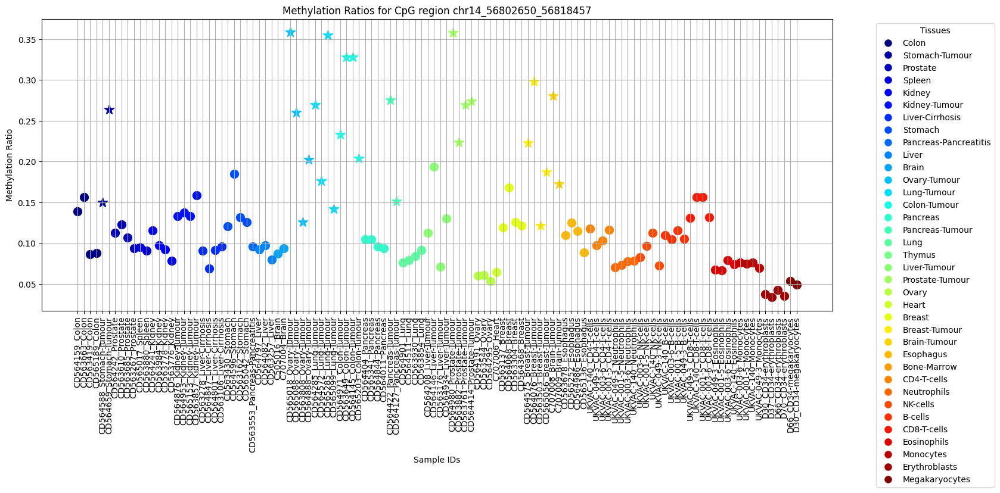

In [39]:
# 'chr14_56802650_56818457' 


dmr_index = 'chr14_56802650_56818457' 
s = binary_dmr_df.loc[dmr_index,:]==1
true_indices = s[s].index.tolist()
toi="Liver"

highlight_tissues = true_indices
plot_region(dmr_index, tissue_samples_mr, toi, tissue_id_map, id_tissue_map, highlight_tissues=highlight_tissues)


In [ ]:
highlight_tissues

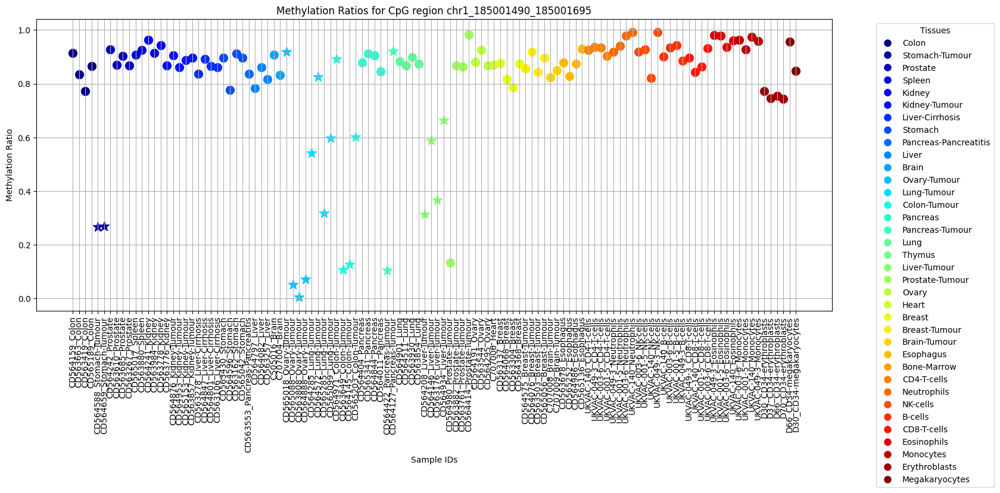

In [43]:

dmr_index = "chr1_185001490_185001695"
s = binary_dmr_df.loc[dmr_index,:]==1
true_indices = s[s].index.tolist()


highlight_tissues = true_indices
plot_region(dmr_index, tissue_samples_mr, toi, tissue_id_map, id_tissue_map, highlight_tissues)


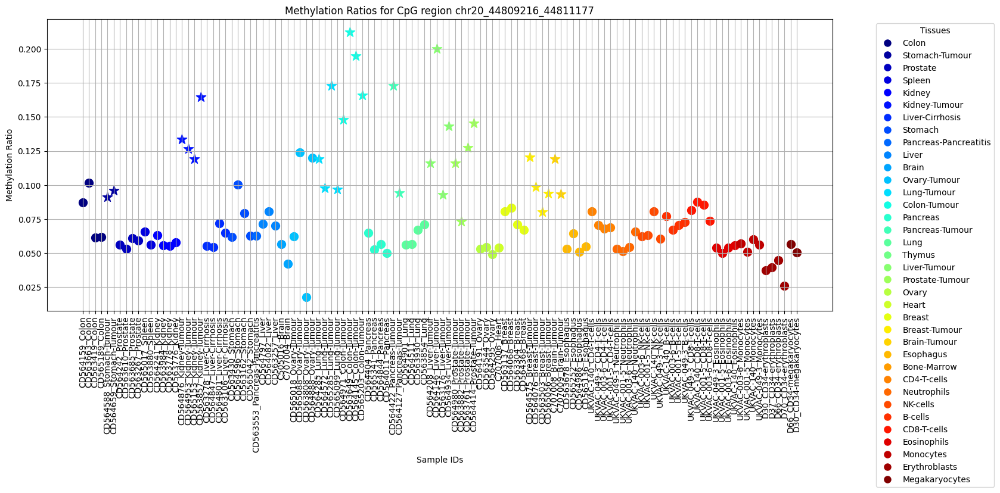

In [45]:


dmr_index = "chr20_44809216_44811177"
s = binary_dmr_df.loc[dmr_index,:]==1
true_indices = s[s].index.tolist()


highlight_tissues = true_indices
plot_region(dmr_index, tissue_samples_mr, toi, tissue_id_map, id_tissue_map, highlight_tissues)


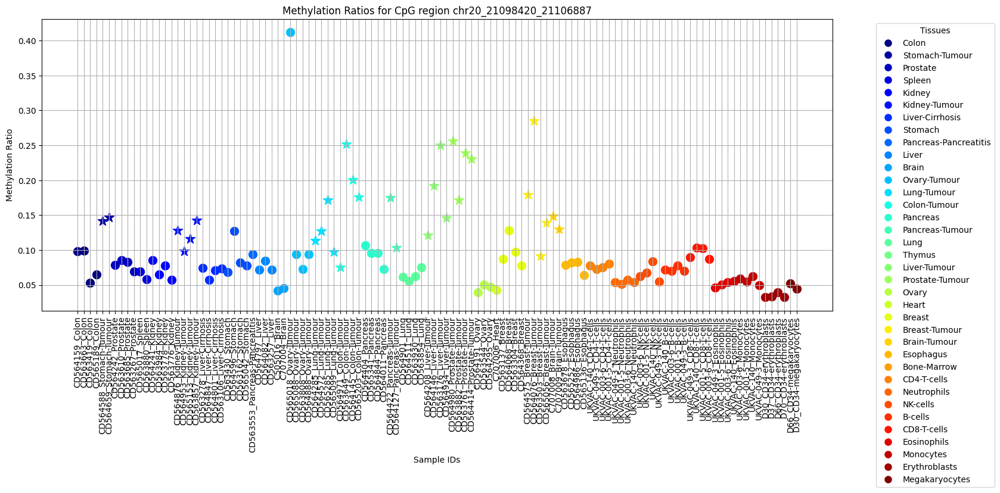

In [46]:
dmr_index = "chr20_21098420_21106887"
s = binary_dmr_df.loc[dmr_index,:]==1
true_indices = s[s].index.tolist()


highlight_tissues = true_indices
plot_region(dmr_index, tissue_samples_mr, toi, tissue_id_map, id_tissue_map, highlight_tissues)


In [ ]:
def plot_dmr_with_highlight2(df, dmr_index, target_tissue, tissue_groups,tg_names=[],bg_names=[], args=None, hypo=True,real_data=False,tissue_id_map={}):
    fig, ax = plt.subplots(figsize=(22, 10))
    colors = itertools.cycle(plt.get_cmap('tab10').colors)
    col_pos = 0

#     print(df.columns)
#     dmr_df = df.filter(regex='|'.join(tissue_groups))

    regex_pattern = '(?i)' + '|'.join(tissue_groups)
    # Filter the DataFrame using the case-insensitive regular expression
    dmr_df = df.filter(regex=regex_pattern)
#     print(dmr_df.columns)
    
    if tg_names:
        tg_names = [u for u in tg_names if u in list(df.columns)]
        bg_names = [u for u in bg_names if u in list(df.columns)]
    else:
        tg_names = [u for u in dmr_df.columns if target_tissue in u]
        bg_names = [u for u in dmr_df.columns if u not in tg_names]
        
    
    
    xticks_positions = []  # List to store the x-axis tick positions
    xticks_labels = []  # List to store the x-axis tick labels

    for tissue in tissue_groups:
        if real_data:
            tissue_columns = [col for col in tissue_id_map[tissue] if col in df.columns]
            meth_ratios_tissue = df.loc[dmr_index, tissue_columns]
        else:
            tissue_columns = [col for col in df.columns if col.startswith(tissue)]
            meth_ratios_tissue = df.loc[dmr_index, tissue_columns]
        
#         print(meth_ratios_tissue)
        x_tissue = np.arange(col_pos, col_pos + len(tissue_columns))
        col_pos += len(tissue_columns)
        
        # Add x-axis tick positions and labels
        xticks_positions.append(np.mean(x_tissue))
        xticks_labels.append(tissue)
        
        if tissue == target_tissue:
            ax.scatter(x_tissue, meth_ratios_tissue, color=next(colors), label=f"{tissue} (DMR)")
        else:
            ax.scatter(x_tissue, meth_ratios_tissue, color=next(colors), label=f"{tissue}")
        

    ax.set_xticks(xticks_positions)
    ax.set_xticklabels(xticks_labels,rotation=90)
    
    
    
    dmr_values = {
    'tg_mean': df.loc[dmr_index, 'tg_mean'],
    'bg_mean': df.loc[dmr_index, 'bg_mean'],
    'delta_means': df.loc[dmr_index, 'delta_means'],
    'tg_quant': df.loc[dmr_index, 'tg_quant'],
    'bg_quant': df.loc[dmr_index, 'bg_quant'],
    'delta_quants': df.loc[dmr_index, 'delta_quants'],
    'meth_quant_thresh': args['meth_quant_thresh'],
    'unmeth_quant_thresh': args['unmeth_quant_thresh']
     }
    
    

    print(f"Target = {tg_names}")
    print(f"Background = {bg_names}")
#     print(dmr_df.columns)
    
    
    # Debugging: Check if dmr_values contain any non-finite values
    if not all(np.isfinite(list(dmr_values.values()))):
        print(f"Warning: dmr_values contain non-finite numbers: {dmr_values}")

    
#     return dmr_df,dmr_values
        
    if args and dmr_values:
        tg_quant = args['tg_quant']
        bg_quant = args['bg_quant']
        target_quantile = 1 - tg_quant if hypo else tg_quant
        background_quantile = bg_quant if hypo else 1 - bg_quant

        tg_percentile = np.percentile(dmr_df.loc[dmr_index, tg_names], target_quantile * 100)
        bg_percentile = np.percentile(dmr_df.loc[dmr_index, bg_names], background_quantile * 100)

        ax.axhline(y=tg_percentile, linestyle='--', color='red', label=f"{target_quantile * 100:.1f}th percentile of target")
        ax.axhline(y=bg_percentile, linestyle='--', color='blue', label=f"{background_quantile * 100:.1f}th percentile of background")
        
        ax.axhline(y=dmr_values["tg_mean"], linestyle=':', color='grey', label=f"tg_mean")
        ax.axhline(y=dmr_values["bg_mean"], linestyle=':', color='grey', label=f"bg_mean")
        
        # Add vertical arrows for delta_quants and delta_means with better spacing
        arrow_x_pos_quants = 0.45
        arrow_x_pos_means = 0.55

        ax.annotate('', xy=(arrow_x_pos_quants, bg_percentile), xytext=(arrow_x_pos_quants, tg_percentile), xycoords=('axes fraction', 'data'), textcoords=('axes fraction', 'data'),
                    arrowprops=dict(arrowstyle='<->', color='black', lw=1.5))
        ax.annotate(f'delta_quants = {dmr_values["delta_quants"]:.2f}', xy=(arrow_x_pos_quants, (tg_percentile + bg_percentile) / 2), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
        ax.annotate('', xy=(arrow_x_pos_means, dmr_values["bg_mean"]), xytext=(arrow_x_pos_means, dmr_values["tg_mean"]), xycoords=('axes fraction', 'data'), textcoords=('axes fraction', 'data'),
                    arrowprops=dict(arrowstyle='<->', color='purple', lw=1.5))
        ax.annotate(f'delta_means = {dmr_values["delta_means"]:.2f}', xy=(arrow_x_pos_means, (dmr_values["tg_mean"] + dmr_values["bg_mean"]) / 2), xycoords=('axes fraction', 'data'), fontsize=10, va='center', ha='left')
        
        # Annotations for all metrics with explanations
        metric_explanations = {
            'tg_mean': 'Mean of target group',
            'bg_mean': 'Mean of background group',
            'delta_means': 'Difference in means',
            'delta_quants': 'Difference in quantiles',
            # 'tg_quant': 'Quantile value of target group',
            "tg_quant": f"Value of {target_quantile * 100:.1f}th percentile of target",
            'bg_quant': f"Value of {background_quantile * 100:.1f}th percentile of background",
            'delta_maxmin': 'Difference between max of target and min of background',
            'meth_quant_thresh':f'Min value of {background_quantile * 100:.1f}th percentile of methylated bg_group',
            'unmeth_quant_thresh':f'Max value of {target_quantile * 100:.1f}th percentile of unmethylated tg_group',
        }
        for idx, (key, value) in enumerate(dmr_values.items()):
            explanation = metric_explanations.get(key, '')
            ax.annotate(f'{key}: {value:.2f} ({explanation})', xy=(1.02, 1 - idx * 0.07), xycoords='axes fraction',
                        fontsize=10, bbox=dict(facecolor='white', alpha=0.8))
    else:
        ax.set_xticks(range(len(dmr_df.columns)))
        ax.set_xticklabels(dmr_df.columns, rotation=90)
        ax.set_ylabel("Methylation Ratio")
        ax.set_title(f"DMR at {dmr_index}")

    ax.legend(loc='center left', 
              bbox_to_anchor=(1, 0.1),
             ncols=2)
#     ax.legend(loc='lower left', 
#               bbox_to_anchor=(1.05, 1),
#               fontsize='small',
#              ncols=2)
    plt.tight_layout()
    plt.show()

In [47]:
# dmr_index = "chr20_21098420_21106887"
# target_tissue = "Prostate-Tumour"
# tissue_groups
# plot_dmr_with_highlight2(df, dmr_index, target_tissue, tissue_groups, args=None, hypo=True):


### Visualise DMBs which are shared across multiple tumour types

In [49]:
dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR']

0         chr1_185001490_185001695
35           chr11_7861238_7861374
62        chr7_141985784_141985914
68        chr2_117622999_117623422
73        chr7_157039717_157040014
                    ...           
591063     chr11_70365929_70366762
593985      chr1_90710069_90734299
605593    chr1_145475146_145476885
606481    chr9_121620746_121621670
607678     chr20_31966333_31969179
Name: DMR, Length: 339, dtype: object

In [53]:
shared_dmb_df

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.267722,0.889732,0.622009,0.268472,0.753900,0.485428,6.056053e-24,True,Hypo,Stomach-Tumour
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.261194,0.889732,0.628537,0.282472,0.753900,0.471428,3.738760e-19,True,Hypo,Ovary-Tumour
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.570694,0.889732,0.319037,0.654833,0.753900,0.099067,3.314105e-13,True,Hypo,Lung-Tumour
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.432500,0.889732,0.457232,0.674667,0.753900,0.079233,1.602116e-14,True,Hypo,Colon-Tumour
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.512667,0.889732,0.377065,0.716944,0.753900,0.036956,7.786520e-08,True,Hypo,Pancreas-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr20_31966333_31969179,0.063584,0.065142,0.042717,0.035681,0.061168,0.089124,0.040699,0.041770,0.042274,0.036292,...,0.105400,0.043478,0.061922,0.098918,0.071115,0.027803,2.763310e-13,True,Hyper,Colon-Tumour
chr20_31966333_31969179,0.063584,0.065142,0.042717,0.035681,0.061168,0.089124,0.040699,0.041770,0.042274,0.036292,...,0.089111,0.043478,0.045633,0.074086,0.071115,0.002971,3.366686e-05,False,Hyper,Pancreas-Tumour
chr20_31966333_31969179,0.063584,0.065142,0.042717,0.035681,0.061168,0.089124,0.040699,0.041770,0.042274,0.036292,...,0.118013,0.043478,0.074535,0.102998,0.071115,0.031883,1.349352e-16,True,Hyper,Liver-Tumour


In [23]:
# tissue_sample_order = []

# for tissue in healthy_tissue_types:
#     tissue_sample_order.extend(tissue_id_map[tissue])
    
# for tissue in cancer_tissue_types:
#     tissue_sample_order.extend(tissue_id_map[tissue])
    

In [26]:
tissue_sample_order = []

for tissue in healthy_tissue_types:
    tissue_sample_order.extend(tissue_id_map[tissue])
print(len(tissue_sample_order))
    
for tissue in cancer_tissue_types:
    tissue_sample_order.extend(tissue_id_map[tissue])
    

81


In [57]:
shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>1]['DMR']),:]
shared_dmb_df = shared_dmb_df.loc[(shared_dmb_df['Hyper_or_Hypo']=="Hypo"),:]

# shared_dmb_df = shared_dmb_df[~shared_dmb_df.index.duplicated(keep='first')]

# # shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR']) & (df['Hyper_or_Hypo']=="Hyper"),:]
# plt.figure(figsize=(12, 9))
# sns.heatmap(shared_dmb_df[[u for u in tissue_sample_order if u in shared_dmb_df.columns]],
# #             annot=False, 
# # #             mask=mask,
#             cmap='coolwarm',
# #             fmt='g',
# #             linewidths=.5,
# #            norm=LogNorm(),
#            )

In [58]:
cancer_tissue_samples = []
for tissue in cancer_tissue_types:
    cancer_tissue_samples.extend(tissue_id_map[tissue])

In [ ]:
shared_dmb_df.shape

In [ ]:
sns.clustermap(shared_dmb_df[[u for u in shared_dmb_df.columns if u in cancer_tissue_samples]])

<Axes: ylabel='chr_start_end'>

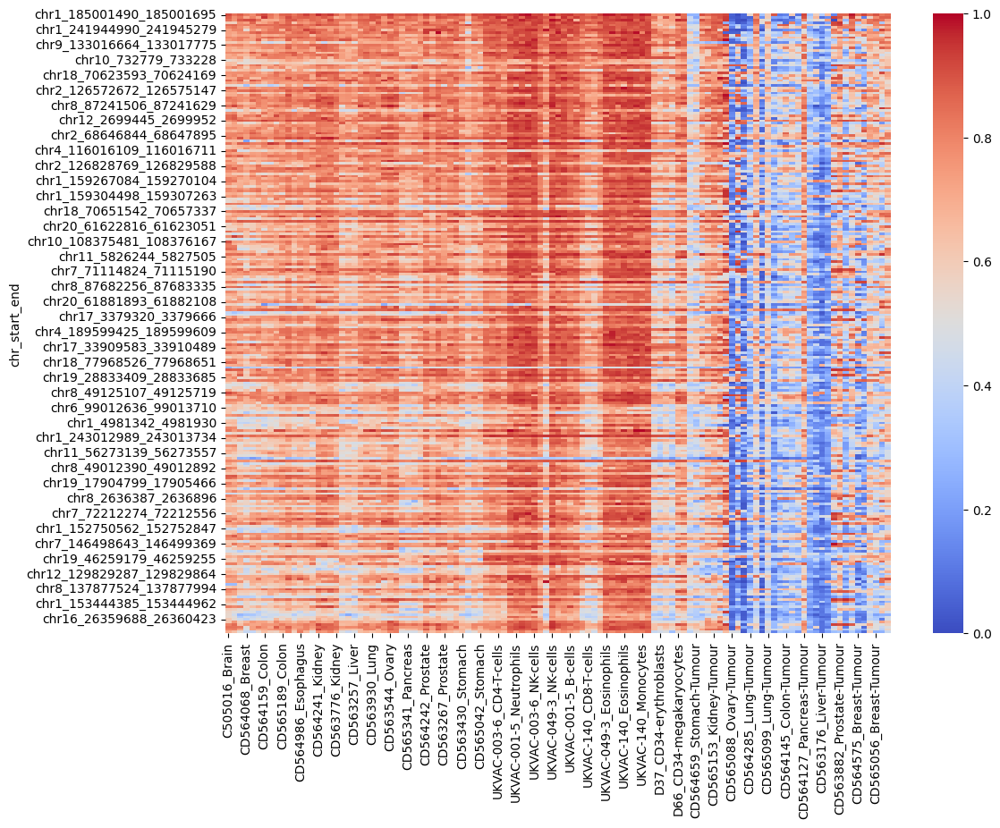

In [24]:
shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR']),:]
shared_dmb_df = shared_dmb_df.loc[(shared_dmb_df['Hyper_or_Hypo']=="Hypo"),:]

shared_dmb_df = shared_dmb_df[~shared_dmb_df.index.duplicated(keep='first')]

# shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR']) & (df['Hyper_or_Hypo']=="Hyper"),:]
plt.figure(figsize=(12, 9))
sns.heatmap(shared_dmb_df[[u for u in tissue_sample_order if u in shared_dmb_df.columns]],
#             annot=False, 
# #             mask=mask,
            cmap='coolwarm',
#             fmt='g',
#             linewidths=.5,
#            norm=LogNorm(),
           )

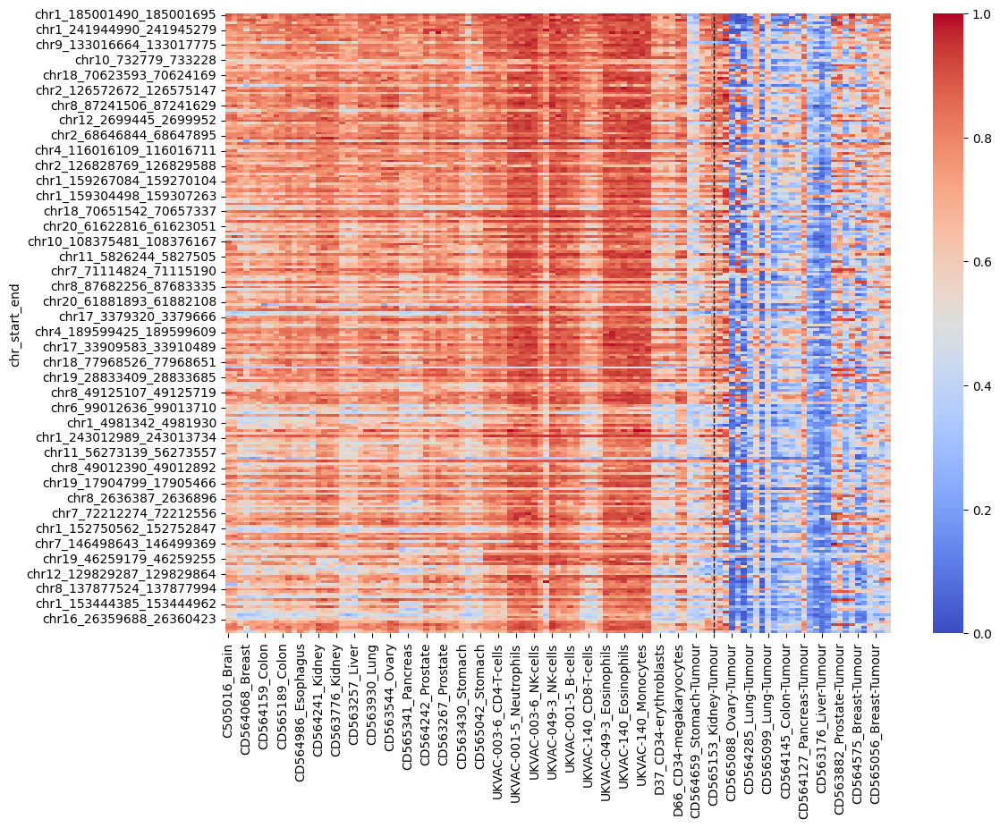

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df and dmr_shared_count are already defined
# Assuming tissue_sample_order is a list of sample names in the order you want them displayed

# Filter the DataFrame based on conditions
shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR']),:]
shared_dmb_df = shared_dmb_df.loc[(shared_dmb_df['Hyper_or_Hypo']=="Hypo"),:]

# Remove duplicates based on index
shared_dmb_df = shared_dmb_df[~shared_dmb_df.index.duplicated(keep='first')]

# Create the heatmap
plt.figure(figsize=(12, 9))
ax = sns.heatmap(shared_dmb_df[[u for u in tissue_sample_order if u in shared_dmb_df.columns]],
                 cmap='coolwarm')

# Find the index where the first tumor sample starts in the ordered list
# Replace 'first_tumor_sample' with the name of the first tumor sample in your list
first_tumor_sample_index = 81

# Add a vertical dashed line at the specified x-coordinate (index)
# Line style is dashed ('--'), color is black ('k'), and linewidth is 1
ax.axvline(x=first_tumor_sample_index + 0.5, linestyle='--', color='k', linewidth=1)

plt.show()


In [31]:
df

,CD564159_Colon,CD563663_Colon,CD563419_Colon,CD565189_Colon,CD564588_Stomach-Tumour,CD564659_Stomach-Tumour,CD564242_Prostate,CD563610_Prostate,CD563685_Prostate,CD563267_Prostate,...,tg_mean,bg_mean,delta_means,tg_quant,bg_quant,delta_quants,ttest,significant_dmrs,Hyper_or_Hypo,selected_tissue
chr_start_end,,,,,,,,,,,,,,,,,,,,,
chr1_185001490_185001695,0.913222,0.833556,0.772444,0.866222,0.266222,0.269222,0.928111,0.869111,0.902333,0.867889,...,0.267722,0.889732,0.622009,0.268472,0.753900,4.854278e-01,6.056053e-24,True,Hypo,Stomach-Tumour
chr12_132203632_132203760,0.838455,0.792727,0.821364,0.833727,0.194182,0.179545,0.857455,0.729091,0.890273,0.882182,...,0.186864,0.846877,0.660014,0.190523,0.639355,4.488318e-01,4.250413e-14,True,Hypo,Stomach-Tumour
chr15_53540208_53540998,0.828214,0.901500,0.937107,0.922679,0.280500,0.254071,0.725036,0.762036,0.781214,0.797857,...,0.267286,0.888112,0.620827,0.273893,0.701004,4.271107e-01,2.174129e-19,True,Hypo,Stomach-Tumour
chr18_46560416_46560536,0.832083,0.883167,0.806917,0.877500,0.253667,0.295750,0.903583,0.841917,0.896917,0.882917,...,0.274708,0.879266,0.604558,0.285229,0.709050,4.238208e-01,8.149720e-19,True,Hypo,Stomach-Tumour
chr13_52551671_52552765,0.862067,0.821133,0.817600,0.914133,0.396367,0.195033,0.813233,0.750933,0.886100,0.851900,...,0.295700,0.894996,0.599296,0.346033,0.763473,4.174400e-01,9.533866e-25,True,Hypo,Stomach-Tumour
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
chr2_195546180_195546654,0.955167,0.923750,0.915583,0.910833,0.906917,0.802667,0.882833,0.877750,0.876167,0.891167,...,0.776625,0.903234,0.126609,0.784146,0.784150,4.166667e-06,4.571231e-04,False,Hypo,Brain-Tumour
chr4_188909618_188910481,0.757500,0.721000,0.870750,0.844000,0.500750,0.564000,0.880750,0.749750,0.871500,0.865750,...,0.459500,0.777818,0.318318,0.480000,0.480000,5.551115e-17,3.243765e-04,False,Hypo,Brain-Tumour
chr1_47769061_47769353,0.602500,0.613250,0.596000,0.576750,0.523250,0.556500,0.455500,0.485500,0.529750,0.528250,...,0.267750,0.605646,0.337896,0.342375,0.342375,0.000000e+00,2.417607e-03,False,Hypo,Brain-Tumour


In [37]:
shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>0]['DMR']),:]


In [32]:
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming df and dmr_shared_count are already defined
# Assuming tissue_sample_order is a list of sample names in the order you want them displayed

# Filter the DataFrame based on conditions
shared_dmb_df = df.loc[(dmr_shared_count.loc[dmr_shared_count['Shared_Count']>0]['DMR']),:]
shared_dmb_df = shared_dmb_df.loc[(shared_dmb_df['Hyper_or_Hypo']=="Hyper"),:]

# Remove duplicates based on index
shared_dmb_df = shared_dmb_df[~shared_dmb_df.index.duplicated(keep='first')]

# Create the heatmap
plt.figure(figsize=(12, 9))
ax = sns.heatmap(shared_dmb_df[[u for u in tissue_sample_order if u in shared_dmb_df.columns]],
                 cmap='coolwarm')

# Find the index where the first tumor sample starts in the ordered list
# Replace 'first_tumor_sample' with the name of the first tumor sample in your list
first_tumor_sample_index = 81

# Add a vertical dashed line at the specified x-coordinate (index)
# Line style is dashed ('--'), color is black ('k'), and linewidth is 1
ax.axvline(x=first_tumor_sample_index + 0.5, linestyle='--', color='k', linewidth=1)

plt.show()


ValueError: zero-size array to reduction operation fmin which has no identity

<Figure size 1200x900 with 0 Axes>

<Axes: ylabel='chr_start_end'>

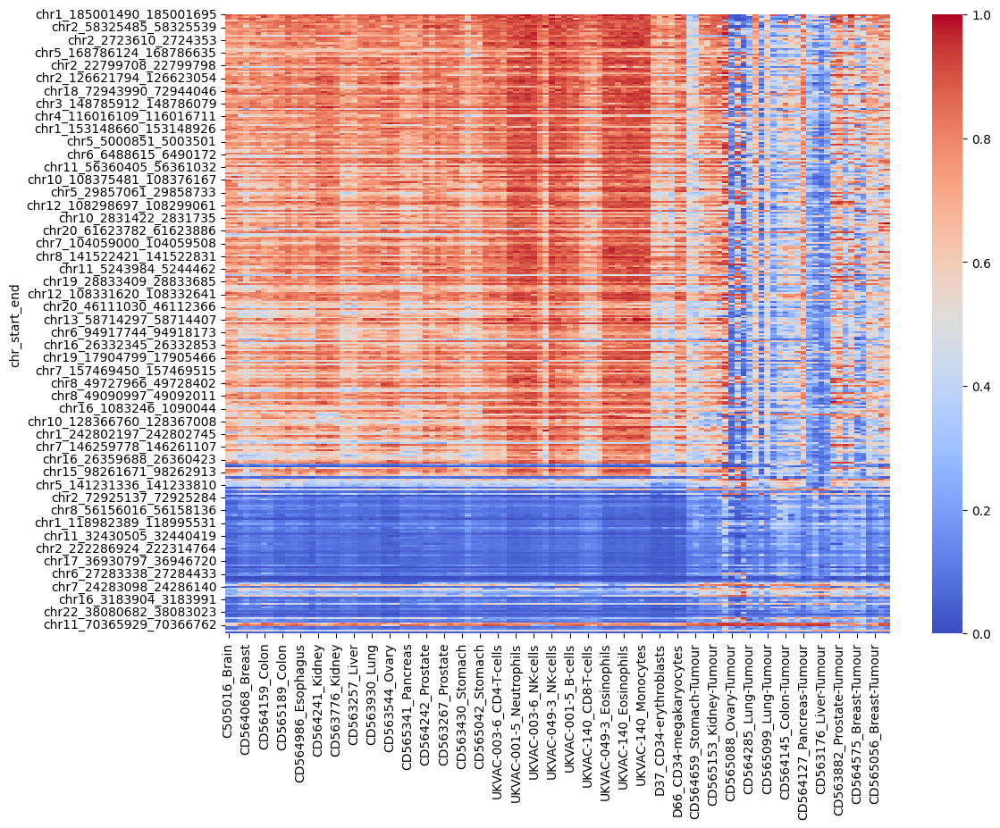

In [66]:

shared_dmb_df = df.loc[dmr_shared_count.loc[dmr_shared_count['Shared_Count']>5]['DMR'],:]
plt.figure(figsize=(12, 9))
sns.heatmap(shared_dmb_df[[u for u in tissue_sample_order if u in shared_dmb_df.columns]],
#             annot=False, 
# #             mask=mask,
            cmap='coolwarm',
#             fmt='g',
#             linewidths=.5,
#            norm=LogNorm(),
           )

In [ ]:
df.loc[]

In [45]:
def plot_region(cpg, df, toi, tissue_id_map, id_tissue_map, highlight_tissues=[]):
    """
    Plot the methylation ratios for a single CpG region across multiple tissue samples.
    
    Parameters:
        cpg (str): CpG region to plot
        df (DataFrame): DataFrame containing methylation ratios
        toi (str): Tissue of Interest
        tissue_id_map (dict): Dictionary mapping tissues to sample IDs
        id_tissue_map (dict): Dictionary mapping sample IDs to tissues
        highlight_tissues (list): List of tissues to highlight with 'X' marker
    """
    # Handle non-unique index by selecting the first entry
    selected_cpg = df.loc[cpg, :]
    if len(selected_cpg) > 1:
        selected_cpg = selected_cpg.iloc[0, :]
        
    # Generate unique colors for each tissue type
    unique_tissues = list(tissue_id_map.keys())
    cmap = plt.get_cmap('jet')
    colors = cmap(np.linspace(0, 1.0, len(unique_tissues)))
    tissue_colors = dict(zip(unique_tissues, colors))
    
    # Create the plot
    plt.figure(figsize=(20, 8))
    
    for sample_id, methylation_ratio in selected_cpg.iteritems():
        tissue = id_tissue_map.get(sample_id, 'Unknown')
        color = tissue_colors.get(tissue, 'grey')
        
        # Choose marker based on whether the tissue is in the highlight_tissues list
        marker = '*' if tissue in highlight_tissues else 'o'
        size = 150 if marker == '*' else 100
        linewidth = 1 if marker == '*' else None
        
        plt.scatter(sample_id, methylation_ratio, c=[color], marker=marker, s=size, linewidth=linewidth)
    
    # Add legends and labels
    handles = [plt.Line2D([0], [0], marker='o', color='w', label=tissue, markersize=10, markerfacecolor=color) for tissue, color in tissue_colors.items()]
    plt.legend(title='Tissues', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.xticks(rotation=90)
    plt.xlabel('Sample IDs')
    plt.ylabel('Methylation Ratio')
    plt.title(f'Methylation Ratios for CpG region {cpg}')
    plt.grid(True)
    
    plt.tight_layout(rect=[0, 0, 0.85, 1])
    plt.show()


### Cluster by all DMBs contained in at least one cancer type